# Run Analyses Using GEX Data

This script runs analyses on the Mouse dataset after filtering and clustering.

# Import Packages

In [2]:
import pandas as pd     # Used to deal with dataframes
import numpy as np      # Used for scientific computation
import os               # Used for file paths and file locations
import scanpy as sc     # Used for single-cell analysis
import anndata          # Used to create and work with anndata structures (related to scanpy)
import matplotlib.pyplot as plt    # Used for visualization
from mpl_toolkits.axes_grid1 import make_axes_locatable   # Used for visualization
import seaborn as sns   # Used for visualization
from seaborn import xkcd_palette as xkcd
import scipy
import statistics
import openpyxl     # To save data to Excel files
import matplotlib.patheffects as PathEffects
from collections import Counter
from palettable.cartocolors.sequential import PurpOr_7
import random
from statsmodels.stats.multitest import multipletests
from adjustText import adjust_text

# Set seed at the start of the program
np.random.seed(2)

# Define a color palette for clusters
color_palette = ['black','tan','green','purple','orange','red','magenta','blue','pink','gray','brown',
                 'yellow','lightblue','lightgreen','maroon','aqua','lime','yellow']

color_palette = xkcd(['black','tan','forest','purple','orange','red','magenta','blue','pink','grey','brown',
                 'yellow','lightblue','lightgreen','maroon','aqua','lime','yellow'])

sample_palette = sns.color_palette()[:5]

# Set the Current Working Directory

In [ ]:
%config Completer.use_jedi = False

os.chdir('mydirectory')
os.getcwd()

# Define Functions

In [4]:
# All functions are loaded from a file called 'Functions.py'
%run scripts/Functions.py
%run scripts/PathwayAnalyses.py

# Load Data

In [5]:
Adata = anndata.read_h5ad('data/ScanpyObjects/FilteredIntegratedFinalData.h5ad')

### Continue with Analysis

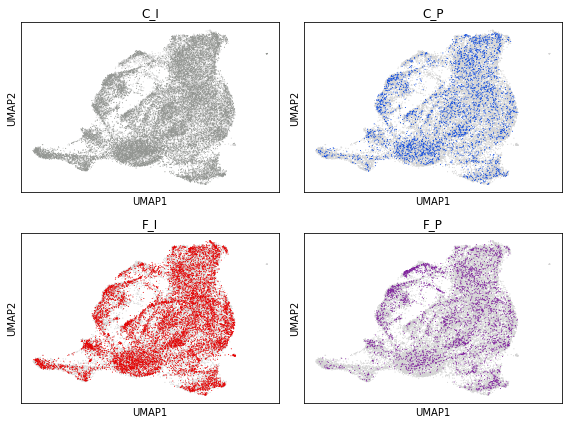

In [5]:
SplitPlot(Adata, groupby = 'combined', ncols = 2, palette = xkcd(['grey', 'blue', 'red', 'purple']),
          save_name = 'results/Plots/UMAPs/Mouse_UMAP_byCombinedGroups.pdf')

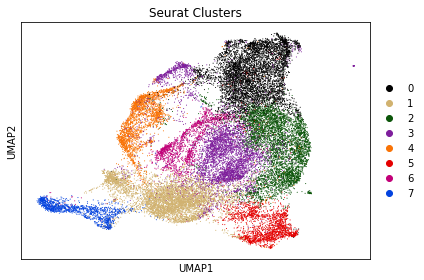

In [15]:
fig = sc.pl.umap(Adata, color = 'seurat_clusters', return_fig = True, palette = color_palette)
plt.title('Seurat Clusters')
plt.tight_layout()
plt.savefig('results/Plots/UMAPs/UMAP_Mouse_Clusters.pdf')
plt.show()

# Load Gene Lists

### DNA and Histone Methylation Gene Lists

In [7]:
DNAmeth = ['Dnmt1', 'Dnmt3a', 'Dnmt3b'] # missing Dnmt3c
MethionineCycle = ['Mtr', 'Mthfr', 'Mat2a', 'Ahcy']
HistoneMethH3R2 = ['Carm1', 'Prmt6']
HistoneMethH3K4 = ['Kmt2a', 'Kmt2b', 'Kmt2c', 'Kmt2d', 'Setd7'] # missing Symd3
HistoneMethH3K9 = ['Setdb1', 'Ehmt1', 'Ehmt2', 'Suv39h1', 'Suv39h2', 'Prdm2']
HistoneMethH3K27 = ['Ezh2']
HistoneMethH4K20 = ['Kmt5a', 'Kmt5b', 'Kmt5c']

gene_lists = [DNAmeth, MethionineCycle, HistoneMethH3R2, HistoneMethH3K4, HistoneMethH3K9, HistoneMethH3K27,
              HistoneMethH4K20]
gene_names = ['DNA Methyltransferases', 'Methionine Cycle', 'H3R2', 'H3K4', 'H3K9', 'H3K27', 'H4K20']

# All genes in dictionary format
HistoneMethGenes = {g_name:g_list for g_name,g_list in zip(gene_names,gene_lists)}

### Standard T-Cell Gene Lists

In [7]:
# Text files
sarkar_activation = LoadGeneSig('data/GeneLists/cd8_activation_sarkar_up.txt')
cellcycle = LoadGeneSig('data/GeneLists/cell_cycle_all_strong.txt')
kaech_naive = LoadGeneSig('data/GeneLists/KAECH_NAIVE_VS_DAY8_EFF_CD8_TCELL_UP.txt')

# Excel Files
IFN_1 = LoadGeneSig('data/GeneLists/20200617_IFNsignatures.xlsx', 'GO_RESPONSE_TO_TYPE_I_IFN')
IFN_2 = LoadGeneSig('data/GeneLists/20200617_IFNsignatures.xlsx', 'HALLMARKS_IFNa_RESPONSE')
effector_like = LoadGeneSig('data/GeneLists/Miller2019_NatureImmuno_SuppTable1.xlsx', 'Effector-like')
terminallyexh = LoadGeneSig('data/GeneLists/Miller2019_NatureImmuno_SuppTable1.xlsx', 'Terminally Exh.')
proliferating = LoadGeneSig('data/GeneLists/Miller2019_NatureImmuno_SuppTable1.xlsx', 'Proliferating')
progenitorexh = LoadGeneSig('data/GeneLists/Miller2019_NatureImmuno_SuppTable1.xlsx', 'Progenitor Exh.')
bystander = LoadGeneSig('data/GeneLists/20200718_Mognol_PNAS2017_bystanders.xlsx', 'P14 UP (bystander)')
TRM = LoadGeneSig('data/GeneLists/20200711_Beura_Trm_2017_Immunity.xlsx', 'Beura_FRT_TRM_UP')
inflammaging = LoadGeneSig('data/GeneLists/20210330_Inflammaging_signature.xlsx', 'Sheet1')

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\openpyxl\worksheet\_reader.py:300: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


In [8]:
Tcell_lists = [sarkar_activation, cellcycle, kaech_naive, IFN_1, IFN_2, effector_like, terminallyexh, proliferating,
               progenitorexh, bystander, TRM, inflammaging]
Tcell_names = ['Activation (Sarkar)', 'Cell Cycle', 'Naive (Kaech)', 'GO Response to Type I IFN',
               'Hallmarks IFNa Response', 'Effector-like (Miller)', 'Terminally Exh (Miller)',
               'Proliferating (Miller)', 'Progenitor Exh (Miller)', 'Bystander (Mognol 2017)', 'Beura FRT TRM']
Tcell_dict = {key:value for key,value in zip(Tcell_names, Tcell_lists)}

### Hallmark Gene Lists

In [6]:
# Hallmark gene lists
Apoptosis = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_APOPTOSIS.txt')
DNArepair = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_DNA_REPAIR.txt')
G2M = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_G2M_CHECKPOINT.txt')
Glycolysis = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_GLYCOLYSIS.txt')
Hypoxia = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_HYPOXIA.txt')
Inflamm = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_INFLAMMATORY_RESPONSE.txt')
IFNalpha = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_INTERFERON_ALPHA_RESPONSE.txt')
IFNgamma = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_INTERFERON_GAMMA_RESPONSE.txt')
Spindle = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_MITOTIC_SPINDLE.txt')
Oxidative = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_OXIDATIVE_PHOSPHORYLATION.txt')
PI3K = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_PI3K_AKT_MTOR_SIGNALING.txt')
ROS = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_REACTIVE_OXYGEN_SPECIES_PATHWAY.txt')
TGFbeta = LoadGeneSig('data/GeneLists/HallmarkGenes/HALLMARK_TGF_BETA_SIGNALING.txt')

# Special case
sigs = pd.read_excel('data/GeneLists/20210111_Signatures.xlsx', sheet_name = None, engine = 'openpyxl')
sigs = {col:sigs['Sheet1'][col].dropna().tolist() for col in sigs['Sheet1'].columns if col[:3] != 'Unn'}

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\openpyxl\worksheet\_reader.py:300: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


### Genes from Mango Project

In [139]:
Mango = pd.read_excel('../Mango/results/scRNA/PathwayAnalysis/DEgenes/UpregGenesPerLeidenCluster.xlsx',
                      engine = 'openpyxl', sheet_name = None)
Mango = {key:Mango[key]['Gene Names'].tolist() for key in Mango.keys()}

### Metabolism Gene Lists

In [8]:
# Define metabolism signatures
# Custom gene lists
SerineBios = ['Phgdh', 'Psat1', 'Psph']
SerineUpt = ['Slc1a5', 'Slc3a2']
Folate = ['Mthfd1', 'Shmt1', 'Shmt2', 'Mthfd1l', 'Mthfd2', 'Mthfd2l']
Purine = ['Mthfd1', 'Gart', 'Adsl', 'Atic']
Methio = ['Mtr', 'Mthfr', 'Mat2a', 'Ahcy']
Transful = ['Gclc', 'Gclm', 'Gls', 'Gss']
Methyl = ['Dnmt1', 'Kmt2a', 'Dot1l']
MethionineCycle = ['Mtr', 'Mthfr', 'Mat2a', 'Ahcy']

gene_lists = [SerineBios, SerineUpt, Folate, Purine, Methio, Transful, Methyl]
gene_names = ['Serine Biosynthesis', 'Serine Uptake', 'Folate Cycle', 'Purine Synthesis',
              'Methionine Cycle', 'Transfuluration', 'DNA Methyltransferases']

# All genes in dictionary format
metabolism = {g_name:g_list for g_name,g_list in zip(gene_names,gene_lists)}

# All genes in list format
AllMetabGenes = []
for key in metabolism.keys():
    AllMetabGenes.extend(metabolism[key])
    
del gene_lists, gene_names

### 1-Carbon Signature

In [9]:
OneCarbonsig = SerineBios + Folate + Purine + MethionineCycle + Transful

Adata = CalculateGeneScores(Adata, gene_lists = OneCarbonsig, gene_lists_names = '1-Carbon Signature')

### KEGG Signatures

In [10]:
# Kegg signatures
import glob
kegg_names = []
kegg_lists = []

for i,sig in enumerate(glob.glob('data/GeneLists/KeggGenes/KEGG*')):
    kegg_lists.append(LoadGeneSig(sig))
    kegg_names.append(sig.split('\\')[1][:-4])
    
kegg_dict = {g_name:g_list for g_name,g_list in zip(kegg_names,kegg_lists)}

### KEGG 61 Gene Signatures

In [11]:
# Kegg signatures
import glob
kegg61_names = []
kegg61_lists = []

for i,sig in enumerate(glob.glob('data/GeneLists/KeggGenes/61Lists/KEGG*')):
    kegg61_lists.append(LoadGeneSig(sig))
    kegg61_names.append(sig.split('\\')[1][:-4])
    
kegg61_dict = {g_name:g_list for g_name,g_list in zip(kegg61_names,kegg61_lists)}

# Stacked Bar Plots per Sample

In [51]:
def PrintNumberOfCells():
    """
    Make an Excel file that prints out the total number of cells per cluster and combined group.
    """
    
    # Make a table
    df = pd.crosstab(Adata.obs['combined'], Adata.obs['seurat_clusters'])
    
    # Turn the columns and indices into string values instead of categorical ones
    df.columns = [str(x) for x in range(6)]
    df.index = [str(x) for x in list(df.index)]
    
    # Add the total number of cells for each row and column
    df['Total'] = df.sum(axis = 1)
    df.loc['Total'] = df.sum(axis = 0)
    
    # Save the file
    df.to_excel('results/NumberOfCells.xlsx', engine = 'openpyxl')
    return

PrintNumberOfCells()

In [93]:
def BinomTwoProportions(Adata, cluster, group1, group2):
    """
    This function compares the proportions of two Binomial populations.
    
    Adata: The Adata object.
    cluster (int): Subsets the data to use only this cluster.
    group1 (str): The first group to use.
    group2 (str): The second group to use.
    """
    
    # Make a contingency table
    df = pd.crosstab(Adata.obs['combined'], Adata.obs['seurat_clusters'])
    
    # Find the number of cells in group 1 and group 2 that belong to the given cluster
    x1 = df.loc[group1, cluster]
    x2 = df.loc[group2, cluster]
    
    # Find total number of cells in group 1 and group 2
    N1 = df.sum(axis=1)[group1]
    N2 = df.sum(axis=1)[group2]
    
    # Calculate proportions (number of cells of group 1 in the cluster divided by all the cells of group 1)
    p1 = x1 / N1
    p2 = x2 / N2
    
    # Calculate pooled proportion
    p_hat = (x1+x2)/(N1+N2)
    
    # Calculate Z-score
    Z = (p1 - p2)/np.sqrt(p_hat * (1-p_hat) * (1/N1 + 1/N2))
    
    # Calculate two-sided p-value
    p_val = scipy.stats.norm.sf(abs(Z))*2
    
    return p_val

In [101]:
df = pd.DataFrame(index = range(8), columns = ['CI vs FI', 'CP vs FP'], data = 0)

for cluster in df.index:
    
    df.loc[cluster, 'CI vs FI'] = BinomTwoProportions(Adata, cluster, 'C_I', 'F_I')
    df.loc[cluster, 'CP vs FP'] = BinomTwoProportions(Adata, cluster, 'C_P', 'F_P')
    
df.to_excel('results/Plots/BarPlots/Pvals_Combined_byCluster.xlsx')
df

,CI vs FI,CP vs FP
0,7.160761e-01,8.432803e-01
1,7.394734e-03,4.884867e-09
2,3.331200e-07,5.694275e-02
3,7.290171e-02,1.341775e-06
4,2.494312e-03,1.018745e-02
5,7.537689e-01,7.556340e-01
6,7.053065e-05,2.941561e-03
7,3.571993e-12,5.208190e-05


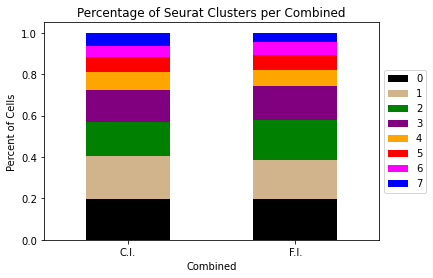

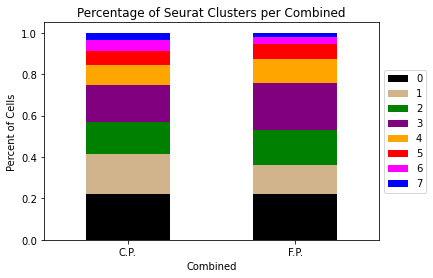

In [104]:
StackedBarPlot(Adata[Adata.obs['combined'].isin(['C_I', 'F_I'])], xaxis = 'combined', yaxis = 'seurat_clusters',
               orientation = 'vertical', order = ['C_I', 'F_I'],
               save_name = 'results/Plots/BarPlots/StackedBar_Isotype_byCluster.pdf')

StackedBarPlot(Adata[Adata.obs['combined'].isin(['C_P', 'F_P'])], xaxis = 'combined', yaxis = 'seurat_clusters',
               orientation = 'vertical', order = ['C_P', 'F_P'],
               save_name = 'results/Plots/BarPlots/StackedBar_AntiPD1_byCluster.pdf')

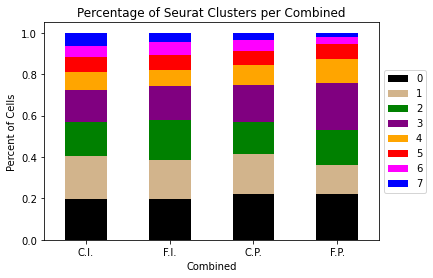

In [106]:
StackedBarPlot(Adata, xaxis = 'combined', yaxis = 'seurat_clusters', orientation = 'vertical',
               order = ['C_I', 'F_I', 'C_P', 'F_P'],
               save_name = 'results/Plots/BarPlots/StackedBar_Combined_byCluster.pdf')

In [65]:
df = pd.crosstab(Adata.obs['seurat_clusters'], Adata.obs['sample'])
df = df.div(df.sum(axis=1), axis=0)
df.columns = df.columns.add_categories('Total')
df['Total'] = df.sum(axis=1)
df.to_excel('results/PercentOfCells_byReplicate.xlsx', engine = 'openpyxl')

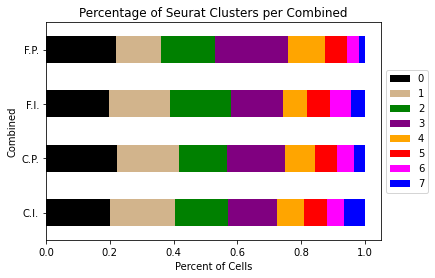

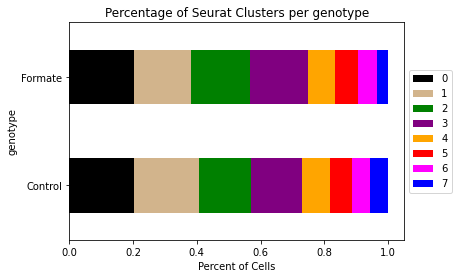

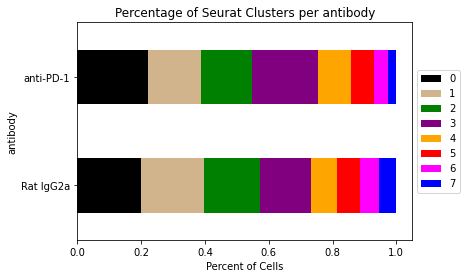

In [107]:
StackedBarPlot(Adata, yaxis = 'combined', save_name = 'results/Plots/BarPlots/StackedBar_Combined_byCluster.pdf')
StackedBarPlot(Adata, yaxis = 'genotype', save_name = 'results/Plots/BarPlots/StackedBar_Genotype_byCluster.pdf')

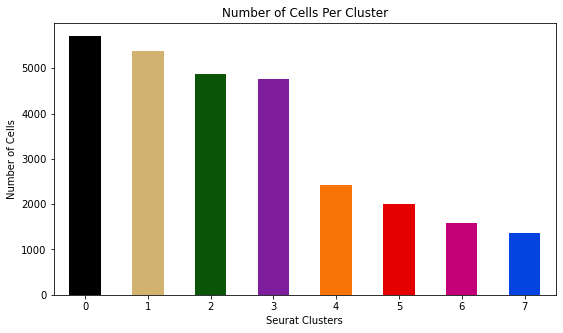

In [108]:
fig, ax = MakeFigAxes(1,1, (9,5), single = True)
Adata.obs['seurat_clusters'].value_counts().plot(kind = 'bar', color = color_palette, ax = ax)
ax.set_title('Number of Cells Per Cluster')
ax.set_xlabel('Seurat Clusters')
ax.set_ylabel('Number of Cells')
ax.set_xticklabels(ax.get_xticklabels(), rotation = 0)
plt.savefig('results/Plots/BarPlots/BarPlot_NumberCellsPerCluster.pdf')
plt.show()

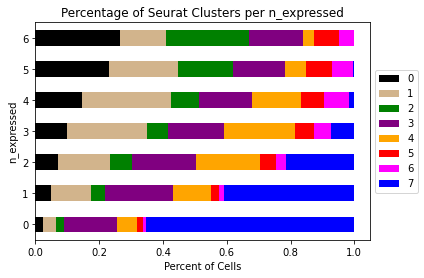

In [109]:
IRs = ['Pdcd1', 'Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4']
Adata.obs['n_expressed'] = np.count_nonzero(Adata[:, IRs].X, axis=1)

Adata.obs['n_expressed'] = Adata.obs['n_expressed'].astype(str)

StackedBarPlot(Adata, yaxis = 'n_expressed',
               save_name = 'results/Plots/BarPlots/StackedBar_IRs_byCluster.pdf')

# Scatterplot of Clusters across Conditions

In [99]:
def DotPlot(Adata_, gene_lists = None, gene_lists_names = None, gene_dict = None, groupby = 'combined', title = None,
            save_name = None):
    """
    Given a set of gene lists and corresponding names, make a dot plot, where each sample is
    given a score.
    """
    
    # Suppress warning
    pd.options.mode.chained_assignment = None
    
    # Copy the Adata object, as to not change the global object
    Adata = Adata_.copy()
    
    # Generate a title
    if title is None:
        title = 'Average Score for Gene Signatures by {}'.format(Formalize(groupby))
    
    # Check the gene lists
    gene_lists, gene_lists_names = CheckGeneLists(gene_lists = gene_lists, gene_lists_names = gene_lists_names,
                                                  gene_dict = gene_dict)
    
    # Calculate the gene scores for each gene list
    Adata = CalculateGeneScores(Adata, gene_lists = gene_lists, gene_lists_names = gene_lists_names,
                                copy = False)
    
    print('Calculated scores...')
    
    # Make a heatmap
    # Get the cell scores for each gene list as a dataframe, and add the grouping 
    df = Adata.obs[gene_lists_names]
    df.loc[:, groupby] = Adata.obs[groupby]
    
    # Find the average score for gene list for each group, and then the Z-score for visualization
    df = df.groupby(groupby).mean().T
    df = pd.DataFrame(index = df.index, columns = df.columns, data = scipy.stats.zscore(df, axis=1))
    
    # Count number of groups and gene lists
    ngenes = df.shape[0]
    nsamples = df.shape[1]

    # Make x- and y-coordinates for a scatterplot
    x_coordinates = list(np.array([[i]*ngenes for i in range(nsamples)]).flatten())
    y_coordinates = list(range(1, ngenes+1)) * nsamples
    
    # Make an empty matrix called 'Mtx' for plotting and fill it in
    Mtx = pd.DataFrame(columns = ['x', 'y', 'Score', groupby, 'Gene List'])

    Mtx['Score'] = df.melt()['value']
    Mtx['x'] = x_coordinates
    Mtx['y'] = y_coordinates
    Mtx[groupby] = df.melt()[groupby]
    Mtx['Gene List'] = list(df.index) * nsamples
    
    # Make the plot
    ax = sns.scatterplot(data = Mtx, x = 'x', y = 'y', hue = 'Score', size = 'Score',
                         palette = 'RdBu_r')

    handles, labels = ax.get_legend_handles_labels()
    lgd = ax.legend(handles, labels, loc = 'center left', bbox_to_anchor=(1, 0.5))


    plt.xlabel(Formalize(groupby))
    plt.ylabel('Gene Signature')
    plt.xticks([i for i in range(nsamples)], df.columns)
    plt.yticks([i for i in range(1, ngenes+1)], gene_lists_names)
    plt.title(title)
    
    # Save
    if save_name is not None:
        plt.savefig(save_name, bbox_extra_artists = (lgd,), bbox_inches = 'tight')
        
    plt.show()
    return

Calculated scores...


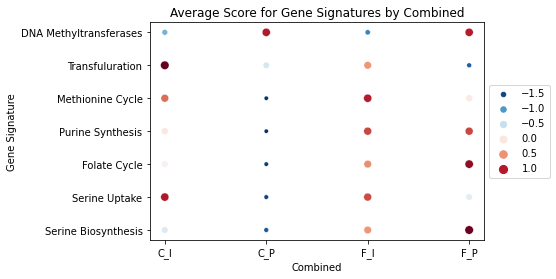

Calculated scores...


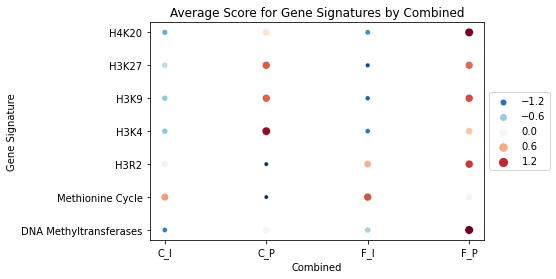

Calculated scores...


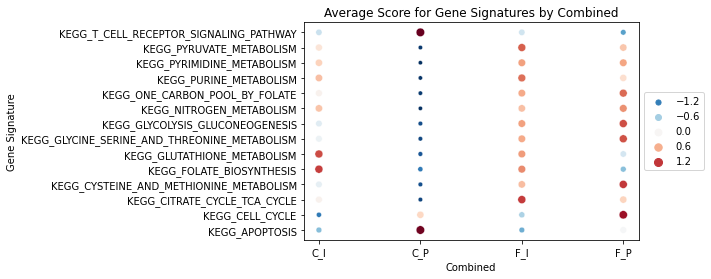

In [101]:
DotPlot(Adata, gene_dict = metabolism, save_name = 'results/Plots/DotPlots/Dots_Metabolism_byCombined.pdf')
DotPlot(Adata, gene_dict = HistoneMethGenes, save_name = 'results/Plots/DotPlots/Dots_HistMeth_byCombined.pdf')
DotPlot(Adata, gene_lists = kegg_lists, gene_lists_names = kegg_names,
        save_name = 'results/Plots/DotPlots/Dots_Kegg_byCombined.pdf')

In [43]:
def CloneSizeHeatmap(Adata_, gene_lists = None, gene_lists_names = None, gene_dict = None,
                           groupby = 'combined', title = None, N = 10, save_name = None):
    """
    HeatmapSharingPerClone displays the amount of TCR sharing on an individual clone basis across
    the 'groupby' variable.
    """
    
    # Suppress warning
    pd.options.mode.chained_assignment = None
    
    # Keep only AB clones
    Adata = KeepABcells(Adata_).copy()
    
    # Keep top N clones for visualization
    CloneSizesToKeep = Adata.obs['CloneSize'].sort_values(ascending = False).unique()[:N]
    Adata = Adata[Adata.obs['CloneSize'].isin(CloneSizesToKeep)].copy()
    
    # Generate a title
    if title is None:
        title = 'Average Score for Gene Signatures by Clone Size (Z-Scores)'
    
    # Check the gene lists
    gene_lists, gene_lists_names = CheckGeneLists(gene_lists = gene_lists, gene_lists_names = gene_lists_names,
                                                  gene_dict = gene_dict)
    
    # Calculate the gene scores for each gene list
    Adata = CalculateGeneScores(Adata, gene_lists = gene_lists, gene_lists_names = gene_lists_names,
                                copy = False)
    
    # Re-count clone sizes
    Adata.obs['CloneSize'] = Adata.obs.groupby('TCR')['TCR'].transform('count')
    
    # Edit TCR labels
    Adata.obs.loc[:, 'TCR'] = Adata.obs['TCR'].astype(str) + '_' + Adata.obs['CloneSize'].astype(str)
    
    # Make a dataframe that groups the score for each sample
    df = Adata.obs[gene_lists_names + ['TCR', 'CloneSize']].copy()
    df = df.groupby('TCR').mean().sort_values(by = 'CloneSize', ascending = False)
    
    # Drop the 'CloneSize' column
    df = df.drop(columns = 'CloneSize')
    
    return df

df = CloneSizeHeatmap(Adata, groupby = 'combined', N = 20, gene_dict = metabolism)

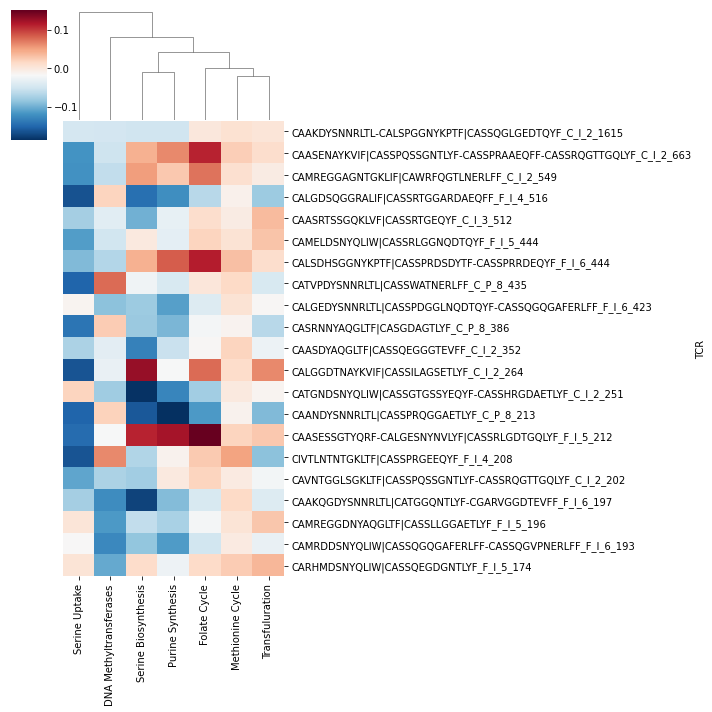

In [54]:
sns.clustermap(df, cmap = 'RdBu_r', row_cluster = False)
#ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, )
#plt.show()

# Waterfall Plots

In [13]:
#Adata = CalculateGeneScores(Adata, gene_lists = kegg_lists, gene_lists_names = kegg_names)
Adata = CalculateGeneScores(Adata, gene_dict = kegg61_dict)

In [14]:
def WaterfallPlots(cond1, cond2, save_name = None, gene_lists_names = kegg_names, keep_non_sig = True,
                   figsize = None):
    """
    Given two conditions (cond1 and cond2), this makes a bar plot that compares the two groups for all the Kegg
    pathways.
    
    keep_non_sig (bool): Whether or not to keep the non-significant pathways in the analysis.
    """
    
    # Make sure the conditions are in the Adata object
    assert cond1 in Adata.obs['combined'].unique(), 'Condition 1 ({}) is not in the Adata object.'.format(cond1)
    assert cond2 in Adata.obs['combined'].unique(), 'Condition 2 ({}) is not in the Adata object.'.format(cond2)
    
    # Keep only the two conditions
    df1 = Adata.obs[Adata.obs['combined'] == cond1].copy()
    df2 = Adata.obs[Adata.obs['combined'] == cond2].copy()
    
    # Initialize a dataframe to store the results
    df = pd.DataFrame(index = gene_lists_names, columns = ['pval', 'qval', '-log10(qval)', 'Higher in', 'color'],
                      data = 0)
    
    # Loop over each gene list
    for gene_list_name in gene_lists_names:
        
        # Calculate the p-value for the comparison
        stat, pval, diff_mean, diff_median = TwoWayStats(Adata.obs, groupby = 'combined', col = gene_list_name,
                                                         groups = [cond1, cond2])
        
        # Add the p-value to the results
        df.loc[gene_list_name, 'pval'] = pval
        
        # Add the 'Higher in' column
        if diff_mean > 0:
            df.loc[gene_list_name, 'Higher in'] = cond1
        else:
            df.loc[gene_list_name, 'Higher in'] = cond2
        
    # Adjust for multiple hypothesis testing
    _, qvals, _, _ = multipletests(df['pval'], method = 'fdr_bh')    
    
    # Take the -log10(pval)
    df['-log10(qval)'] = -np.log10(qvals)
    
    # Add to results
    df['qval'] = qvals
    
    # Keep only significant results (qval < 0.05)
    if keep_non_sig == False:
        df = df[df['qval'] < 0.05]
    
    # For the second condition, multiply -log10(qval) by -1
    df.loc[df['Higher in'] == cond2, '-log10(qval)'] = -1 * df.loc[df['Higher in'] == cond2, '-log10(qval)']
    
    # Sort the results
    df = df.sort_values(by = '-log10(qval)')
    
    if cond1 == 'F_I':
        color1 = 'scarlet'
    if cond2 == 'F_I':
        color2 = 'scarlet'

    if cond1 == 'F_P':
        color1 = 'barney purple'
    if cond2 == 'F_P':
        color2 = 'barney purple'

    if cond1 == 'C_I':
        color1 = 'grey'
    if cond2 == 'C_I':
        color2 = 'grey'

    if cond1 == 'C_P':
        color1 = 'cobalt blue'
    if cond2 == 'C_P':
        color2 = 'cobalt blue'
    
    # Create colors for a bar plot
    # First, rename colors
    color1 = 'xkcd:{}'.format(color1)
    color2 = 'xkcd:{}'.format(color2)
    
    df.loc[df['Higher in'] == cond1, 'color'] = color1
    df.loc[df['Higher in'] == cond2, 'color'] = color2
    df.loc[df['qval'] > 0.05, 'color'] = 'xkcd:white'
    
    colors = ['{}'.format(color2)] * len(df[df['-log10(qval)'] < 0]) + \
             ['{}'.format(color1)] * len(df[df['-log10(qval)'] > 0])

    # Make the plot
    if figsize is None:
        ax = df.plot(kind = 'barh', y = '-log10(qval)', color = df['color'], edgecolor = 'xkcd:black')
    else:
        ax = df.plot(kind = 'barh', y = '-log10(qval)', color = df['color'], edgecolor = 'xkcd:black', figsize = figsize)
    
    # Change the names of the conditions for plotting
    cond1 = cond1.replace('_', '.') + '.'
    cond2 = cond2.replace('_', '.') + '.'
    
    # Set the title and labels
    ax.set_title('{} vs. {}'.format(cond2, cond1))
    ax.set_ylabel('KEGG Pathways')
    
    xlabel = '-Log$_{10}$(q-value)' + ', {}\n'.format(cond1)
    xlabel += 'Log$_{10}$(q-value)' + ', {}'.format(cond2)
    ax.set_xlabel(xlabel)
    
    # Create a legend
    if keep_non_sig == True:
        labels = [cond1, 'NS', cond2]
        handles = [plt.Rectangle((0,0),1,1, facecolor = color1, edgecolor = 'xkcd:black'),
                   plt.Rectangle((0,0),1,1, facecolor = 'white', edgecolor = 'xkcd:black'),
                   plt.Rectangle((0,0),1,1, facecolor = color2, edgecolor = 'xkcd:black')]
        
    else:
        labels = [cond1, cond2]
        handles = [plt.Rectangle((0,0),1,1, facecolor = color1, edgecolor = 'xkcd:black'),
                   plt.Rectangle((0,0),1,1, facecolor = color2, edgecolor = 'xkcd:black')]
        
    ax.legend(handles, labels)
    
    # Save plot
    if save_name is not None:
        plt.savefig(save_name, bbox_inches = 'tight')
    plt.show()
    return

### 61 KEGG Gene Lists

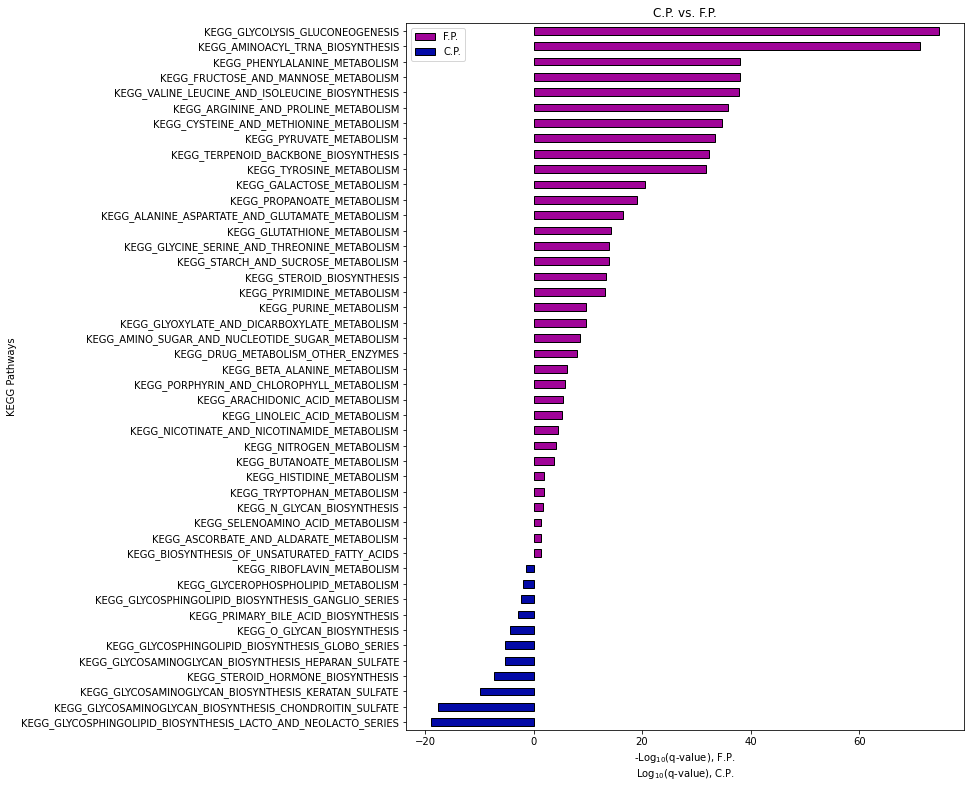

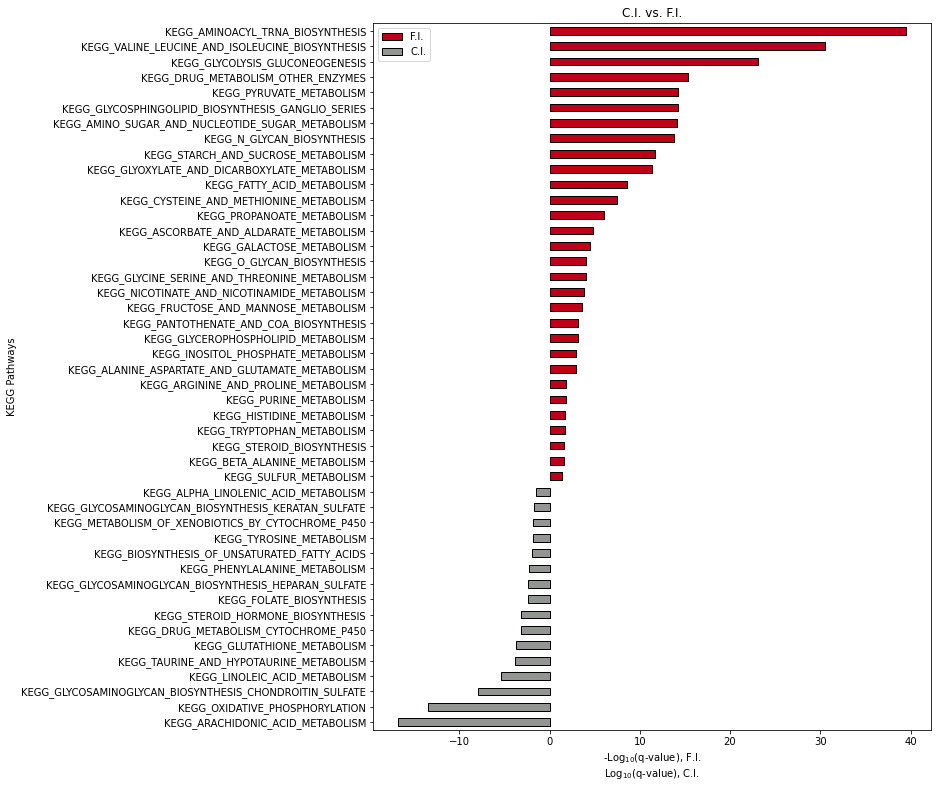

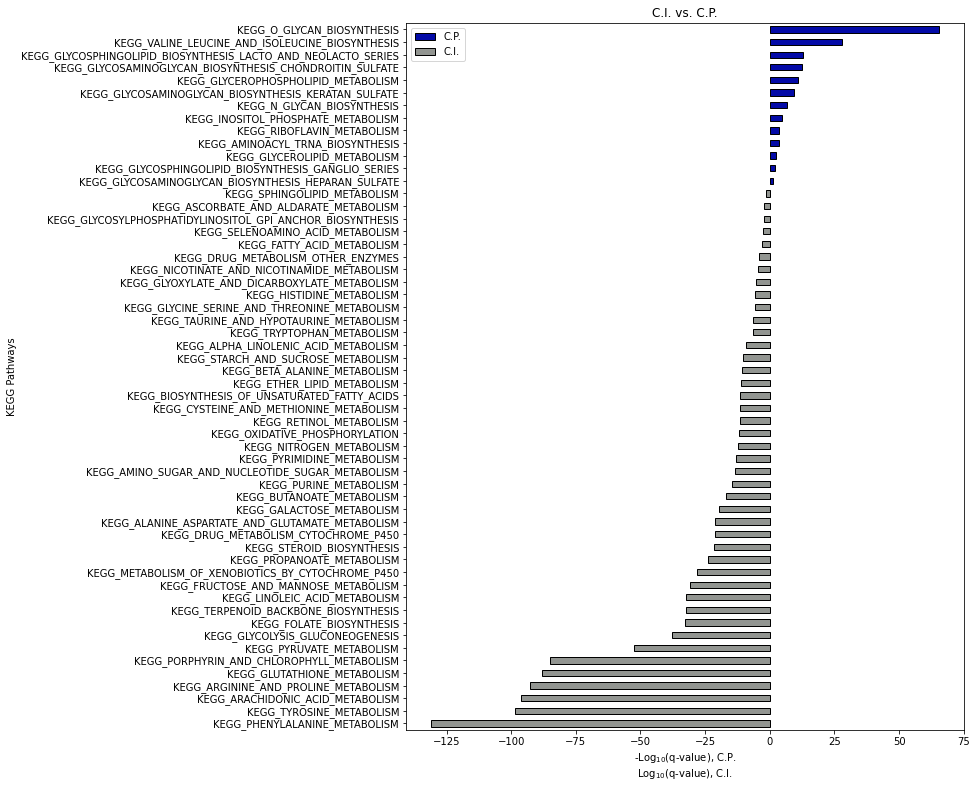

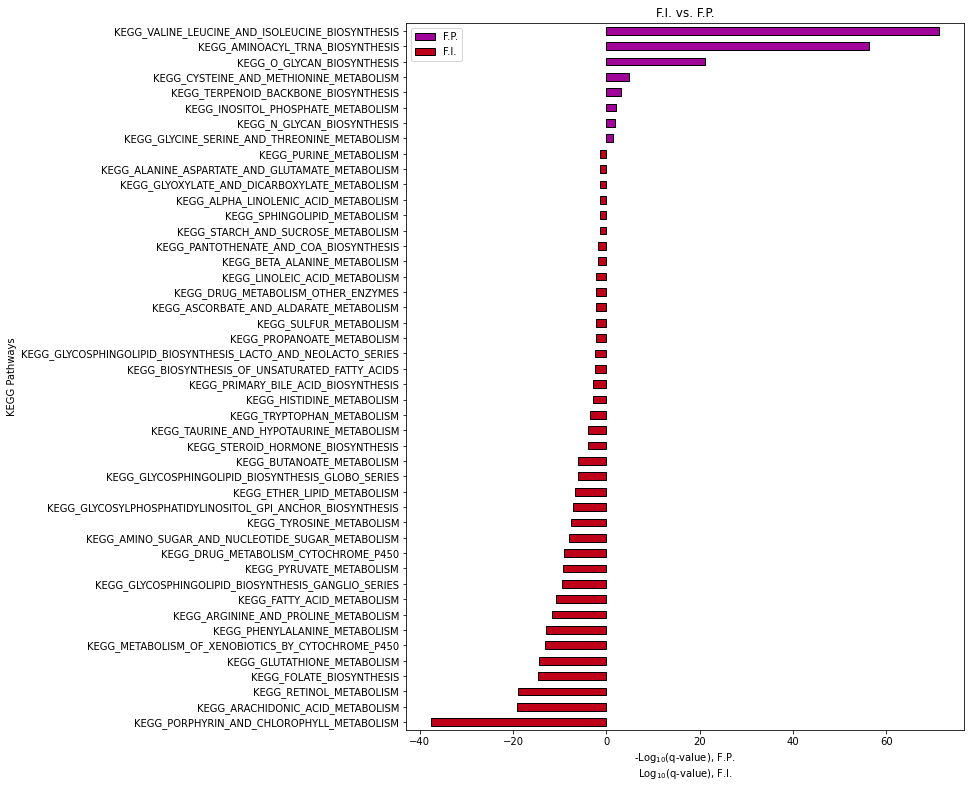

In [17]:
WaterfallPlots('F_P', 'C_P', keep_non_sig = False, gene_lists_names = kegg61_names, figsize = (10,13),
               save_name = 'results/Plots/WaterfallPlots/CP_vs_FP.pdf')
WaterfallPlots('F_I', 'C_I', keep_non_sig = False, gene_lists_names = kegg61_names, figsize = (10,13),
               save_name = 'results/Plots/WaterfallPlots/CI_vs_FI.pdf')
WaterfallPlots('C_P', 'C_I', keep_non_sig = False, gene_lists_names = kegg61_names, figsize = (10,13),
               save_name = 'results/Plots/WaterfallPlots/CI_vs_CP.pdf')
WaterfallPlots('F_P', 'F_I', keep_non_sig = False, gene_lists_names = kegg61_names, figsize = (10,13),
               save_name = 'results/Plots/WaterfallPlots/FI_vs_FP.pdf')

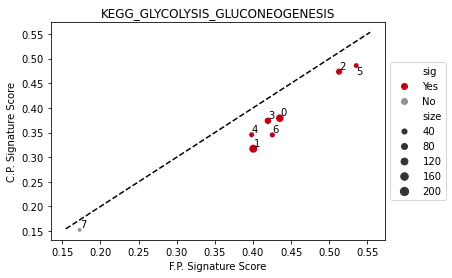

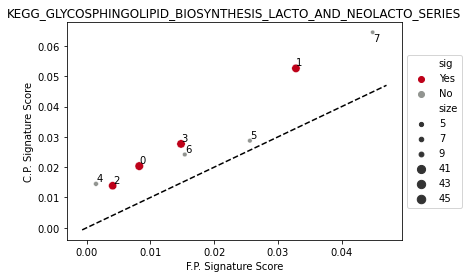

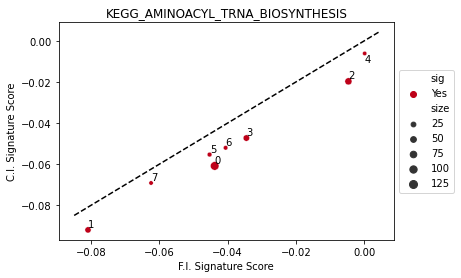

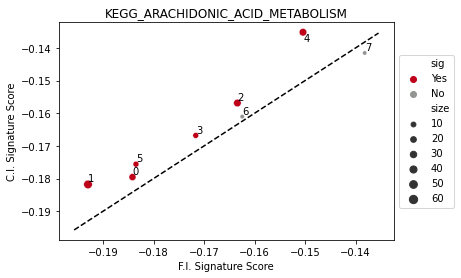

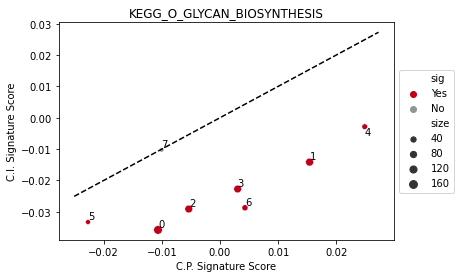

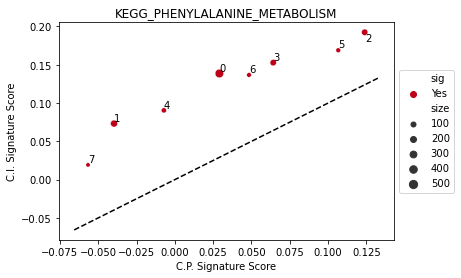

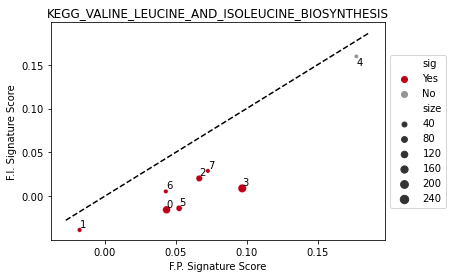

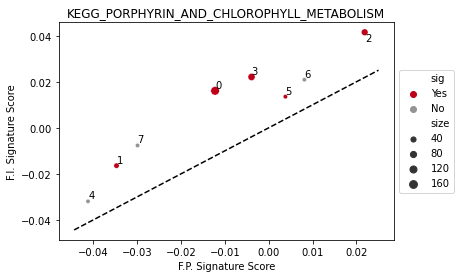

In [18]:
# For each comparison, use the top 2 most significant gene pathways for the next plot
CompareTwoConditions(Adata, 'F_P', 'C_P', 'KEGG_GLYCOLYSIS_GLUCONEOGENESIS',
                     save_name = 'results/Plots/DotPlots/CP_vs_FP_HigherInFP.pdf')
CompareTwoConditions(Adata, 'F_P', 'C_P', 'KEGG_GLYCOSPHINGOLIPID_BIOSYNTHESIS_LACTO_AND_NEOLACTO_SERIES',
                     save_name = 'results/Plots/DotPlots/CP_vs_FP_HigherInCP.pdf')

CompareTwoConditions(Adata, 'F_I', 'C_I', 'KEGG_AMINOACYL_TRNA_BIOSYNTHESIS',
                     save_name = 'results/Plots/DotPlots/CI_vs_FI_HigherInFI.pdf')
CompareTwoConditions(Adata, 'F_I', 'C_I', 'KEGG_ARACHIDONIC_ACID_METABOLISM',
                     save_name = 'results/Plots/DotPlots/CI_vs_FI_HigherInCI.pdf')

CompareTwoConditions(Adata, 'C_P', 'C_I', 'KEGG_O_GLYCAN_BIOSYNTHESIS',
                     save_name = 'results/Plots/DotPlots/CI_vs_CP_HigherInCP.pdf')
CompareTwoConditions(Adata, 'C_P', 'C_I', 'KEGG_PHENYLALANINE_METABOLISM',
                     save_name = 'results/Plots/DotPlots/CI_vs_CP_HigherInCI.pdf')

CompareTwoConditions(Adata, 'F_P', 'F_I', 'KEGG_VALINE_LEUCINE_AND_ISOLEUCINE_BIOSYNTHESIS',
                     save_name = 'results/Plots/DotPlots/FI_vs_FP_HigherInFP.pdf')
CompareTwoConditions(Adata, 'F_P', 'F_I', 'KEGG_PORPHYRIN_AND_CHLOROPHYLL_METABOLISM',
                     save_name = 'results/Plots/DotPlots/FI_vs_FP_HigherInFI.pdf')

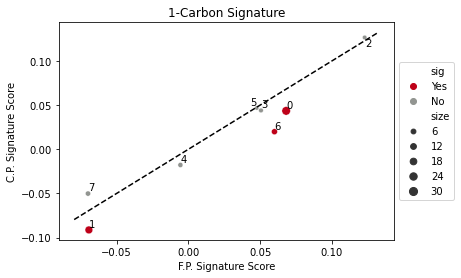

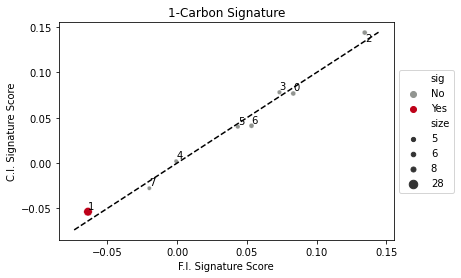

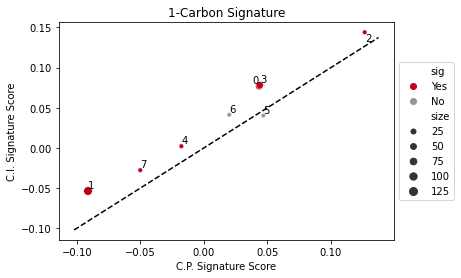

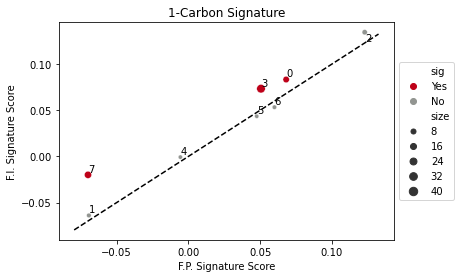

In [21]:
# For each comparison, use the 1-Carbon signature
CompareTwoConditions(Adata, 'F_P', 'C_P', '1-Carbon Signature',
                     save_name = 'results/Plots/DotPlots/CP_vs_FP_1Carbon.pdf')

CompareTwoConditions(Adata, 'F_I', 'C_I', '1-Carbon Signature',
                     save_name = 'results/Plots/DotPlots/CI_vs_FI_1Carbon.pdf')

CompareTwoConditions(Adata, 'C_P', 'C_I', '1-Carbon Signature',
                     save_name = 'results/Plots/DotPlots/CI_vs_CP_1Carbon.pdf')

CompareTwoConditions(Adata, 'F_P', 'F_I', '1-Carbon Signature',
                     save_name = 'results/Plots/DotPlots/FI_vs_FP_1Carbon.pdf')

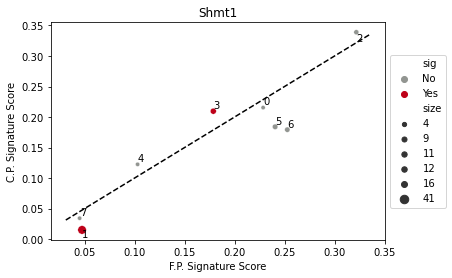

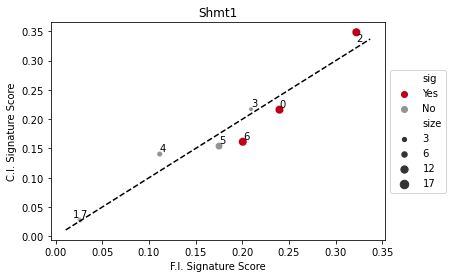

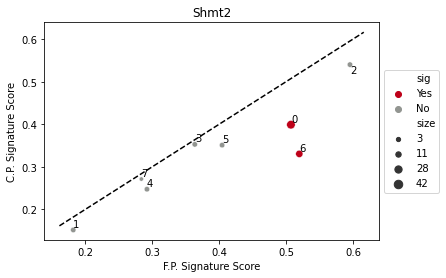

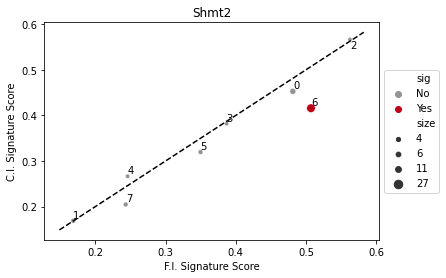

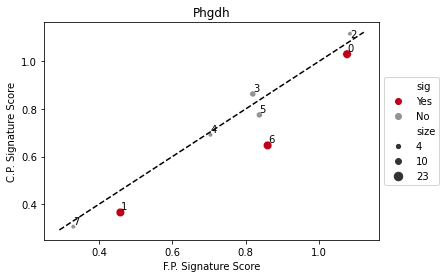

...

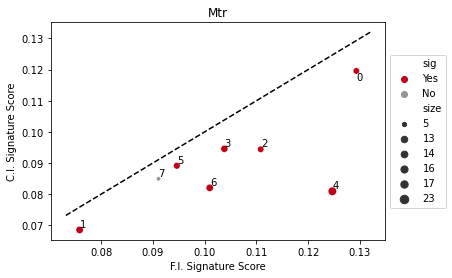

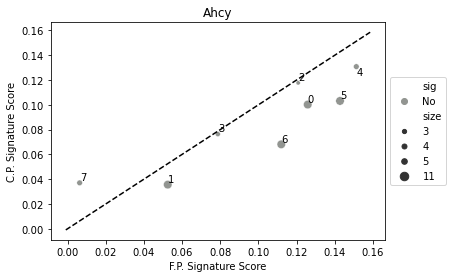

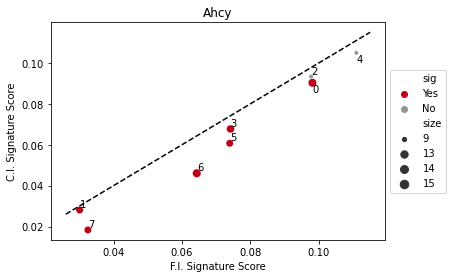

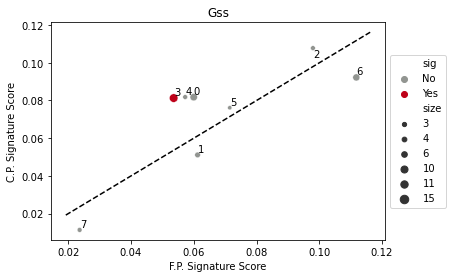

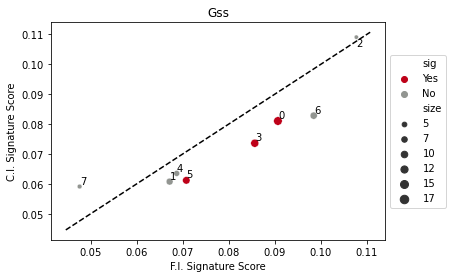

In [22]:
# Do the scatter + dot plot for certain genes
for gene in ['Shmt1', 'Shmt2', 'Phgdh', 'Gart', 'Mtr', 'Ahcy', 'Gss']:
    
    CompareTwoConditions(Adata, 'F_P', 'C_P', gene,
                         save_name = 'results/Plots/DotPlots/Genes/CP_vs_FP_{}.pdf'.format(gene))
    CompareTwoConditions(Adata, 'F_I', 'C_I', gene,
                         save_name = 'results/Plots/DotPlots/Genes/CI_vs_FI_{}.pdf'.format(gene))

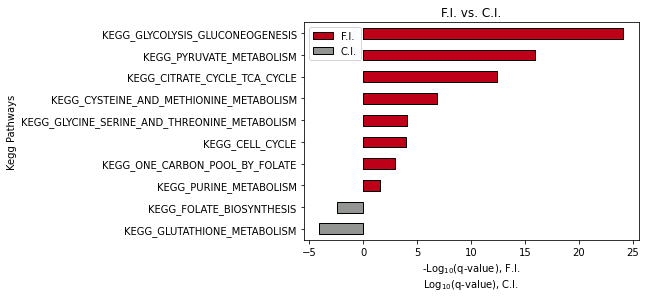

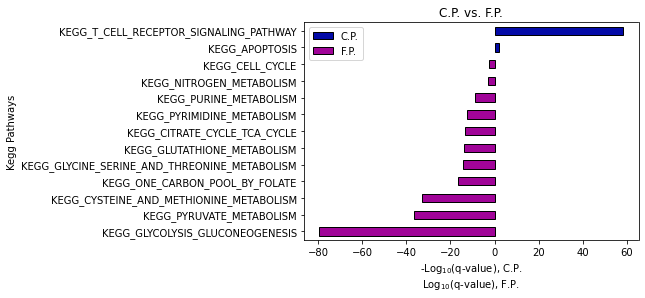

In [10]:
WaterfallPlots('F_I', 'C_I', keep_non_sig = False,
               save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_FI_vs_CI_onlySig.pdf')
WaterfallPlots('C_P', 'F_P', keep_non_sig = False,
               save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_CP_vs_FP_onlySig.pdf')

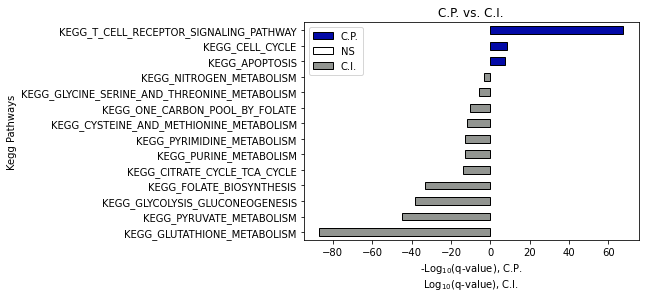

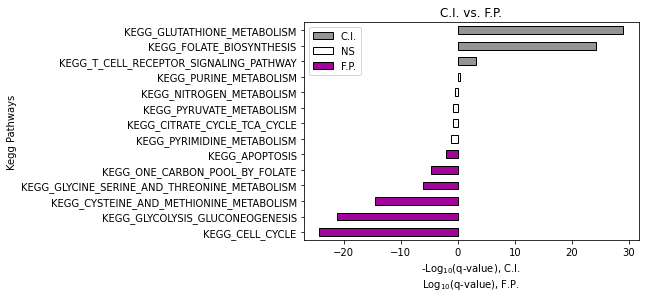

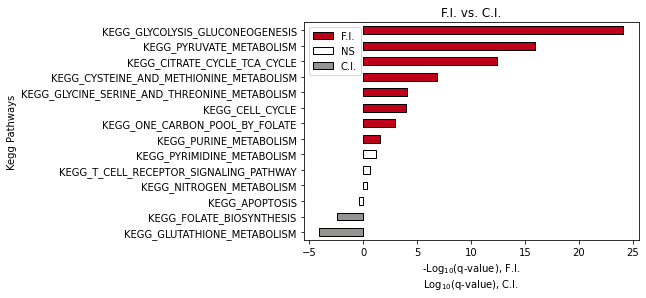

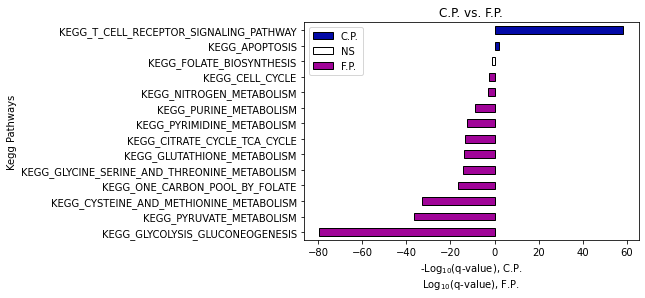

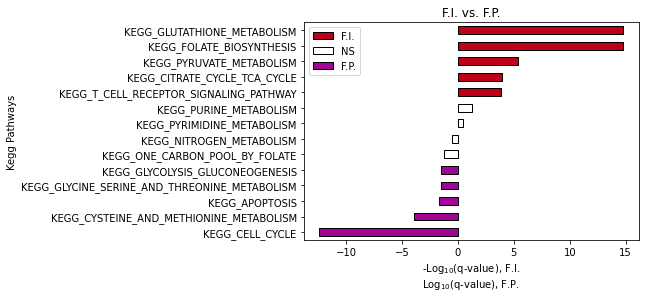

In [68]:
WaterfallPlots('C_P', 'C_I', save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_CP_vs_CI.pdf')
WaterfallPlots('C_I', 'F_P', save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_CI_vs_FP.pdf')
WaterfallPlots('F_I', 'C_I', save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_FI_vs_CI.pdf')
WaterfallPlots('C_P', 'F_P', save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_CP_vs_FP.pdf')
WaterfallPlots('F_I', 'F_P', save_name = 'results/Plots/WaterfallPlots/Waterfall_Kegg_FI_vs_FP.pdf')

In [17]:
def CompareTwoConditions(Adata_, cond1, cond2, pathway, cluster_name = 'seurat_clusters', save_name = None):
    """
    Given two conditions (cond1 and cond2) and a pathway name, this makes a scatter plot of the average
    score for each condition among the different Seurat clusters.
    """
    
    # Copy the Adata object as to not overwrite the global object
    Adata = Adata_.copy()
    
    # Get a list of all the clusters
    clusters = sorted(Adata.obs[cluster_name].unique())
    
    # Make sure the conditions are in the Adata object
    assert cond1 in Adata.obs['combined'].unique(), 'Condition 1 ({}) is not in the Adata object.'.format(cond1)
    assert cond2 in Adata.obs['combined'].unique(), 'Condition 2 ({}) is not in the Adata object.'.format(cond2)
    
    # If a gene is used instead of a pathway, add the gene to the Adata.obs object
    if (pathway in Adata.var_names) & (pathway not in Adata.obs_names):
        Adata.obs[pathway] = Adata.obs_vector(pathway)
    
    # Create a dataframe DF that has the average sample score per condition for each cluster
    DF = Adata.obs.groupby(['combined', cluster_name]).mean().reset_index()
    
    # Create another dataframe df that holds the final information for plotting
    df = pd.DataFrame(index = clusters, columns = [cond1, cond2, 'pval', 'qval'], data = 0)
    
    # Loop over each clusters
    for cluster in clusters:
        
        # Loop over each of the conditions
        for condition in [cond1, cond2]:
        
            # Assign the value from the cluster and condition to the dataframe df
            df.loc[cluster, condition] = DF[(DF[cluster_name] == cluster) & (DF['combined'] == condition)][pathway].iloc[0]
            
        # Find the p-value between all the cells of condition 1 to all the cells of condition 2, across each cluster
        stat, pval = scipy.stats.mannwhitneyu(Adata.obs.loc[((Adata.obs['combined'] == cond1) & (Adata.obs[cluster_name] == cluster)), pathway], \
                                              Adata.obs.loc[((Adata.obs['combined'] == cond2) & (Adata.obs[cluster_name] == cluster)), pathway])
        
        # Assign the p-value to the final dataframe df
        df.loc[cluster, 'pval'] = pval
    
    # Run multiple hypothesis test corrections
    _, df['qval'], _, _ = multipletests(pvals = df['pval'], method = 'fdr_bh')
    
    # Assign significance
    df['sig'] = ['Yes' if x < 0.05 else 'No' for x in df['qval']]
    
    # Calculate size of significance
    df['size'] = -10 * np.log10(df['qval'])
    df['size'] = df['size'].astype(int)
    
    # Determine the color palette
    palette = {'Yes':'xkcd:scarlet', 'No':'xkcd:grey'}
    
    # Make a scatter plot
    ax = sns.scatterplot(data = df, x = cond1, y = cond2, hue = 'sig', palette = palette, size = 'size')
    
    # Adjust text labels
    texts = []
    for i,(x,y) in enumerate(zip(df[cond1], df[cond2])):
        texts.append(ax.text(x, y, i, ha = 'center', va = 'center'))
    adjust_text(texts)
    
    # Set title, adjust handles
    ax.set_title(pathway)
    handles, labels = ax.get_legend_handles_labels()
    lgd = ax.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5))
    ax.set_xlabel(cond1.replace('_', '.') + '. Signature Score')
    ax.set_ylabel(cond2.replace('_', '.') + '. Signature Score')
    
    # Make the plot of y = x
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    x = np.linspace(xmin, xmax)
    y = np.linspace(ymin, ymax)
    ax.plot(x, x, 'k--')

    # Save plot
    if save_name is not None:
        plt.savefig(save_name, bbox_extra_artists = (lgd,), bbox_inches = 'tight')
    plt.show()
    return

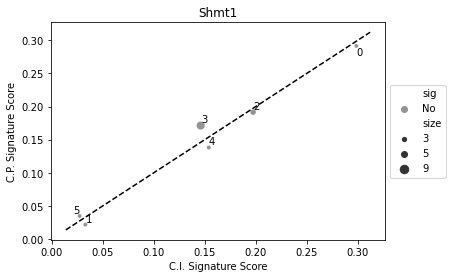

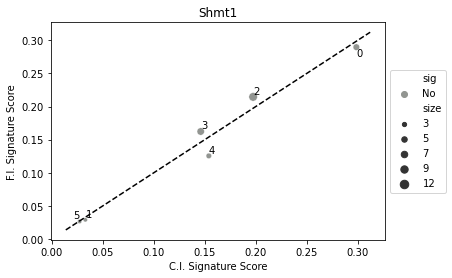

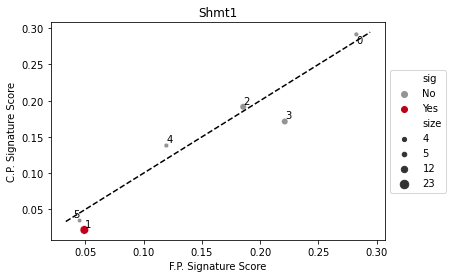

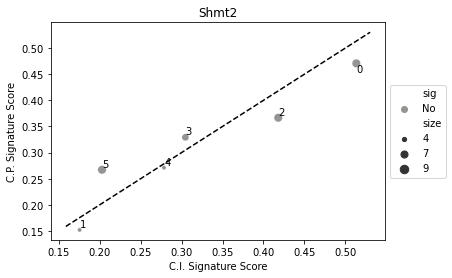

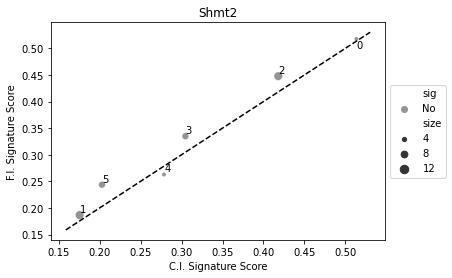

...

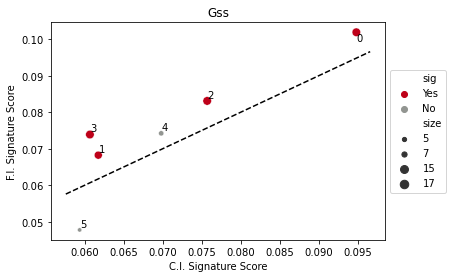

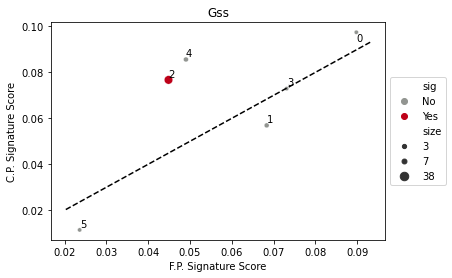

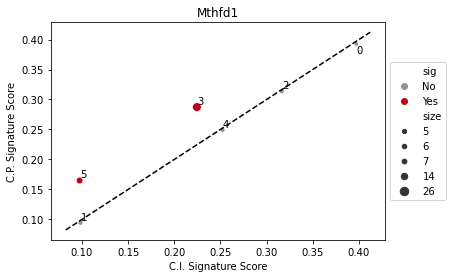

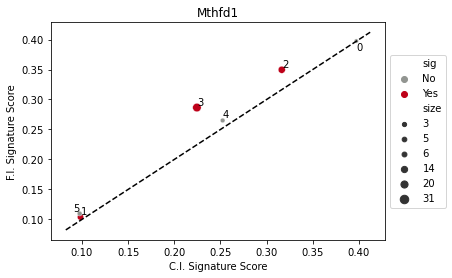

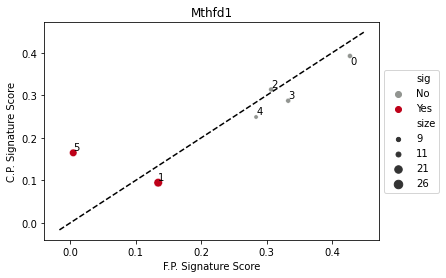

In [134]:
for gene in ['Shmt1', 'Shmt2', 'Sfxn1', 'Dnmt1', 'Dnmt3a', 'Dnmt3b', 'Gss', 'Mthfd1', 'Phgdh']:
    
    CompareTwoConditions(Adata, 'C_I', 'C_P', gene,
                         save_name = 'results/Plots/ScatterPlots/IndividualGenes/Scatter_{}_CI_vs_CP.pdf'.format(gene))
    CompareTwoConditions(Adata, 'C_I', 'F_I', gene,
                         save_name = 'results/Plots/ScatterPlots/IndividualGenes/Scatter_{}_CI_vs_FI.pdf'.format(gene))
    CompareTwoConditions(Adata, 'F_P', 'C_P', gene,
                         save_name = 'results/Plots/ScatterPlots/IndividualGenes/Scatter_{}_FP_vs_CP.pdf'.format(gene))

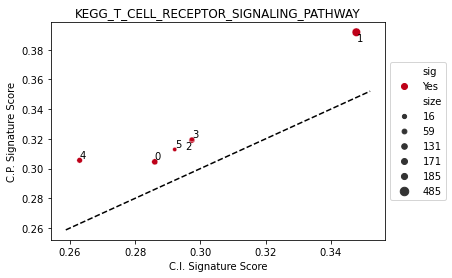

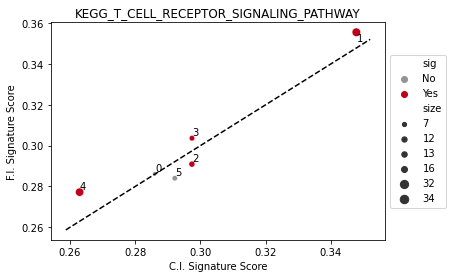

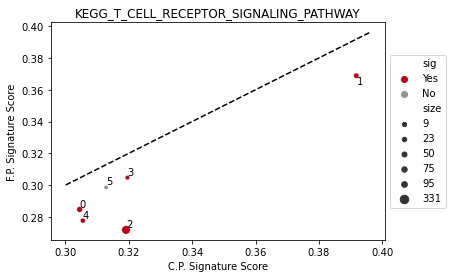

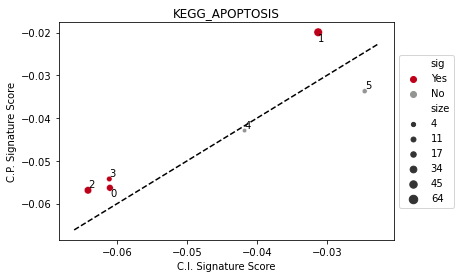

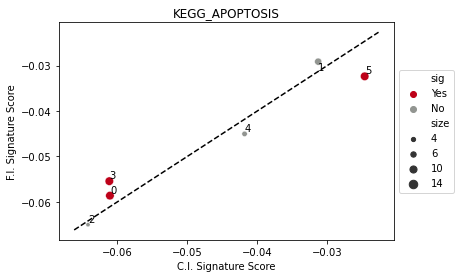

...

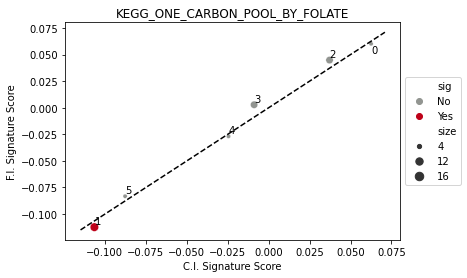

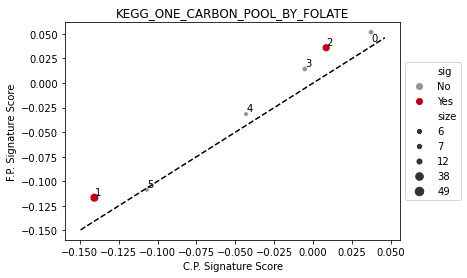

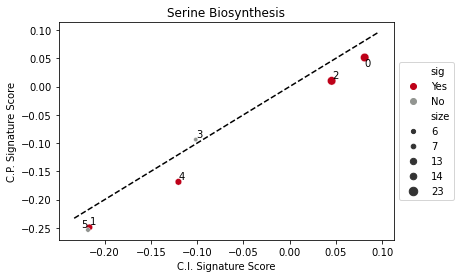

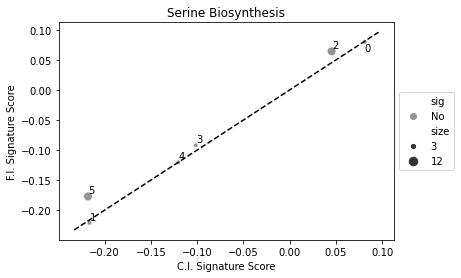

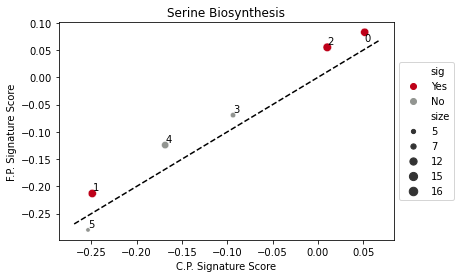

In [142]:
# Define gene lists 
list_names = ['KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY', 'KEGG_APOPTOSIS',
              'KEGG_GLYCOLYSIS_GLUCONEOGENESIS', 'KEGG_ONE_CARBON_POOL_BY_FOLATE']
gene_lists = [kegg_dict[x] for x in list_names]

# Add Serine Biosynthesis
list_names = list_names + ['Serine Biosynthesis']
gene_lists = gene_lists + [SerineBios] 

# Calculate gene scores
Adata = CalculateGeneScores(Adata, gene_lists = gene_lists, gene_lists_names = list_names)

# Define names to save to files
save_names = ['KeggTCR_Signaling', 'KeggApoptosis', 'KeggGlycoGlucogeo', 'Kegg1C_Folate', 'SerineBios']

for list_name,save_name in zip(list_names,save_names):
    
    CompareTwoConditions(Adata, 'C_I', 'C_P', list_name,
                         save_name = 'results/Plots/ScatterPlots/GeneSignatures/Scatter_{}_CI_vs_CP.pdf'.format(save_name))
    CompareTwoConditions(Adata, 'C_I', 'F_I', list_name,
                         save_name = 'results/Plots/ScatterPlots/GeneSignatures/Scatter_{}_CI_vs_FI.pdf'.format(save_name))
    CompareTwoConditions(Adata, 'C_P', 'F_P', list_name,
                         save_name = 'results/Plots/ScatterPlots/GeneSignatures/Scatter_{}_CP_vs_FP.pdf'.format(save_name))

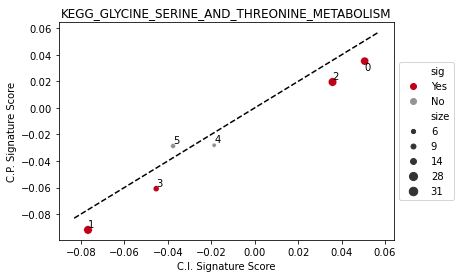

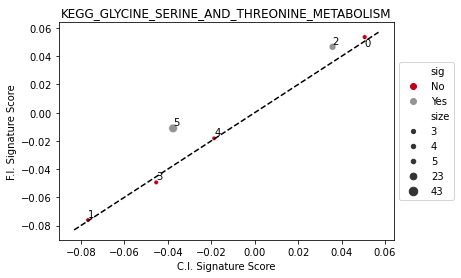

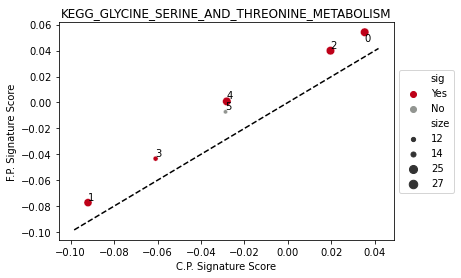

In [30]:
CompareTwoConditions('C_I', 'C_P', 'KEGG_GLYCINE_SERINE_AND_THREONINE_METABOLISM', save_name = 'results/Plots/ScatterPlots/Scatter_KeggSerine_CI_vs_CP.pdf')
CompareTwoConditions('C_I', 'F_I', 'KEGG_GLYCINE_SERINE_AND_THREONINE_METABOLISM', save_name = 'results/Plots/ScatterPlots/Scatter_KeggSerine_CI_vs_FI.pdf')
CompareTwoConditions('C_P', 'F_P', 'KEGG_GLYCINE_SERINE_AND_THREONINE_METABOLISM', save_name = 'results/Plots/ScatterPlots/Scatter_KeggSerine_CP_vs_FP.pdf')

# Correlate KEGG TCR Signaling to 1-Carbon Signal

In [13]:
Adata = CalculateGeneScores(Adata, gene_lists = kegg_dict['KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY'],
                            gene_lists_names = 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY')

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


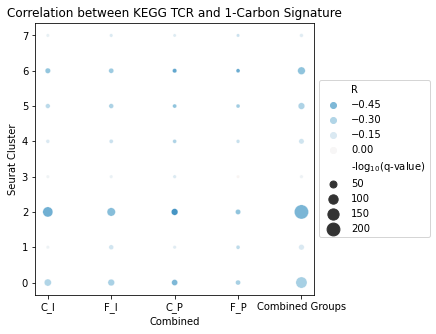

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


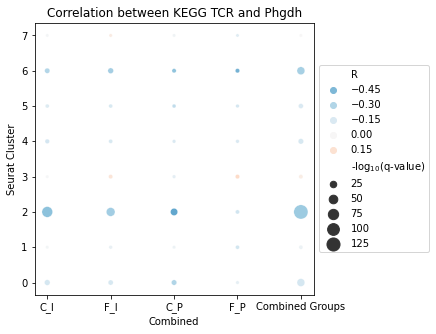

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


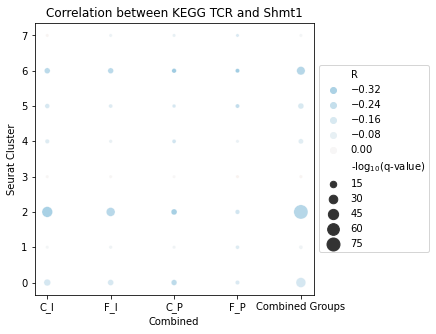

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


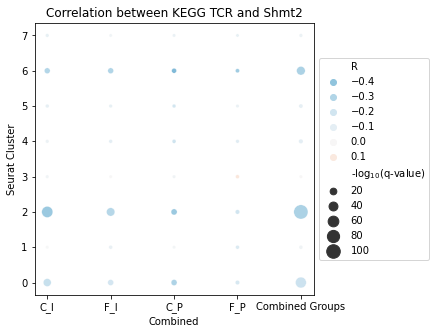

In [41]:
def Correlate_KEGGTCR_to_OneCarbon(list1 = 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY', list2 = '1-Carbon Signature',
                                   cbar = 'RdBu_r', save_name = None):
    

    # Make sure the TCR Signaling score and 1-Carbon signals are already in the Adata object
    if list1 not in Adata.var_names:
        assert list1 in Adata.obs.columns, 'Make sure first score is done.'
    
    if list2 not in Adata.var_names:
        assert list2 in Adata.obs.columns, 'Make sure second score is done.'
    
    # Make an empty dataframe to store the results
    pvals = pd.DataFrame(index = sorted(Adata.obs['seurat_clusters'].values.unique()),
                         columns = ['C_I', 'F_I', 'C_P', 'F_P', 'Combined Groups'], data = 0)

    rvals = pd.DataFrame(index = sorted(Adata.obs['seurat_clusters'].values.unique()),
                         columns = ['C_I', 'F_I', 'C_P', 'F_P', 'Combined Groups'], data = 0)
    
    df_data = Adata.obs[['combined', 'seurat_clusters']]
    
    for listX in [list1, list2]:
        if listX in Adata.var_names:
            df_data.loc[:, listX] = Adata[:, listX].X
        else:
            df_data.loc[:, listX] = Adata.obs[listX]
            
    
    # Find the Pearson R-value and P-value for each combination
    for group in pvals.columns[:-1]:
        for cluster in pvals.index:

            # Get cells that belong to a given group and Seurat cluster, and subset the data
            cells = (df_data['seurat_clusters'] == cluster) & (df_data['combined'] == group)
            subset = df_data.loc[cells]

            # Find the Pearson correlation between the two pathways
            r, p = scipy.stats.pearsonr(subset[list2].values,
                                        subset[list1].values)

            pvals.loc[cluster, group] = p
            rvals.loc[cluster, group] = r

    # Find the Pearson R-value and P-value for all cell combined
    for cluster in pvals.index:

        cells = df_data['seurat_clusters'] == cluster
        subset = df_data.loc[cells]

        # Find the Pearson correlation between the two pathways
        r, p = scipy.stats.pearsonr(subset[list2].values,
                                    subset[list1].values)

        pvals.loc[cluster, 'Combined Groups'] = p
        rvals.loc[cluster, 'Combined Groups'] = r
        
    # Count number of groups and gene lists
    nclusters = pvals.shape[0]
    nsamples = pvals.shape[1]

    # Make x- and y-coordinates for a scatterplot
    x_coordinates = list(np.array([[i]*(nclusters) for i in range(1, nsamples+1)]).flatten())
    y_coordinates = list(range(0, nclusters)) * nsamples

    # Make an empty matrix called 'Mtx' for plotting and fill it in
    Mtx = pd.DataFrame(columns = ['x', 'y', 'pvals', 'qvals', 'rvals'])
    
    
    
    _, qvals, _, _ = multipletests(pvals.melt()['value'], method = 'fdr_bh')   

    Mtx.loc[:, 'pvals'] = -np.log10(pvals.melt()['value'])
    Mtx.loc[:, 'qvals'] = -np.log10(qvals)
    Mtx['rvals'] = rvals.melt()['value']
    Mtx['x'] = x_coordinates
    Mtx['y'] = y_coordinates
    
    # Make the plot
    fig, ax = MakeFigAxes(n_axes = 1, ncols = 1, figsize = (5,5), single = True)
    sns.scatterplot(data = Mtx, x = 'x', y = 'y', hue = 'rvals', size = 'qvals', ax = ax,
                         palette = cbar, sizes = (10,200), hue_norm = (-1,1))

    # Change the legend labels
    handles, labels = ax.get_legend_handles_labels()
    labels = list(map(lambda x: x.replace('rvals', 'R'), labels))
    labels = list(map(lambda x: x.replace('qvals', '-log$_{10}$(q-value)'), labels))
    lgd = ax.legend(handles, labels, loc = 'center left', bbox_to_anchor=(1, 0.5))

    # Put labels on the plot
    plt.xlabel('Combined')
    plt.ylabel('Seurat Cluster')
    plt.xticks([i+1 for i in range(nsamples)], pvals.columns)
    plt.title('Correlation between KEGG TCR and {}'.format(list2))
    
    if save_name is not None:
        plt.savefig(save_name, bbox_extra_artists = (lgd,), bbox_inches = 'tight')

    plt.show()
    return

f = 'results/Plots/DotPlots/'

Correlate_KEGGTCR_to_OneCarbon(save_name = f + 'Dots_CorrelateTCR_1Carbon.pdf')
Correlate_KEGGTCR_to_OneCarbon(list2 = 'Phgdh', save_name = f + 'Dots_CorrelateTCR_Phgdh.pdf')
Correlate_KEGGTCR_to_OneCarbon(list2 = 'Shmt1', save_name = f + 'Dots_CorrelateTCR_Shmt1.pdf')
Correlate_KEGGTCR_to_OneCarbon(list2 = 'Shmt2', save_name = f + 'Dots_CorrelateTCR_Shmt2.pdf')

# Violin Plots of 1-Carbon Signature for each Cluster

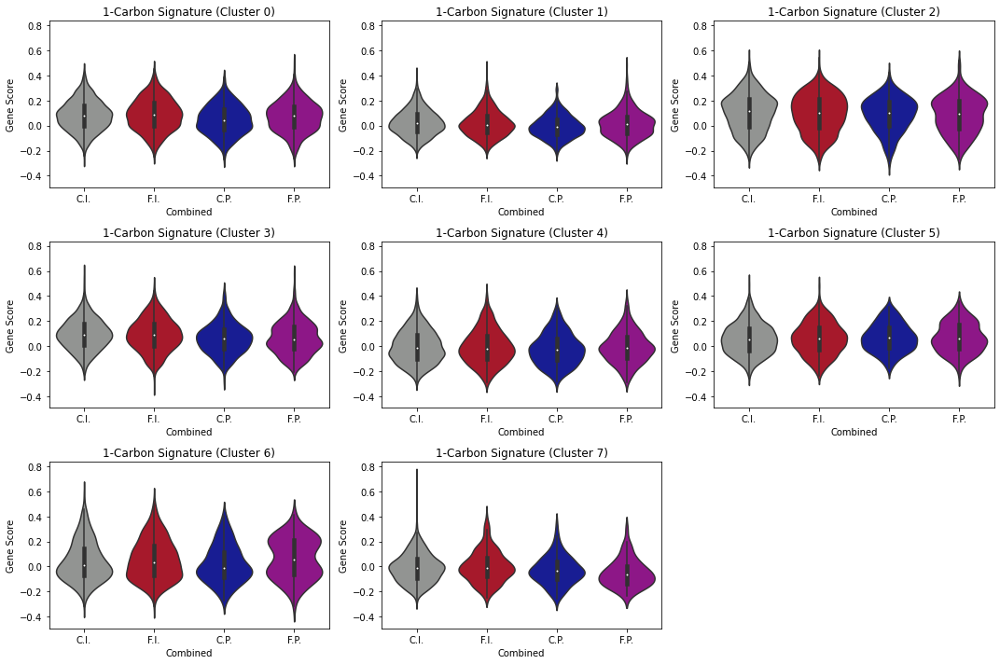

In [39]:
def ViolinPerCluster():
    
    # Make figure and axes
    # Number of axes/subplots is equal to number of gene lists
    # Number of columns is default to 3, unless there are fewer than 3 gene lists
    n_axes = 8
    ncols = 3
    figsize = (15,10)
    ncols = min(ncols, n_axes)
    fig, axes = MakeFigAxes(ncols = ncols, n_axes = n_axes, figsize = figsize)
    
    # Set ymin and ymax
    ymin = 0
    ymax = 0
    
    
    for i,cluster in enumerate(sorted(Adata.obs['seurat_clusters'].unique())):
        
        # Subset the data
        adata = Adata[Adata.obs['seurat_clusters'] == cluster].copy()
    
        # Calculate the gene scores for each gene list
        adata = CalculateGeneScores(adata, gene_lists = OneCarbonsig, gene_lists_names = ['1-Carbon Signature'], copy = False)

        # Formalize names
        adata.obs['combined'] = adata.obs['combined'].astype(str).apply(Formalize)
    
        # Get the ith axis
        ax = axes.flatten()[i]

        # Make a violin plot
        sns.violinplot(data = adata.obs, x = 'combined', y = '1-Carbon Signature', scale = 'width',
                       ax = ax,
                       order = ['C.I.', 'F.I.', 'C.P.', 'F.P.'],
                       palette = xkcd(['grey', 'scarlet', 'cobalt blue', 'barney purple']))

        # Set the labels and title
        ax.set_xlabel('Combined')
        ax.set_ylabel('Gene Score')
        ax.set_title('1-Carbon Signature (Cluster {})'.format(cluster))
        
        ymin = min(ymin, ax.get_ylim()[0])
        ymax = max(ymax, ax.get_ylim()[1])
        
    for i,cluster in enumerate(sorted(Adata.obs['seurat_clusters'].unique())):
        
        ax = axes.flatten()[i]
        ax.set_ylim(ymin, ymax)
    
    # Save the figure
    plt.tight_layout()
    plt.savefig('results/Plots/ViolinPlots/Violins_1Carbon_byCombined.pdf')
    plt.show()
    return
    
ViolinPerCluster()

# Correlate to TCR Signaling

In [77]:
def CorrelateToTCRSignaling(Adata_, gene_lists = None, gene_lists_names = None, gene_dict = None):
    """
    
    """
    
    # Make a copy of the Adata object
    Adata = Adata_.copy()

    # Make sure the TCR Signaling score is already in the Adata object
    assert 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY' in Adata.obs.columns, 'Make sure TCR signaling score is done.'
    
    # Get the gene lists and names
    gene_lists, gene_lists_names = CheckGeneLists(gene_lists = gene_lists, gene_lists_names = gene_lists_names,
                                                  gene_dict = gene_dict)
    
    # Calculate score for other pathway
    Adata = CalculateGeneScores(Adata, gene_lists = gene_lists, gene_lists_names = gene_lists_names, copy = False)
    
    # Make an empty dataframe to store the results
    df = pd.DataFrame(index = ['C_I', 'F_I', 'C_P', 'F_P'])#, columns = ['r_value', 'p_value'], data = 0)
    
    # Loop over each gene signature
    for sig in gene_lists_names:
    
        # Loop over each group and calculate the correlation
        for sample in list(df.index):

            x = Adata.obs.loc[Adata.obs['combined'] == sample, 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY'].values
            y = Adata.obs.loc[Adata.obs['combined'] == sample, sig].values

            r, p = scipy.stats.pearsonr(x, y)

            df.loc[sample, '{}_r_value'.format(sig)] = r
            df.loc[sample, '{}_p_value'.format(sig)] = p
        
    return df

Adata = CalculateGeneScores(Adata, gene_lists = kegg_dict['KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY'],
                            gene_lists_names = ['KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY'])

df = CorrelateToTCRSignaling(Adata, gene_list = SerineBios, gene_list_name = 'Serine Biosynthesis')

In [79]:
# Define gene lists 
list_names = list(kegg_dict.keys())
gene_lists = [kegg_dict[x] for x in list_names]

# Add Serine Biosynthesis
list_names = list_names + ['Serine Biosynthesis']
gene_lists = gene_lists + [SerineBios]

df = CorrelateToTCRSignaling(Adata, gene_lists = gene_lists, gene_lists_names = list_names)

In [211]:
def CompareTwoPathways(cond, pathway1, pathway2, cluster_name = 'integrated_snn_res.0.125', save_name = None):
    """
    Given one condition and two pathways (pathway1 and pathway2), this makes a scatter plot of the average
    score for each condition among the different Seurat clusters.
    """
    
    # Get a list of all the clusters
    clusters = sorted(Adata.obs[cluster_name].unique())

    # Create a dataframe df that has the average sample score per cluster (while also subsetting for the condition)
    df = Adata.obs[Adata.obs['combined'] == cond].groupby(cluster_name).mean()
    
    # Find the Pearson correlation coefficient (linear correlation)
    r, pval = scipy.stats.pearsonr(df[pathway1], df[pathway2])
    
    # Make a scatter plot and create a title
    ax = sns.scatterplot(data = df, x = pathway1, y = pathway2)
    title = cond.replace('_', '.') + '.'
    title += '\nR$^2$ = {:.2f}, p-val = {:.2g}'.format(r**2, pval)
    ax.set_title(title)
    
    # Adjust text labels
    texts = []
    for i,(x,y) in enumerate(zip(df[pathway1], df[pathway2])):
        texts.append(ax.text(x, y, i, ha = 'center', va = 'center'))
    adjust_text(texts)
    
    # Plot a line of best fit
    m, b = np.polyfit(df[pathway1], df[pathway2], 1)
    ax.plot(df[pathway1], m*df[pathway1] + b, 'k--', linewidth = 1)
    
    # Save plot
    if save_name is not None:
        plt.savefig(save_name)
    plt.show()
    return

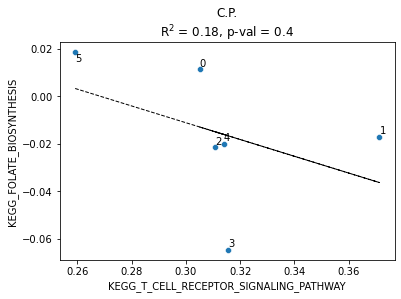

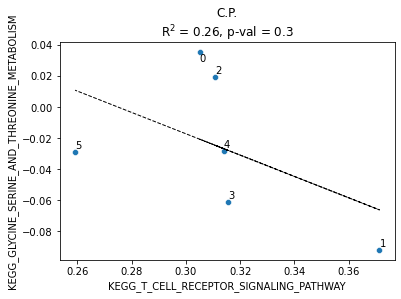

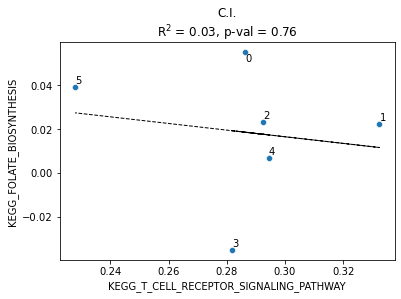

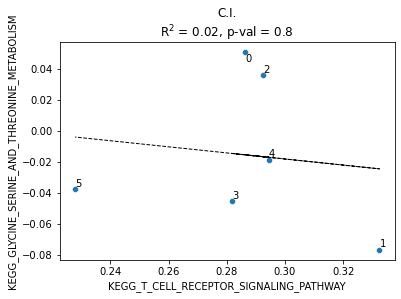

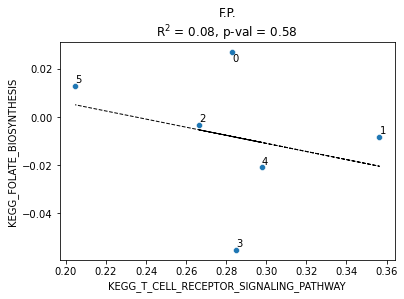

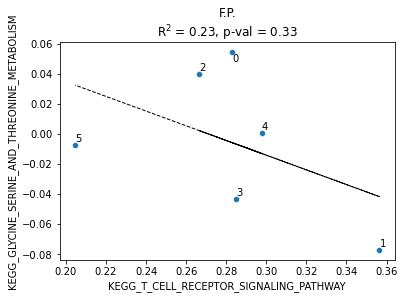

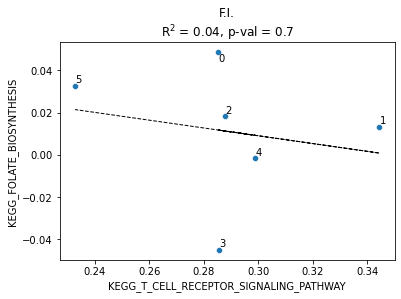

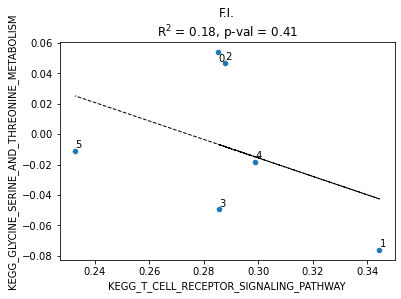

In [32]:
for (condition, name) in zip(['C_P', 'C_I', 'F_P', 'F_I'], ['CP', 'CI', 'FP', 'FI']):
    CompareTwoPathways(condition, 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY', 'KEGG_FOLATE_BIOSYNTHESIS',
                   save_name = 'results/Plots/ScatterPlots/Scatter_{}_KeggTCR_vs_KeggFolate.pdf'.format(name))
    CompareTwoPathways(condition, 'KEGG_T_CELL_RECEPTOR_SIGNALING_PATHWAY', 'KEGG_GLYCINE_SERINE_AND_THREONINE_METABOLISM',
                   save_name = 'results/Plots/ScatterPlots/Scatter_{}_KeggTCR_vs_KeggSerine.pdf'.format(name))

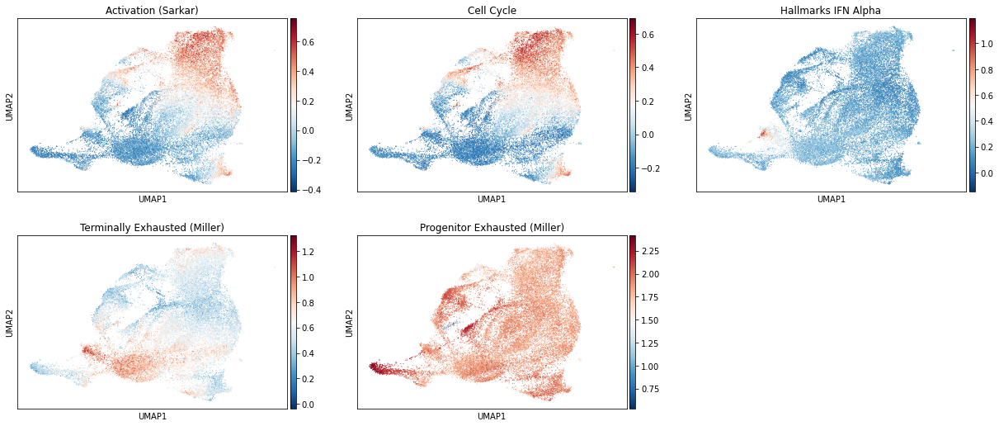

In [45]:
GeneSignatureUMAP(Adata, gene_lists = [sarkar_activation, cellcycle, IFNalpha, terminallyexh, progenitorexh],
                  gene_lists_names = ['Activation (Sarkar)', 'Cell Cycle', 'Hallmarks IFN Alpha',
                                      'Terminally Exhausted (Miller)', 'Progenitor Exhausted (Miller)'],
                  save_name = 'results/Plots/UMAPs/UMAPs_GeneSignatures.png')

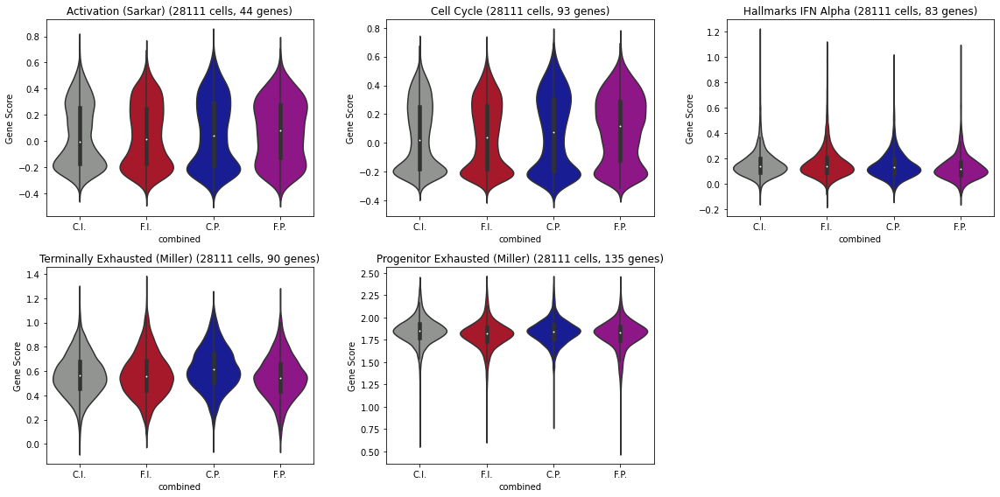

In [24]:
MakeViolinSignatures(Adata, gene_lists = [sarkar_activation, cellcycle, IFNalpha, terminallyexh, progenitorexh],
                     gene_lists_names = ['Activation (Sarkar)', 'Cell Cycle', 'Hallmarks IFN Alpha',
                     'Terminally Exhausted (Miller)', 'Progenitor Exhausted (Miller)'], figsize = (16,8),
                     order = ['C.I.', 'F.I.', 'C.P.', 'F.P.'], groupby = 'combined',
                     palette = xkcd(['grey', 'scarlet', 'cobalt blue', 'barney purple']),
                     save_name = 'results/Plots/ViolinPlots/Violins_GeneSigs_byCombined.pdf')

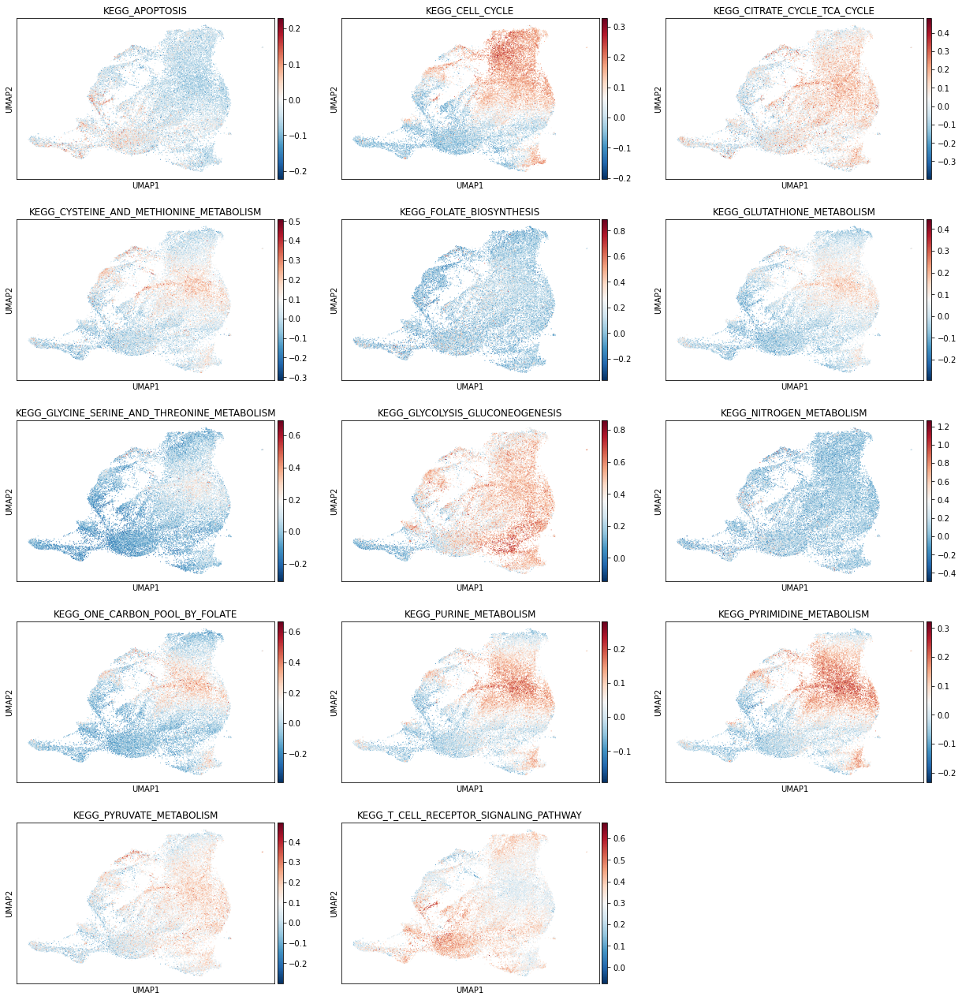

In [36]:
GeneSignatureUMAP(Adata, gene_lists = kegg_lists, gene_lists_names = kegg_names,
                  save_name = 'results/Plots/UMAPs/GeneSignatureAnalyses/UMAP_KEGG_Sigs.pdf')

# Heatmap of Genes and Signatures

### Individual Genes on One Plot

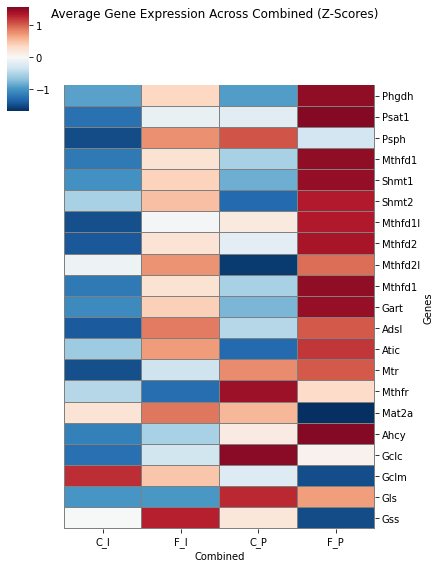

In [138]:
MakeHeatmapGenes(Adata, genes = SerineBios + Folate + Purine + MethionineCycle + Transful,
                 groupby = 'combined', order = ['C_I', 'F_I', 'C_P', 'F_P'], figsize = (6,8),
                 save_name = 'results/Plots/Heatmaps/Heatmap_Genes_byCombined.pdf')

### KEGG Signatures

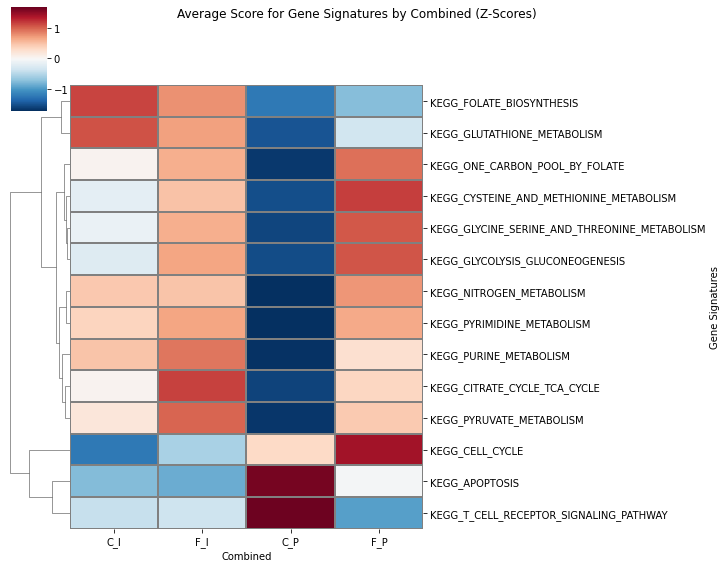

In [139]:
MakeHeatmapSignatures(Adata, gene_lists = kegg_lists, gene_lists_names = kegg_names, groupby = 'combined',
                      order = ['C_I', 'F_I', 'C_P', 'F_P'],
                      row_cluster = True, save_name = 'results/Plots/Heatmaps/Mouse_KEGG_Sigs_byCombined.pdf')

### KEGG 61 Signatures

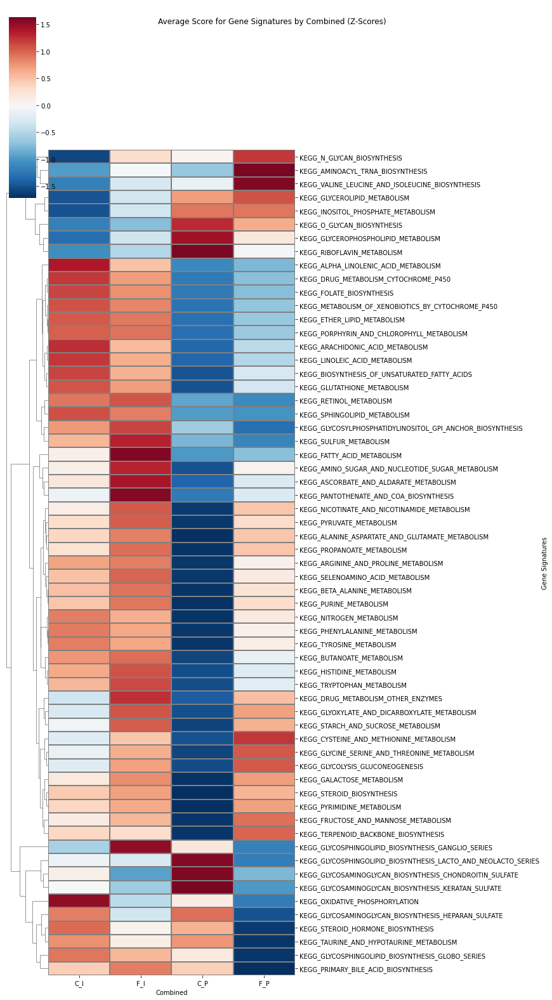

"MakeHeatmapSignatures(Adata, gene_lists = kegg61_lists[:30], gene_lists_names = kegg61_names[:30],\n                      order = ['C_I', 'F_I', 'C_P', 'F_P'], groupby = 'combined', figsize = (12,12),\n                      row_cluster = True,\n                      save_name = dropbox + 'Heatmap_KEGG61Lists_Part1_byCombined.png')\n\nMakeHeatmapSignatures(Adata, gene_lists = kegg61_lists[30:], gene_lists_names = kegg61_names[30:],\n                      order = ['C_I', 'F_I', 'C_P', 'F_P'], groupby = 'combined', figsize = (11,12),\n                      row_cluster = True)#, save_name = 'results/Mouse/Plots/Heatmaps/Mouse_KEGG_Sigs_byCombined.pdf')"

In [66]:
MakeHeatmapSignatures(Adata, gene_lists = kegg61_lists, gene_lists_names = kegg61_names,
                      order = ['C_I', 'F_I', 'C_P', 'F_P'], groupby = 'combined', figsize = (12,22),
                      row_cluster = True,
                      save_name = 'results/Plots/Heatmaps/Heatmap_KEGG61Lists_byCombined.png')

### Methylation Signatures

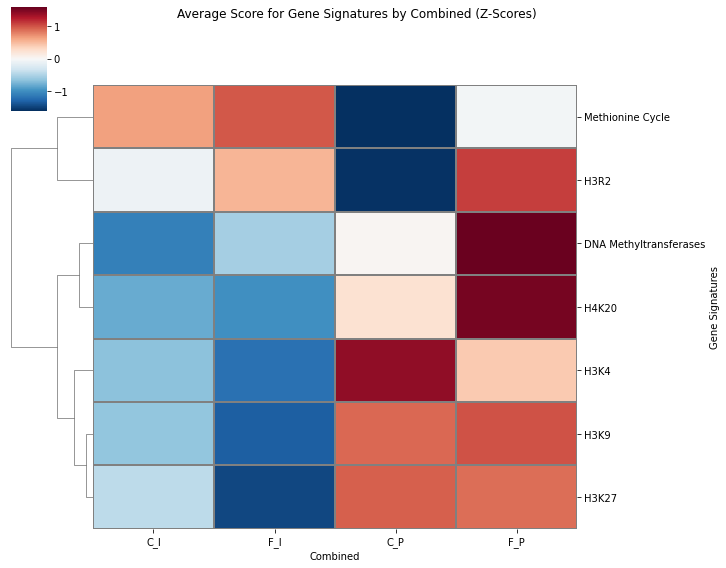

In [140]:
MakeHeatmapSignatures(Adata, gene_dict = HistoneMethGenes , groupby = 'combined',
                      order = ['C_I', 'F_I', 'C_P', 'F_P'],
                      row_cluster = True, save_name = 'results/Plots/Heatmaps/Mouse_HistoneMeth_Sigs_byCombined.pdf')

In [ ]:
MakeHeatmapGenes(Adata, genes = ['Phgdh', 'Psph', 'Psat1'], groupby = 'combined',
                 save_name = 'results/Plots/Heatmaps/Serine_Biosynthesis_Genes_Heatmap.pdf')

### Metabolism Genes

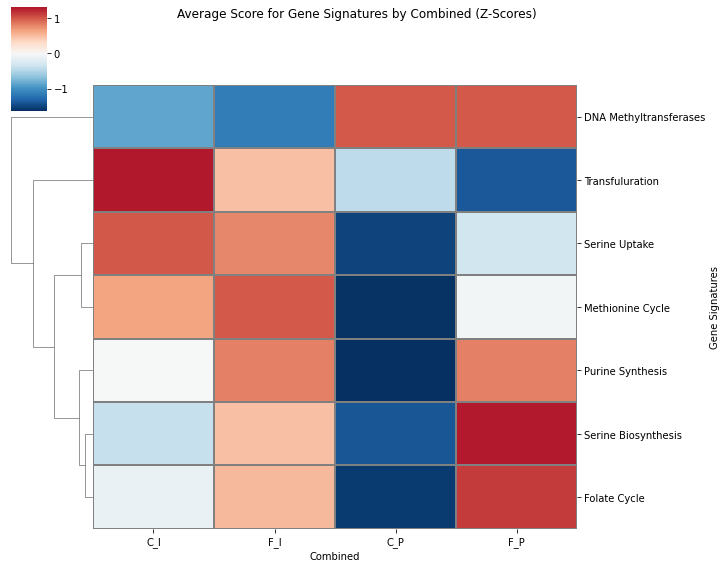

In [141]:
MakeHeatmapSignatures(Adata, gene_dict = metabolism , groupby = 'combined',
                      order = ['C_I', 'F_I', 'C_P', 'F_P'],
                      row_cluster = True, save_name = 'results/Plots/Heatmaps/Heatmap_Metabolism_Sigs_byCombined.pdf')

# Heatmap of Genes

### CD8 T-Cell Genes

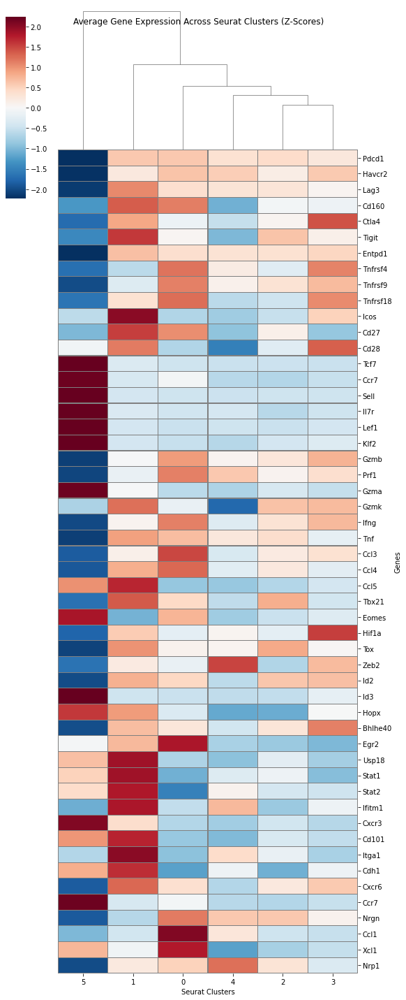

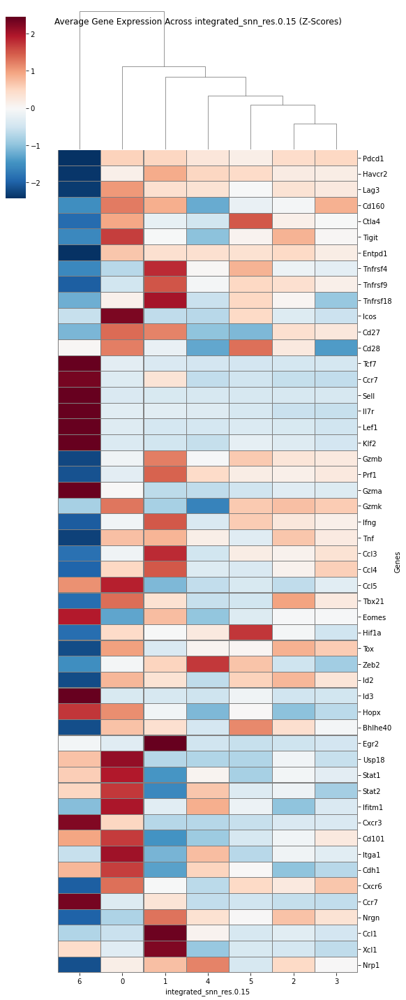

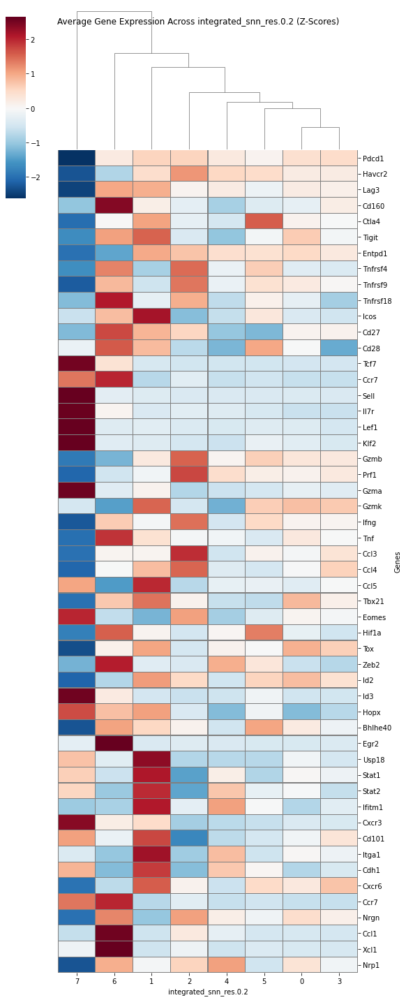

In [24]:
genes = ['Pdcd1', 'Havcr2', 'Lag3', 'Cd160', 'Ctla4', 'Tigit', 'Entpd1', 'Cd244',
         'Tnfrsf4', 'Tnfrsf9', 'Tnfrsf18', 'Icos', 'Cd27', 'Cd28',
         'Tcf7', 'Ccr7', 'Sell', 'Il7r', 'Lef1', 'Klf2',
         'Gzmb', 'Prf1', 'Gzma', 'Gzmk', 'Ifng', 'Tnf', 'Ccl3', 'Ccl4', 'Ccl5',
         'Tbx21', 'Eomes', 'Hif1a', 'Tox', 'Zeb2', 'Id2', 'Id3', 'Hopx', 'Bhlhe40', 'Egr2',
         'Mx1', 'Usp18', 'Stat1', 'Stat2', 'Ifitm1',
         'Cxcr3', 'Cd101', 'Itgae', 'Itga1', 'Cdh1', 'Cxcr6', 'Ccr7', 'Nm1', 'Nrgn',
         'Ccl1', 'Xcl1', 'Nrp1']

MakeHeatmapGenes(Adata, genes = genes, figsize = (8,20), col_cluster = True, groupby = 'seurat_clusters',
                 save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellgenes_6clusters.png')

MakeHeatmapGenes(Adata, genes = genes, figsize = (8,20), col_cluster = True, groupby = 'integrated_snn_res.0.15',
                 save_name = 'Heatmap_CD8Tcellgenes_7clusters.png')

MakeHeatmapGenes(Adata, genes = genes, figsize = (8,20), col_cluster = True, groupby = 'integrated_snn_res.0.2',
                 save_name = 'Heatmap_CD8Tcellgenes_8clusters.png')

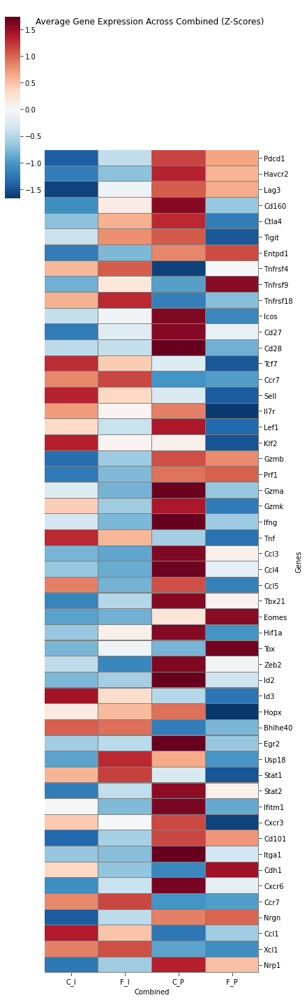

In [37]:
genes = ['Pdcd1', 'Havcr2', 'Lag3', 'Cd160', 'Ctla4', 'Tigit', 'Entpd1', 'Cd244',
         'Tnfrsf4', 'Tnfrsf9', 'Tnfrsf18', 'Icos', 'Cd27', 'Cd28',
         'Tcf7', 'Ccr7', 'Sell', 'Il7r', 'Lef1', 'Klf2',
         'Gzmb', 'Prf1', 'Gzma', 'Gzmk', 'Ifng', 'Tnf', 'Ccl3', 'Ccl4', 'Ccl5',
         'Tbx21', 'Eomes', 'Hif1a', 'Tox', 'Zeb2', 'Id2', 'Id3', 'Hopx', 'Bhlhe40', 'Egr2',
         'Mx1', 'Usp18', 'Stat1', 'Stat2', 'Ifitm1',
         'Cxcr3', 'Cd101', 'Itgae', 'Itga1', 'Cdh1', 'Cxcr6', 'Ccr7', 'Nm1', 'Nrgn',
         'Ccl1', 'Xcl1', 'Nrp1']


MakeHeatmapGenes(Adata, genes = genes, figsize = (6,20), groupby = 'combined', order = ['C_I', 'F_I', 'C_P', 'F_P'],
                 save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellgenes_byCombined.png')

### CD8 T Cell Signatures

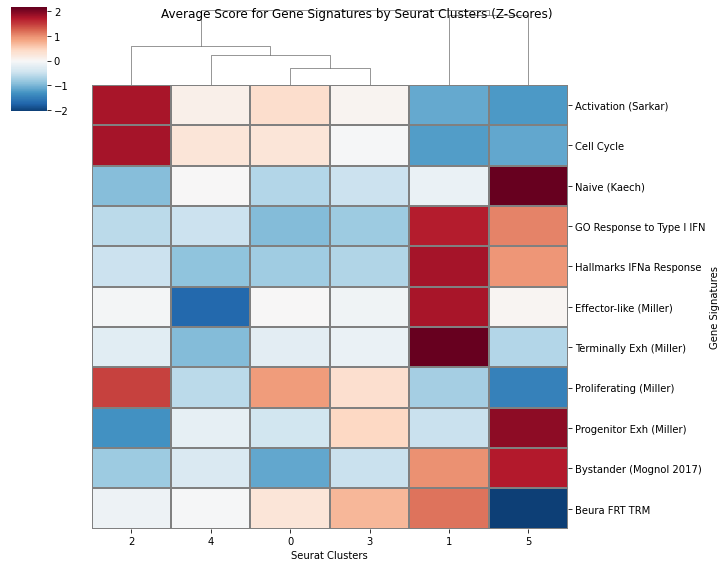

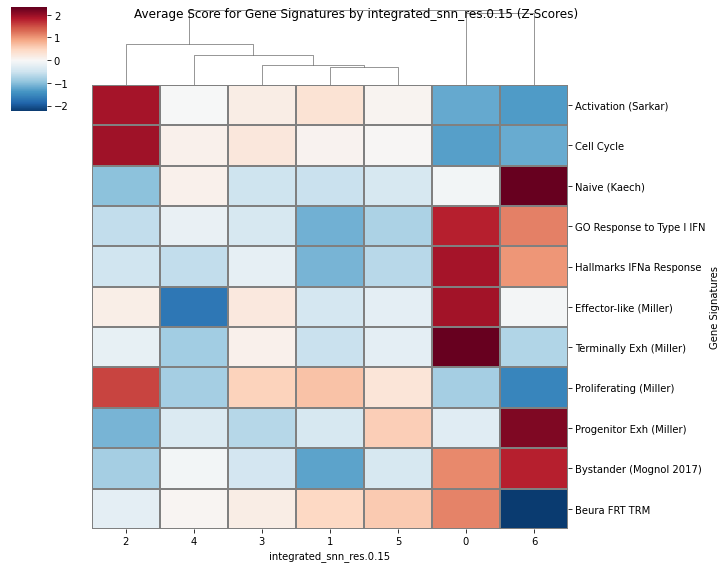

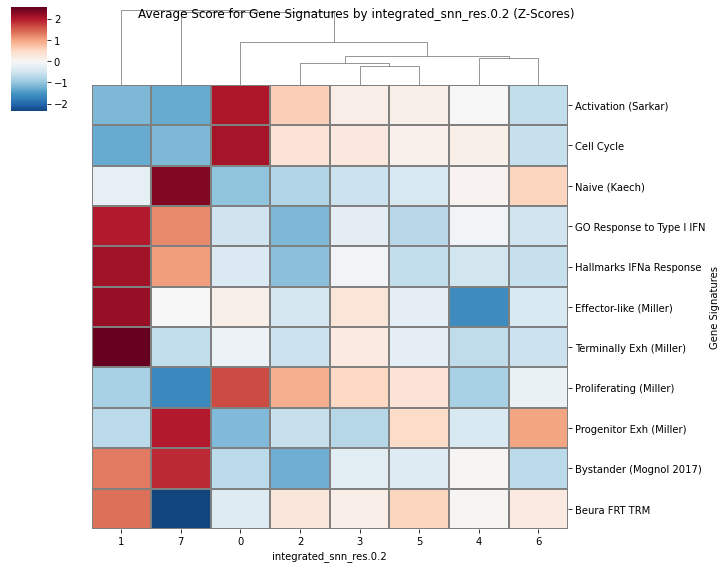

In [28]:
MakeHeatmapSignatures(Adata, gene_dict = Tcell_dict, groupby = 'seurat_clusters', col_cluster = True,
                      save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellsigs_6clusters.png')

MakeHeatmapSignatures(Adata, gene_dict = Tcell_dict, groupby = 'integrated_snn_res.0.15', col_cluster = True,
                      save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellsigs_7clusters.png')

MakeHeatmapSignatures(Adata, gene_dict = Tcell_dict, groupby = 'integrated_snn_res.0.2', col_cluster = True,
                      save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellsigs_8clusters.png')

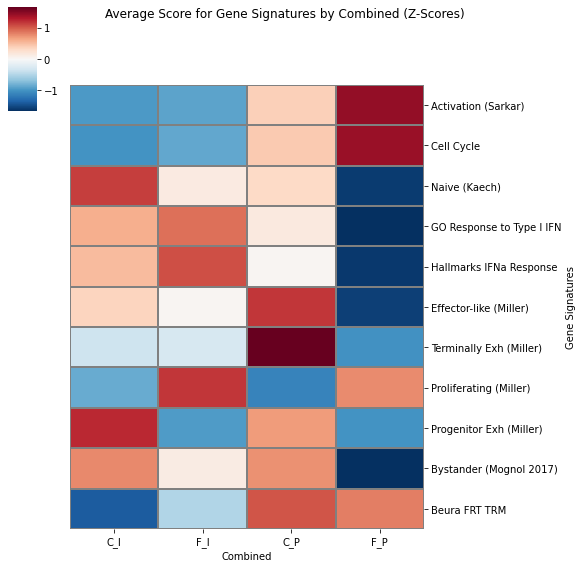

In [40]:
MakeHeatmapSignatures(Adata, gene_dict = Tcell_dict, groupby = 'combined', order = ['C_I', 'F_I', 'C_P', 'F_P'],
                      figsize = (8,8), save_name = 'results/Plots/Heatmaps/Heatmap_CD8Tcellsigs_byCombined.png')

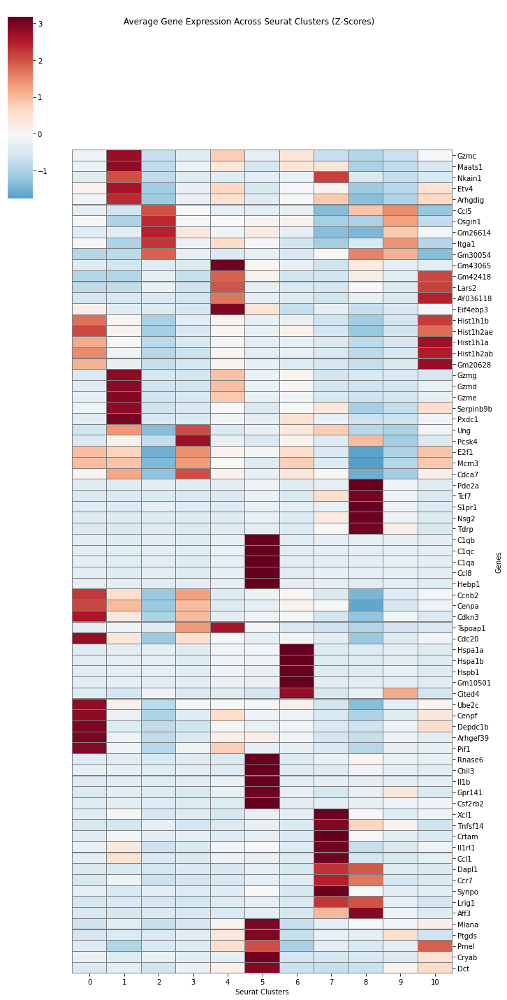

In [40]:
# Load DE Genes
DEgenes = pd.read_excel('results/Integration/DEgenes_per_cluster_Scanpy.xlsx', sheet_name = None,
                        engine = 'openpyxl')
DEgenes = {'Cluster {}'.format(key):DEgenes[key].set_index('Gene Names') for key in DEgenes.keys()}

# Plot DE Genes on heatmap
genes = []

for i,key in enumerate(DEgenes.keys()):
    genes.extend(DEgenes[key].sort_values(by = 'Log2FC', ascending = False).index[:5])

MakeHeatmapGenes(Adata, genes = genes, figsize = (10,20), 
                 save_name = 'results/Plots/Heatmaps/Mouse_DEgenes_perCluster.pdf')

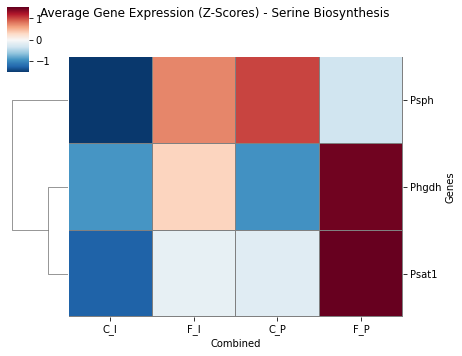

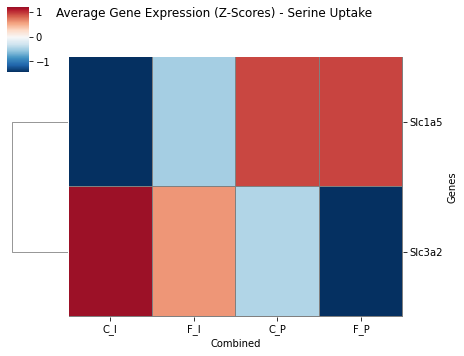

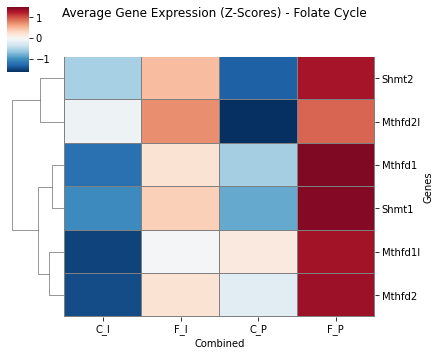

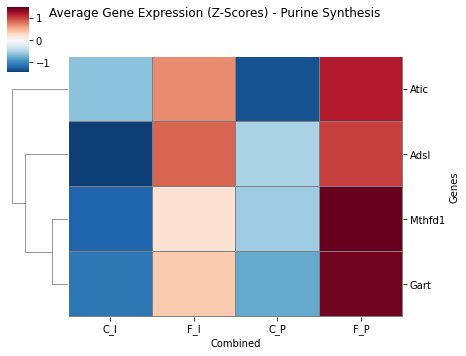

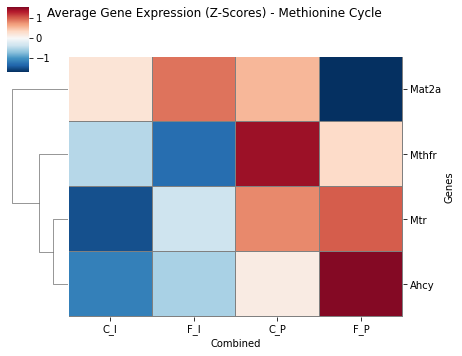

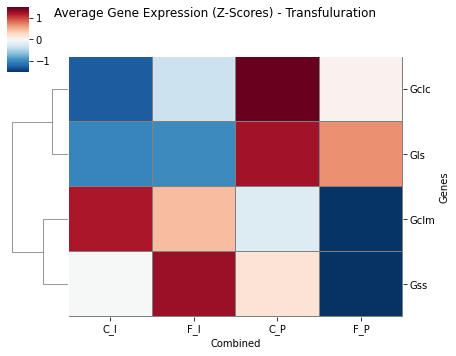

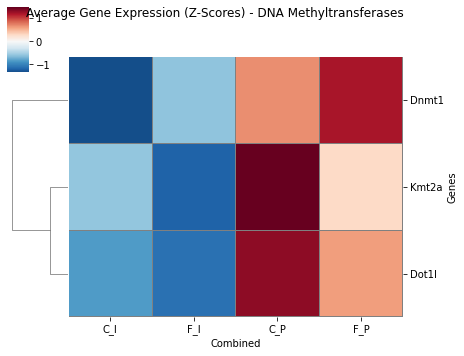

In [143]:
for key in metabolism.keys():
    MakeHeatmapGenes(Adata, genes = metabolism[key], groupby = 'combined', figsize = (6,5), row_cluster = True,
                     title = 'Average Gene Expression (Z-Scores) - {}'.format(key), col_cluster = False,
                     order = ['C_I', 'F_I', 'C_P', 'F_P'],
                     save_name = 'results/Plots/Heatmaps/{}_Genes_Heatmap.pdf'.format(key.replace(' ', '_')))

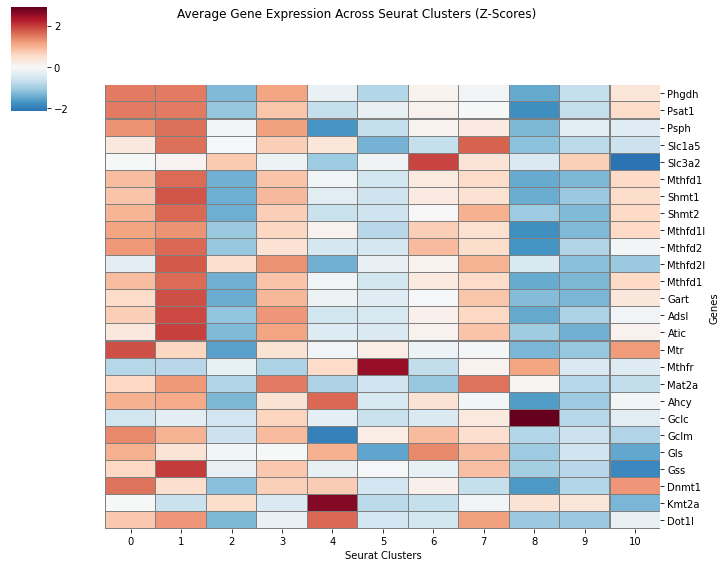

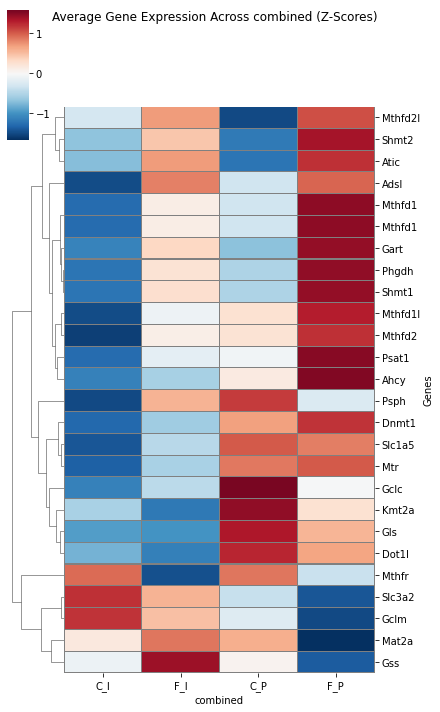

In [54]:
MakeHeatmapGenes(Adata, genes = AllMetabGenes,
                 save_name = 'results/Plots/Heatmaps/Mouse_MetabolismGenes_byCluster.pdf')
MakeHeatmapGenes(Adata, genes = AllMetabGenes, groupby = 'combined', figsize = (6,10),
                 order = ['C_I', 'F_I', 'C_P', 'F_P'],
                 row_cluster=True, save_name = 'results/Plots/Heatmaps/Mouse_MetabolismGenes_byCombined.pdf')

... storing 'combined' as categorical


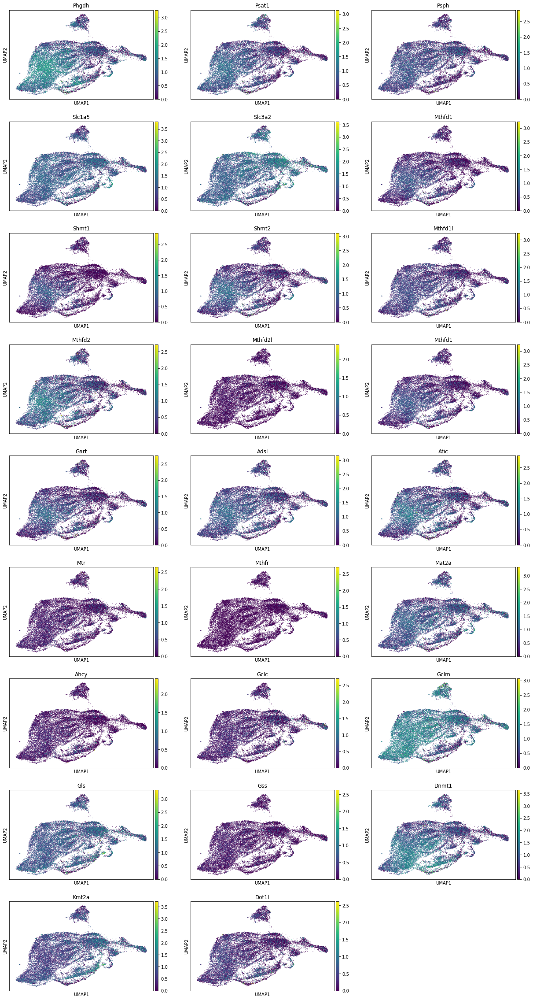

In [55]:
PlotGenesUMAP(Adata, genes = AllMetabGenes, save_name = 'results/Plots/UMAPs/Mouse_MetabolismGenes_UMAP.png')

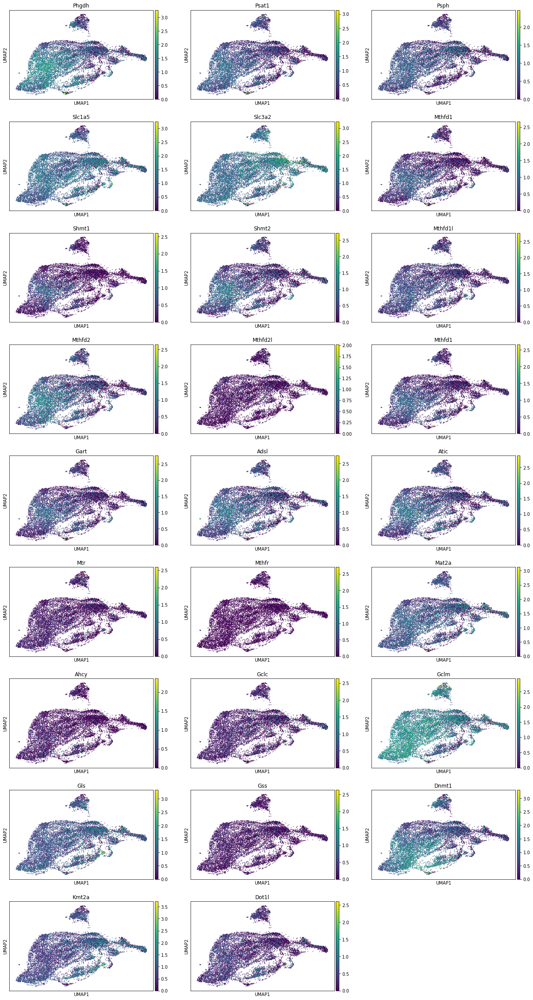

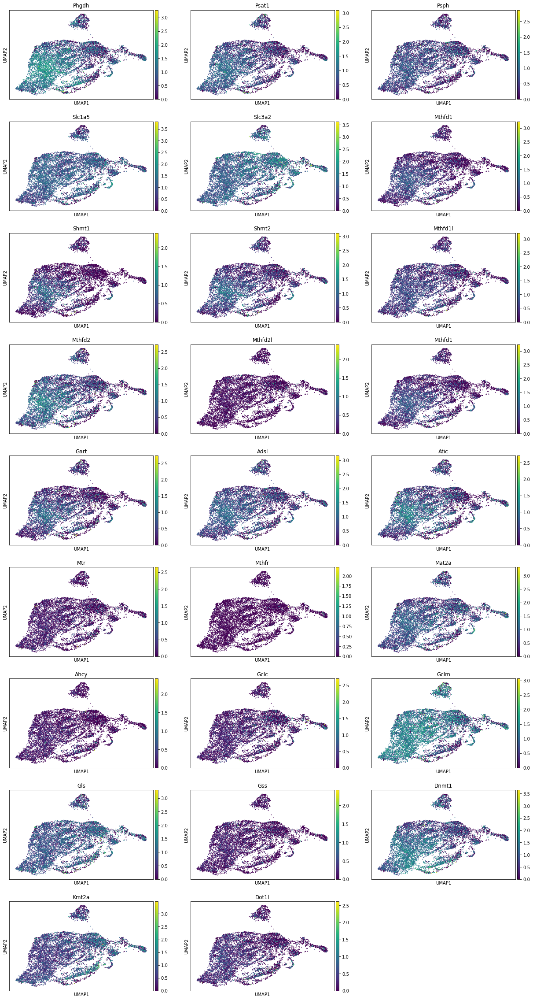

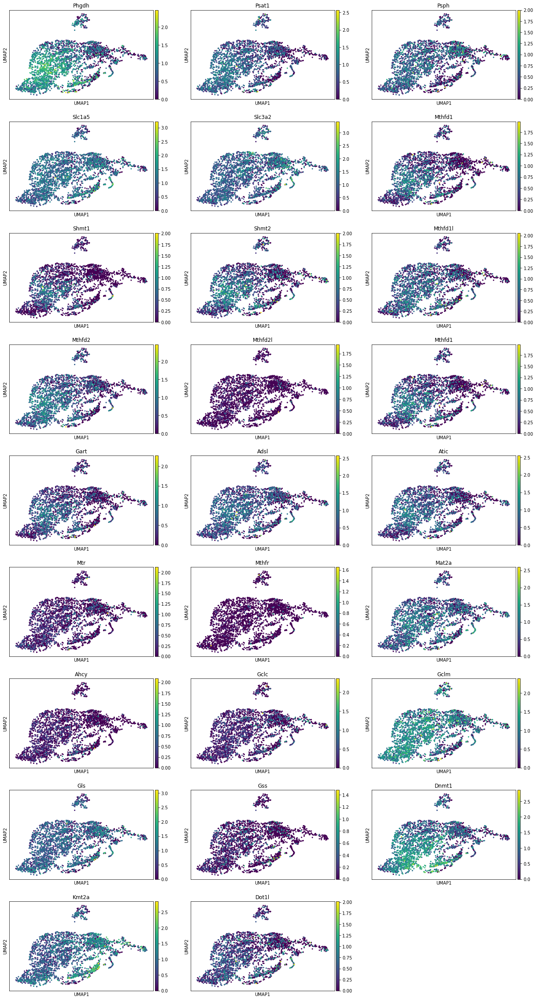

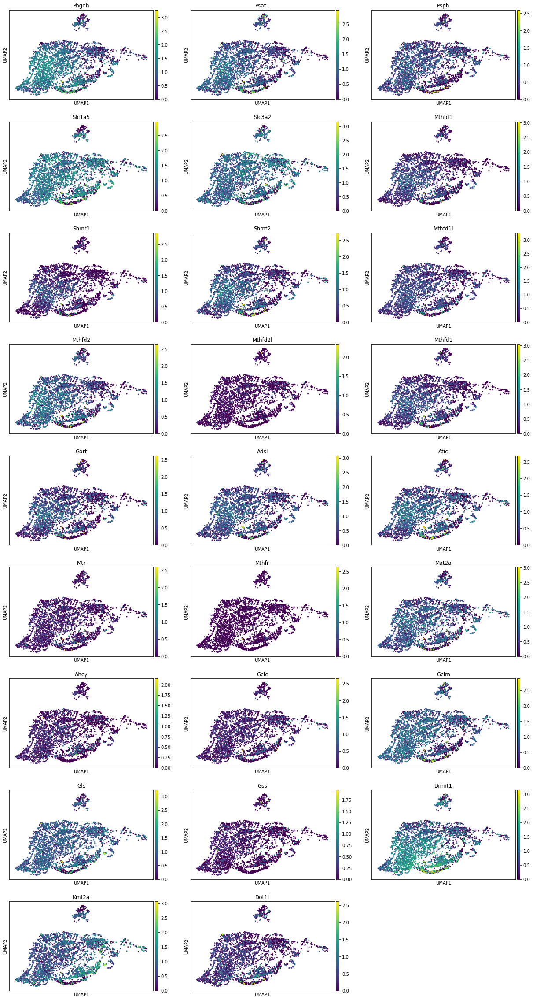

In [56]:
for mouse in Adata.obs['combined'].unique():
    PlotGenesUMAP(Adata[Adata.obs['combined'] == mouse], genes = AllMetabGenes,
                  save_name = 'results/Plots/UMAPs/{}_MetabolismGenes_UMAP.png'.format(mouse))

# Plot UMAP of Clusters

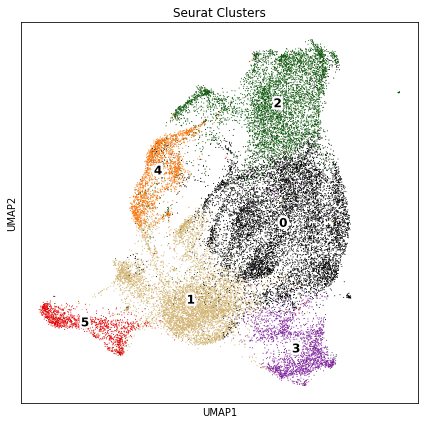

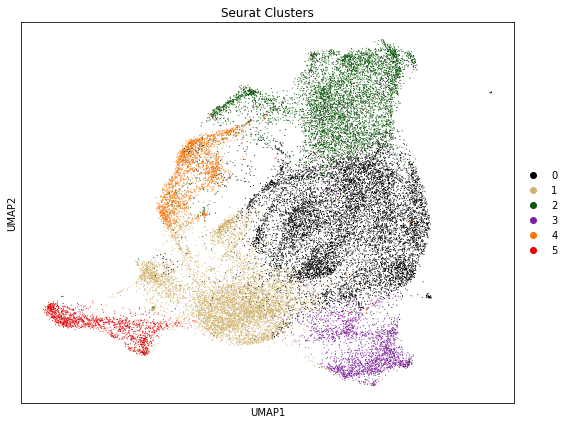

In [135]:
fig, ax = MakeFigAxes(1, 1, figsize = (6,6), single = True)
sc.pl.umap(Adata, color = 'seurat_clusters', palette = color_palette, title = 'Seurat Clusters',
           ax = ax, legend_loc = 'on data', legend_fontsize = 'large', legend_fontweight = 650,
           legend_fontoutline = 5, return_fig = False, show = False)
plt.tight_layout()
plt.savefig('results/Plots/UMAPs/UMAP_Mouse_ClustersLabeled.pdf')
plt.show()

fig, ax = MakeFigAxes(1, 1, figsize = (8,6), single = True)
sc.pl.umap(Adata, color = 'seurat_clusters', palette = color_palette, title = 'Seurat Clusters',
           ax = ax, return_fig = False, show = False)
plt.tight_layout()
plt.savefig('results/Plots/UMAPs/UMAP_Mouse_Clusters.pdf')
plt.show()

# Breakdown by Sample

In [62]:
??StackedBarPlot

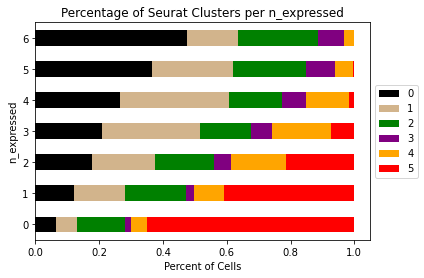

In [81]:
Adata.obs['logCloneSize'] = np.log(Adata.obs['CloneSize'])

C:\Users\Osmaan\miniconda3\envs\Jared\lib\site-packages\pandas\core\series.py:679: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


... storing 'n_expressed' as categorical


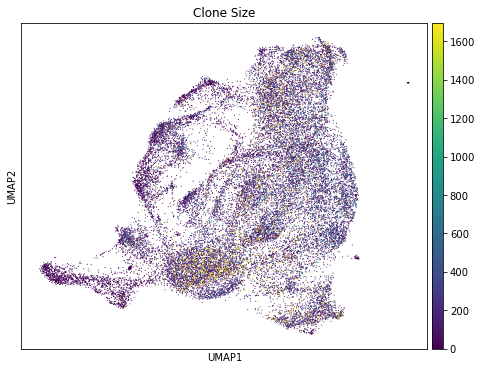

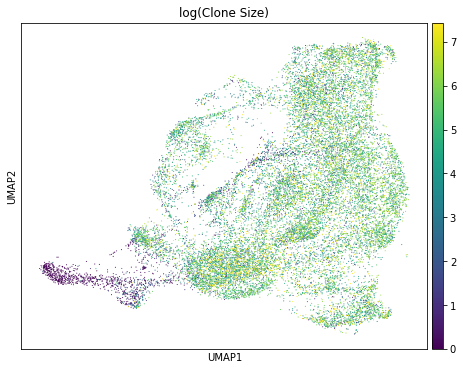

In [82]:
fig, axes = MakeFigAxes(1, 1, figsize = (8,6))
sc.pl.umap(Adata, color = 'CloneSize', title = 'Clone Size', ax = axes[0])
plt.show()

fig, axes = MakeFigAxes(1, 1, figsize = (8,6))
sc.pl.umap(Adata, color = 'logCloneSize', title = 'log(Clone Size)', ax = axes[0])
plt.show()

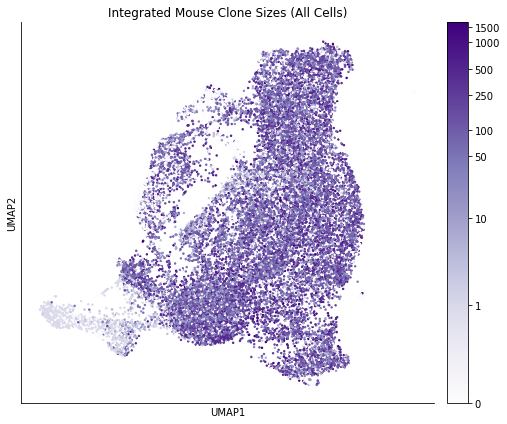

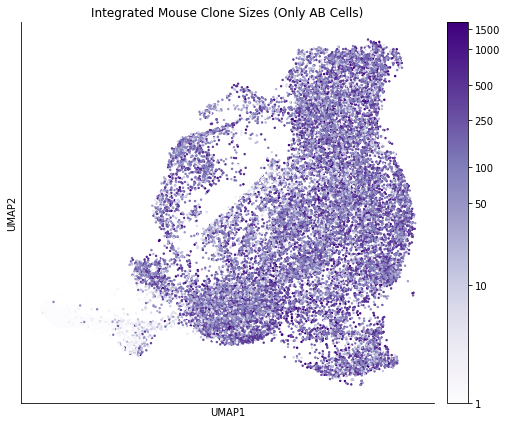

In [21]:
def PlotCloneSizes(Adata, ABcells = False, save_name = None):
    """
    PlotCloneSizes plots log10(Clone Size) for each cell in the dataset.
    Set ABcells = True to keep only cells that have both an alpha and beta chain in their TCR (alpha-beta cells).
    """
    
    # Set up the figure
    fig, axes = MakeFigAxes(1,1, figsize = (8,7))
    ax = axes[0]
    
    # Import packages
    from matplotlib.colors import SymLogNorm
    from matplotlib.ticker import ScalarFormatter
    
    # Get the data
    # If only keeping AB cells:
    if ABcells is True:
        df = KeepABcells(Adata).obs.copy()
        title = 'Integrated Mouse Clone Sizes (Only AB Cells)'
        
    # Otherwise keep all cells
    else:
        df = Adata.obs.copy()
        title = 'Integrated Mouse Clone Sizes (All Cells)'
        
    # Get the minimum and maximum clone sizes
    min_df = df['CloneSize'].min()
    max_df = df['CloneSize'].max()

    # Make the scatterplot, using the symmetric log (linear from 0 to 1, log values greater than 1)
    im = ax.scatter(x = df['UMAP_1'], y = df['UMAP_2'], c = df['CloneSize'],
                    cmap = 'Purples', s = 2, norm = SymLogNorm(1, vmin = min_df, vmax = max_df, base = 10))

    # Add a colorbar, and choose which ticks to plot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.18)
    cbar = fig.colorbar(im, cax = cax, format = ScalarFormatter(),
                        ticks = [0, 1, 10, 50, 100, 250, 500, 1000, 1500])

    # Adjust the axes
    ax.set_xlabel('UMAP1')
    ax.set_ylabel('UMAP2')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_title(title)
    if save_name is not None:
        plt.savefig(save_name)
    plt.show()
    return

PlotCloneSizes(Adata, ABcells = False, save_name = 'results/Plots/UMAPs/CloneSizesAllCells.png')
PlotCloneSizes(Adata, ABcells = True, save_name = 'results/Plots/UMAPs/CloneSizesABCells.png')

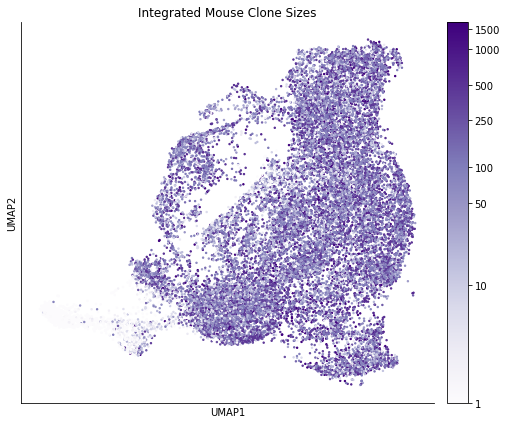

In [18]:
def PlotCloneSizes(Adata, save_name = None):
    """
    PlotCloneSizes plots log10(Clone Size) for each cell in the dataset.
    """
    
    # Set up the figure
    fig, axes = MakeFigAxes(1,1, figsize = (8,7))
    ax = axes[0]
    
    # Import packages
    from matplotlib.colors import SymLogNorm
    from matplotlib.ticker import ScalarFormatter
    
    # Get the data
    df = KeepABcells(Adata).obs.copy()
    #df['CloneSize'] = np.log10(df['CloneSize'])
    min_df = df['CloneSize'].min()
    max_df = df['CloneSize'].max()

    # Make the scatterplot, using the symmetric log (linear from 0 to 1, log values greater than 1)
    im = ax.scatter(x = df['UMAP_1'], y = df['UMAP_2'], c = df['CloneSize'],
                    cmap = 'Purples', s = 2, norm = SymLogNorm(1, vmin = min_df, vmax = max_df, base = 10))

    # Add a colorbar, and choose which ticks to plot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.18)
    cbar = fig.colorbar(im, cax = cax, format = ScalarFormatter(),
                        ticks = [0, 1, 10, 50, 100, 250, 500, 1000, 1500])

    # Adjust the axes
    ax.set_xlabel('UMAP1')
    ax.set_ylabel('UMAP2')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_title('Integrated Mouse Clone Sizes')
    if save_name is not None:
        plt.savefig(save_name)
    plt.show()
    return

PlotCloneSizes(Adata)

# CITE-Seq Data

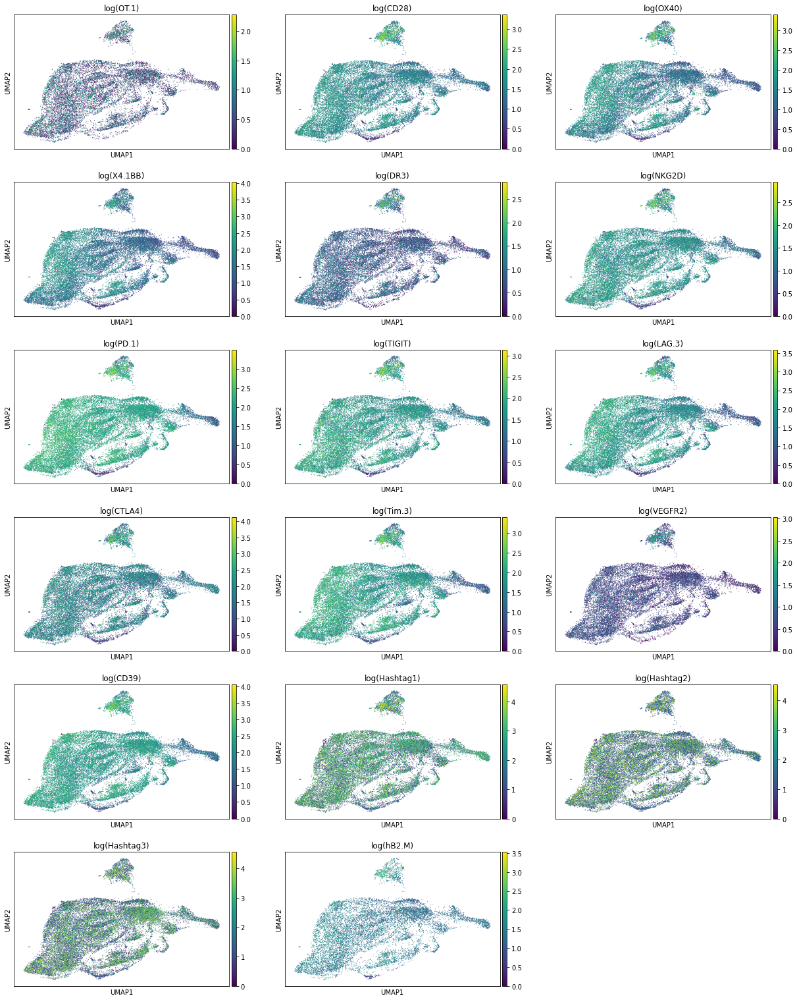

In [89]:
CITE = ['OT.1', 'CD28', 'OX40', 'X4.1BB', 'DR3', 'NKG2D', 'PD.1', 'TIGIT', 'LAG.3',
                           'CTLA4', 'Tim.3', 'VEGFR2', 'CD39', 'Hashtag1', 'Hashtag2', 'Hashtag3', 'hB2.M']
logCITE = ['log({})'.format(x) for x in CITE]

for i in range(len(logCITE)):
    Adata.obs[logCITE[i]] = np.log10(Adata.obs[CITE[i]])


sc.pl.umap(Adata, color = logCITE, ncols = 3)

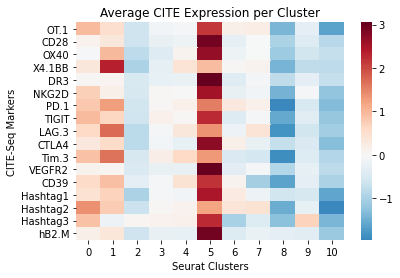

In [90]:
df = Adata.obs.groupby('seurat_clusters').mean()[CITE]
df = pd.DataFrame(index = df.index, columns = df.columns, data = scipy.stats.zscore(df, axis = 0))
ax = sns.heatmap(df.T, cmap = 'RdBu_r', center = 0)
ax.set_ylabel('CITE-Seq Markers')
ax.set_xlabel('Seurat Clusters')
ax.set_title('Average CITE Expression per Cluster')
plt.show()

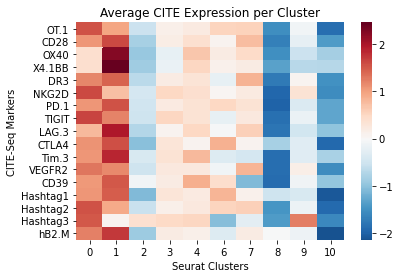

In [95]:
df = Adata[~Adata.obs['seurat_clusters'].isin([5])].obs.groupby('seurat_clusters').mean()[CITE]
df = pd.DataFrame(index = df.index, columns = df.columns, data = scipy.stats.zscore(df, axis = 0))
ax = sns.heatmap(df.T, cmap = 'RdBu_r', center = 0)
ax.set_ylabel('CITE-Seq Markers')
ax.set_xlabel('Seurat Clusters')
ax.set_title('Average CITE Expression per Cluster')
plt.show()

# Plot Genes on UMAP

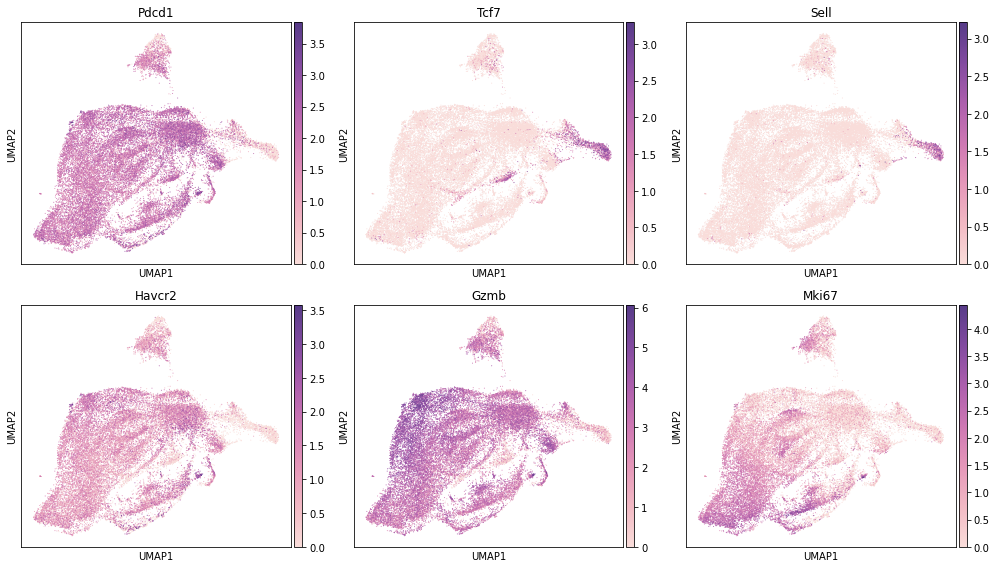

In [96]:
genes = ['Pdcd1', 'Tcf7', 'Sell', 'Havcr2', 'Gzmb', 'Mki67']

# Initialize figure
fig, axes = MakeFigAxes(ncols = 3, n_axes = 6, figsize = (14,8))

for i,gene in enumerate(genes):
    ax = axes.flatten()[i]
    sc.pl.umap(Adata, color = gene, cmap = PurpOr_7.mpl_colormap, ncols = 3, ax = ax, show = False,
               return_fig = False)

plt.tight_layout()
plt.show()

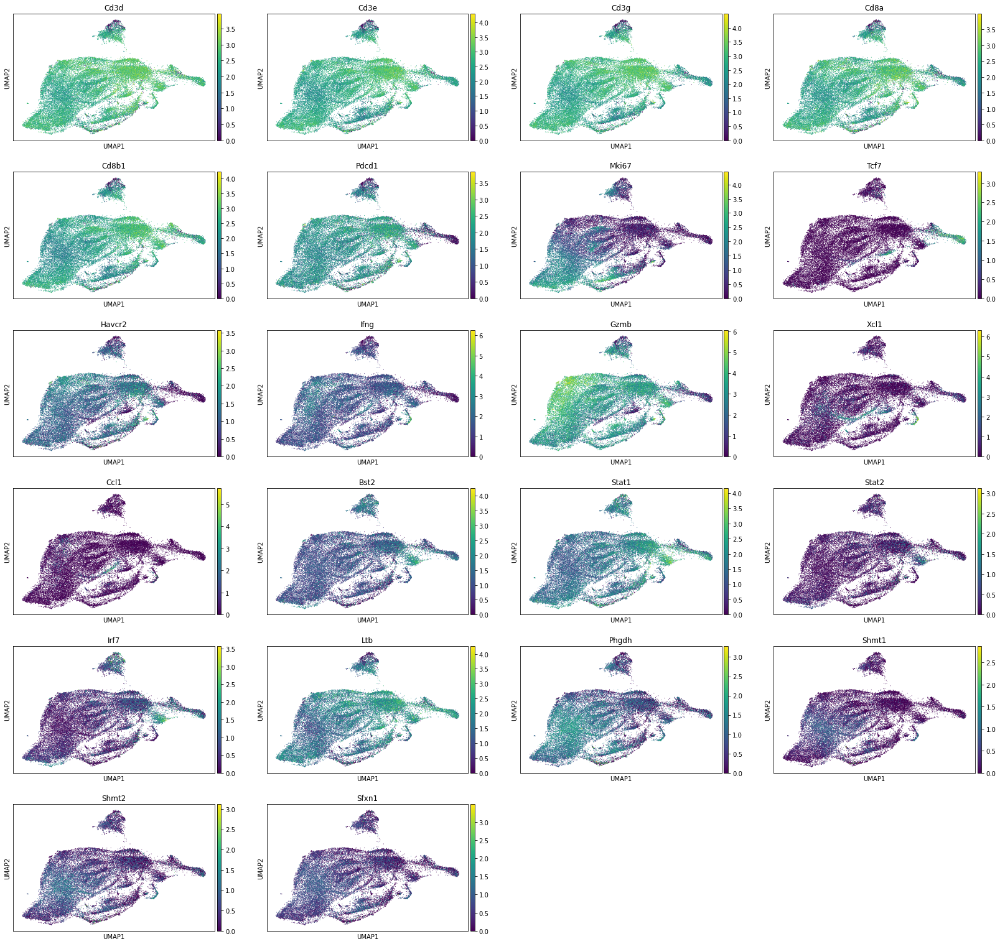

In [59]:
# Plot a set of genes
gene_list1 = ['Cd3d','Cd3e','Cd3g','Cd8a','Cd8b1','Cd4','Pdcd1','Foxp3',
              'Mki67','Klra1','Klrb1','Tcf7','Havcr2','Ifng','Gzmb',
              'Xcl1', 'Ccl1', 'Mx1', 'Bst2', 'Stat1', 'Stat2', 'Irf7', 'Ltb',
              'Phgdh', 'Shmt1', 'Shmt2', 'Sfxn1']

PlotGenesUMAP(Adata, genes = gene_list1, ncols = 4, save_name = 'results/Plots/UMAPs/UMAP_GeneList1.pdf')

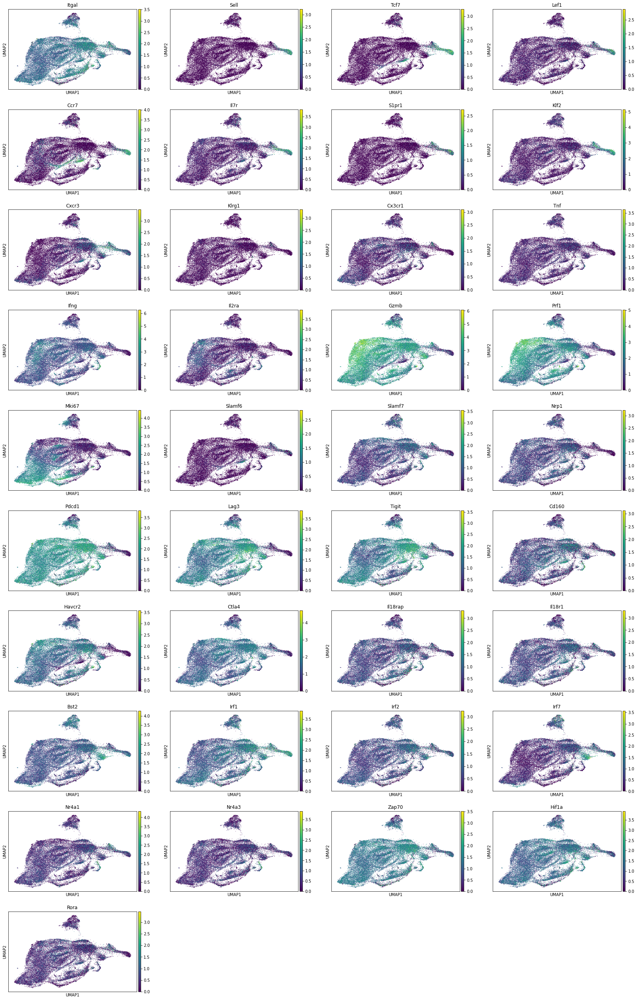

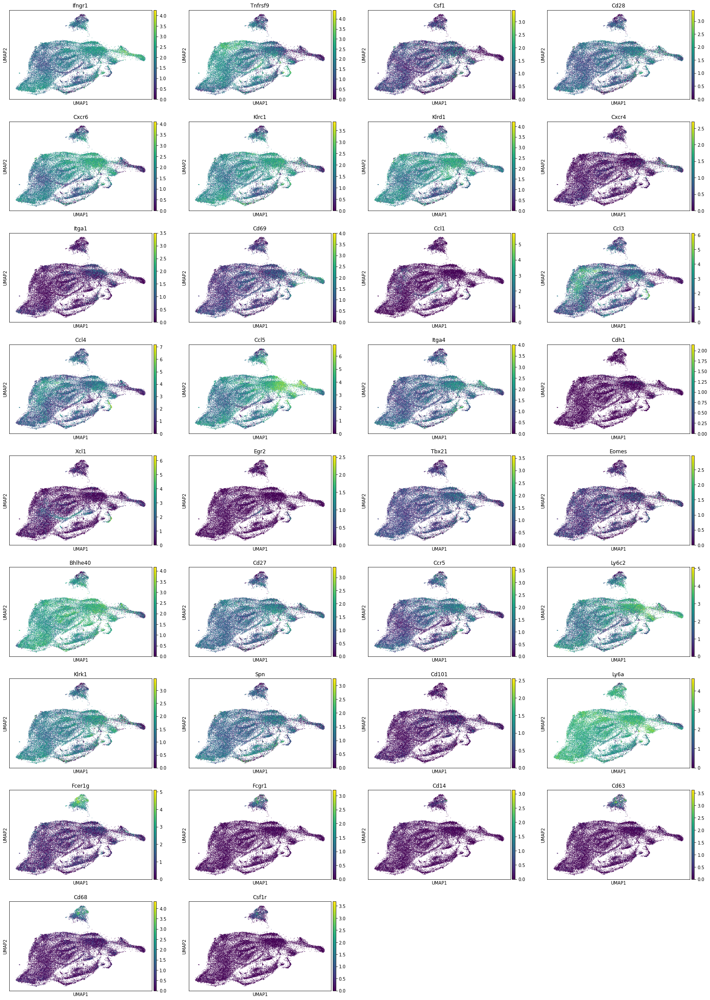

In [97]:
# Plot a set of genes
gene_list2 = ['Itgal', 'Sell', 'Tcf7', 'Lef1', 'Ccr7', 'Il7r', 'S1pr1', 'Klf2', 'Cxcr3', 'Klrg1', 'Cx3cr1',
              'S1pr5', 'Tnf', 'Ifng', 'Il2ra', 'Gzmb', 'Prf1', 'Mki67', 'Slamf6', 'Slamf7', 'Nrp1',
              'Pdcd1', 'Lag3', 'Tigit', 'Cd160', 'Havcr2', 'Ctla4', 'Cd244', 'Il18rap', 'Il18r1', 'Bst2',
              'Irf1', 'Irf2', 'Irf7', 'Mx1', 'Nr4a1', 'Nr4a3', 'Zap70', 'Hif1a', 'Rora', 'Ifngr1', 'Tnfrsf9',
              'Csf1', 'Cd28', 'Cd95', 'Ccr6', 'Rorc', 'Cxcr6', 'Klrc1', 'Klrd1', 'Cxcr4', 'Itga1', 'Itgae',
              'Cd69', 'Ccl1', 'Ccl3', 'Ccl4', 'Ccl5', 'Cxcr5', 'Itga4', 'Cdh1', 'Xcl1', 'Egr2', 'Tbx21',
              'Eomes', 'Bhlhe40', 'Cd27', 'Ccr5', 'Ly6c2', 'Klrk1', 'Spn', 'Cd101', 'Ly6a', 'Fcer1g', 'Fcgr1',
              'Cd14', 'Cd15', 'Cd16', 'Cd63', 'Cd64', 'Cd163', 'Cd68', 'Csf1r']

# Split gene list in half
PlotGenesUMAP(Adata, genes = gene_list2[:40], ncols = 4, save_name = 'results/Plots/UMAPs/UMAP_GeneList2a.png')
PlotGenesUMAP(Adata, genes = gene_list2[40:], ncols = 4, save_name = 'results/Plots/UMAPs/UMAP_GeneList2b.png')

# Violin Plots of Genes

In [99]:
def ViolinPlotGenes(Adata, gene_list, groupby = 'sample', order = None, palette = sample_palette,
                    figsize = (10,5), save_name = None):
    """
    Plot genes on a violin plot, separated by the groupby variable.
    """
    
    # Make sure the input is a gene list
    if not isinstance(gene_list, list):
        gene_list = [gene_list]
    
    # Make sure genes are in the data object
    gene_list = IntersectionOfGenes(Adata, gene_list)
    
    if len(gene_list) == 0:
        print("Genes not in Adata object.")
        return None
    
    # Keep the metadata
    df = Adata.obs.copy()
    
    # Make figure and axes
    # Number of axes/subplots is equal to number of gene lists
    # Number of columns is default to 3, unless there are fewer than 3 gene lists
    n_axes = len(gene_list)
    ncols = min(3, n_axes)
    fig, axes = MakeFigAxes(ncols = ncols, n_axes = n_axes, figsize = figsize)  
    
    # Formalize sample names
    df[groupby] = df[groupby].apply(Formalize)
        
    # Loop over each gene
    for i,gene in enumerate(gene_list):
        
        # Get the ith axis
        ax = axes.flatten()[i]
        
        # Add the gene to the metadata
        df[gene] = Adata.obs_vector(gene)
        
        # Make the violin plot
        sns.violinplot(x = groupby, y = gene, data = df, ax = ax, palette = palette,
                           scale = 'width', cut = 0, order = order)
        
        # Add the title of the gene
        ax.set_title(gene)
        ax.set_ylabel('Log$_{10}$(norm. counts)')
        ax.set_xlabel(Formalize(groupby))
        
    plt.tight_layout()
    if save_name is not None:
        plt.savefig(save_name)
    plt.show()
    return

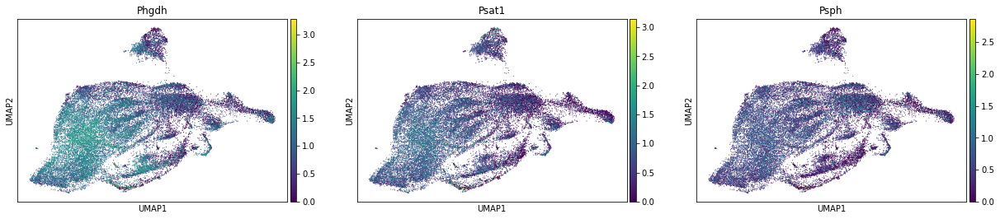

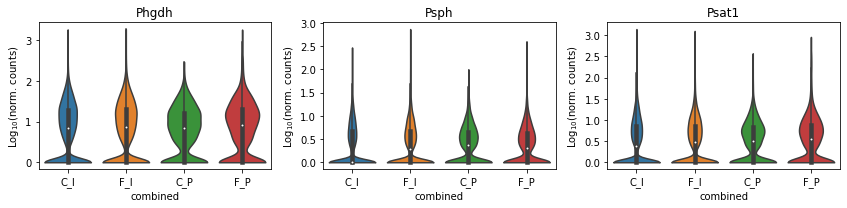

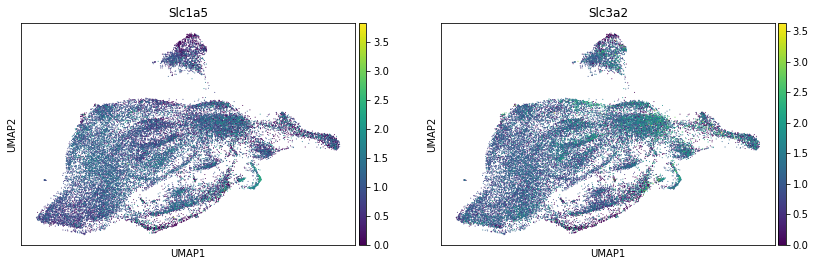

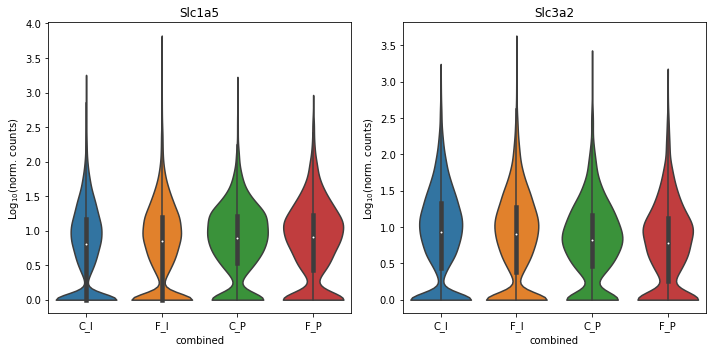

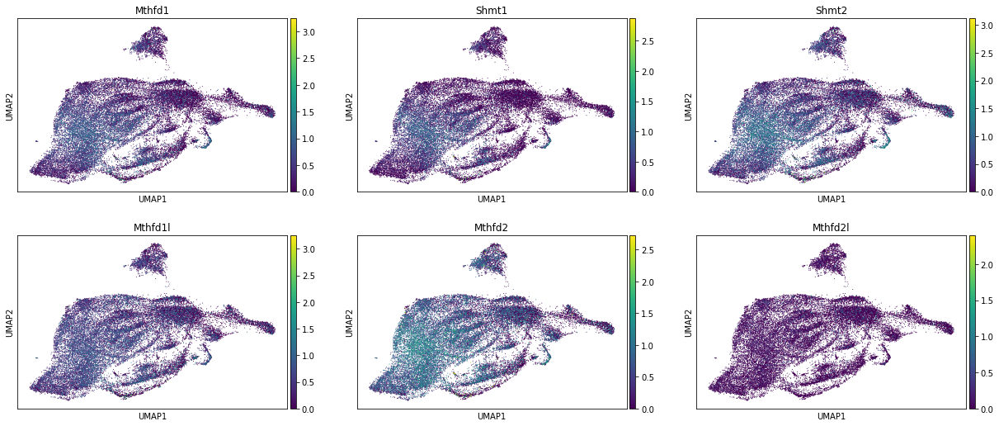

...

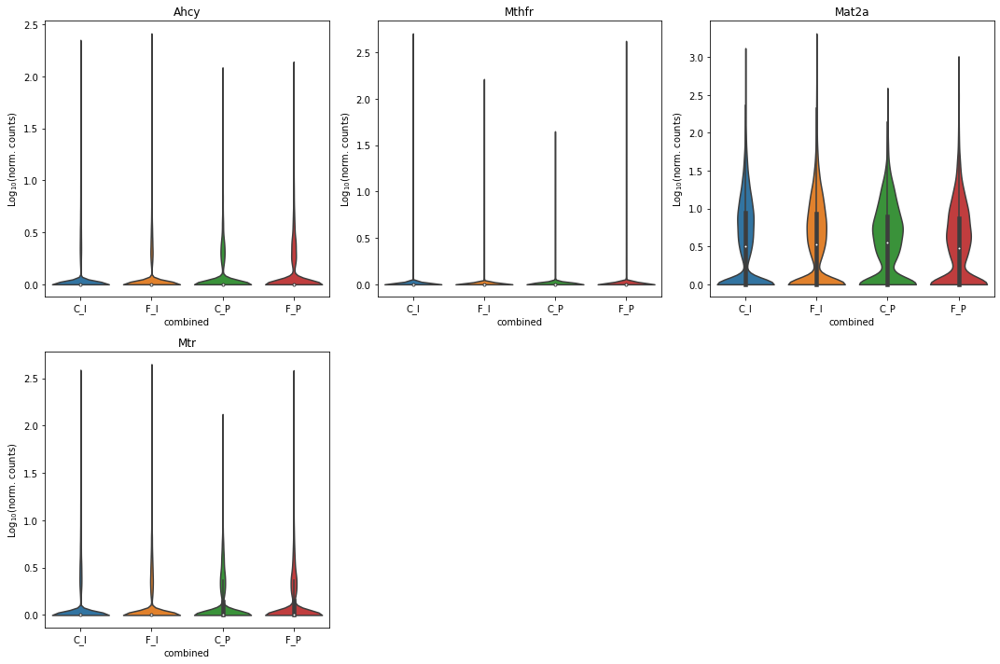

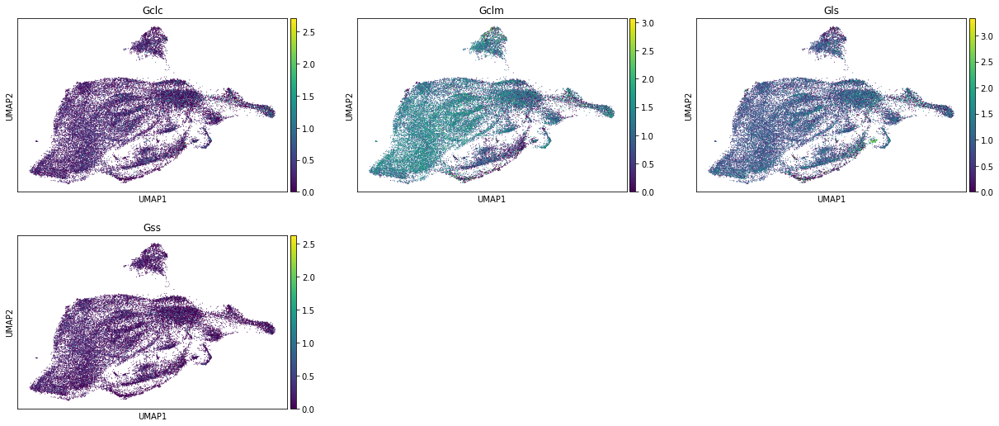

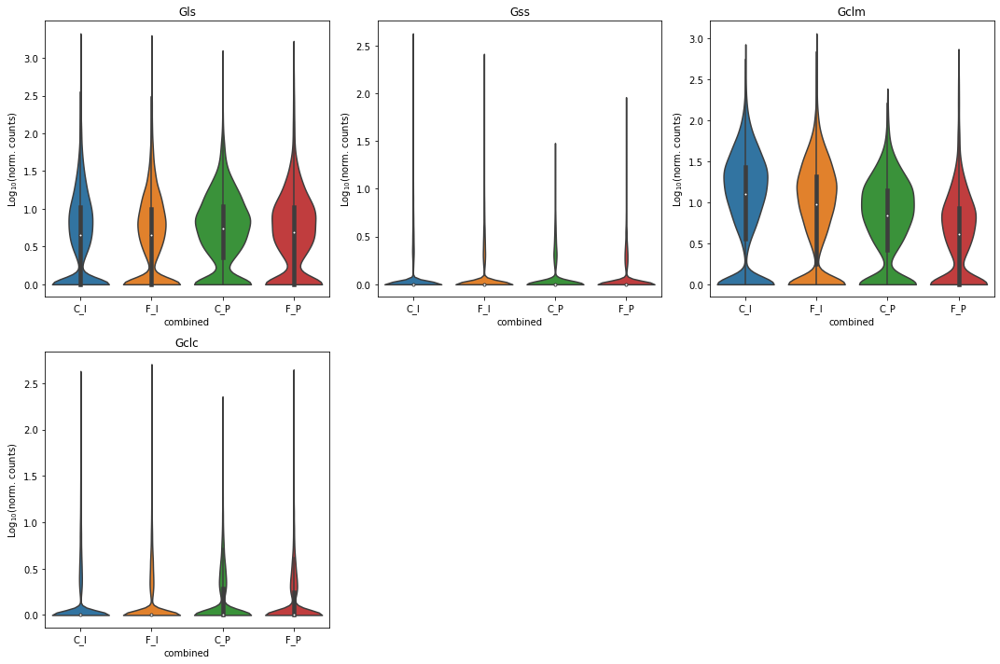

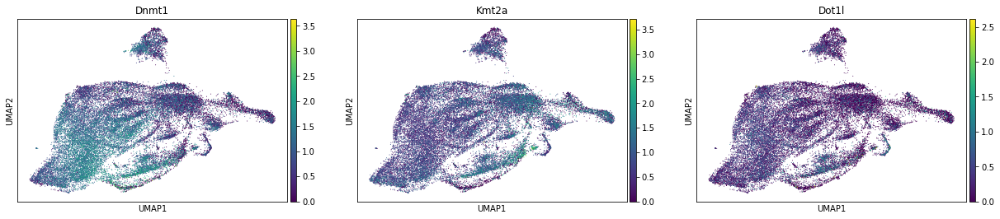

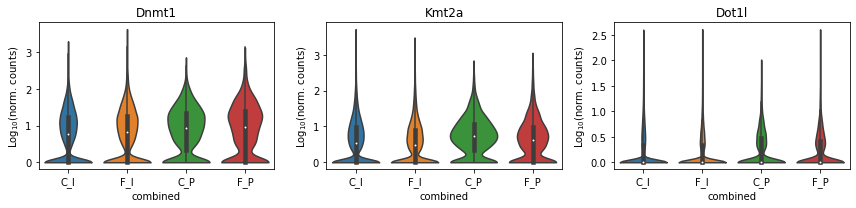

In [100]:
gene_lists, gene_names = CheckGeneLists(gene_dict = metabolism)
figsizes = [(12,3), (10,5), (15,10), (15,10), (15,10), (15,10), (12,3)]

for i,(gene_list, gene_name) in enumerate(zip(gene_lists,gene_names)):
    
    # Plot the genes on the UMAP
    PlotGenesUMAP(Adata, genes = gene_list,
                  save_name = 'results/Plots/UMAPs/UMAP_{}_Genes.pdf'.format(gene_name.replace(' ', '_')))
    
    # Make a violin plot
    ViolinPlotGenes(Adata, gene_list = gene_list, groupby = 'combined', order = ['C_I', 'F_I', 'C_P', 'F_P'],
                    figsize = figsizes[i],
                    save_name = 'results/Plots/ViolinPlots/Violins_{}_Genes_byCombined.pdf'.format(gene_name.replace(' ', '_')))

# Inhibitory Receptor Analysis

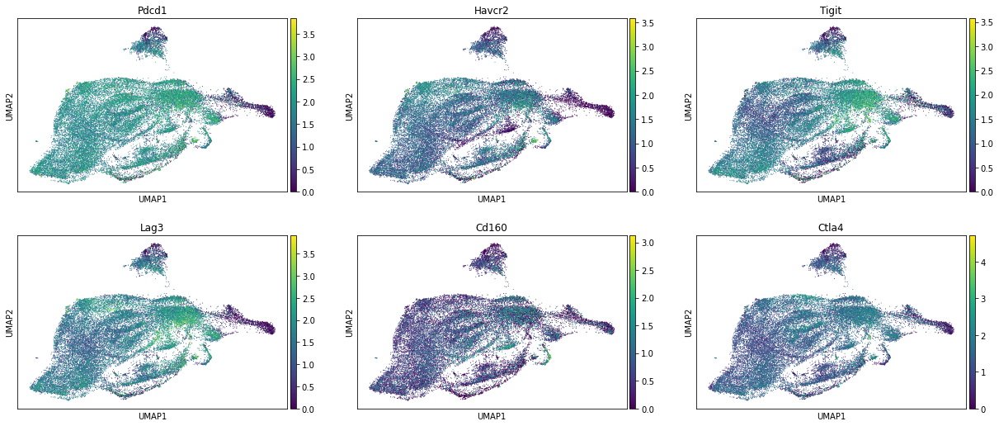

In [101]:
IRs = ['Pdcd1', 'Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4']

axes = sc.pl.umap(Adata, color = IRs, show = False, return_fig = True, ncols = 3)
plt.show()

In [102]:
def IR_Expression(Adata, IRs = ['Pdcd1', 'Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4'],
                  target_col = 'seurat_clusters',
                  figsize = (10,8), groupby = None, autopct = '%1.1f%%', palette = None,
                  save1 = None, save2 = None, save3 = None, save4 = None):
    """
    Given a set of inhibitory receptors (IRs), plot which cells have 0, 1, 2, ... or all IRs on a UMAP.
    """
    
    # Count how many IRs there are
    N = len(IRs)
    
    # Make a copy of the data
    data = Adata.copy()
    
    # For each cell, count how many IRs are expressed
    # Cells express IRs if their counts are greater than 0
    data.obs['n_expressed'] = np.count_nonzero(Adata[:, IRs].X, axis=1)

    # Save as categorical data
    data.obs['n_expressed'] = data.obs['n_expressed'].astype('category')
    
    # Plot all cells on a single UMAP
    fig, axes = MakeFigAxes(ncols = 1, n_axes = 1)
    
    # Create the color palette for plotting
    if N == 5:
        from palettable.cartocolors.sequential import DarkMint_6
        palette = DarkMint_6.mpl_colors
    else:
        from palettable.cartocolors.sequential import DarkMint_7
        palette = DarkMint_7.mpl_colors
    
    sns.scatterplot(data = data.obs, x = 'UMAP_1', y = 'UMAP_2', hue = 'n_expressed', linewidth = 0,
                    hue_order = data.obs['n_expressed'].cat.categories, ax = axes[0],
                    s = 2, palette = palette)
    axes[0].set_title('Number of IRs Expressed Per Cell')
    
    # Save figure
    if save1 is not None:
        plt.savefig(save1)
        
    plt.show()
    
    # Plot cells on separate UMAPs
    fig, axes = MakeFigAxes(ncols = 3, n_axes = N + 1, figsize = figsize)
    for i,group in enumerate(range(N+1)):
        
        ax = axes.flatten()[i]
        sc.pl.umap(data, color = 'n_expressed', groups = [group], ax = ax, show = False, palette = palette,
                   title = '{} IRs Expressed'.format(i), legend_loc = None)
        
    plt.tight_layout()
    
    # Save figure
    if save2 is not None:
        plt.savefig(save2)
    plt.show()    
    
    # Make a pie chart
    if groupby is not None:
        
        fig, axes = MakeFigAxes(ncols = 2, n_axes = 2, figsize = (10,8))
        for i,group in enumerate(data.obs[groupby].unique()):
            
            dat = data[data.obs[groupby] == group]
            df = dat.obs['n_expressed'].value_counts().sort_index()
            df.plot(kind = 'pie', autopct = autopct, colors = palette, ax = axes[i], startangle = 90)
            axes[i].set_title('Number of IRs Expressed ({})'.format(group))
    
    else:
        df = data.obs['n_expressed'].value_counts().sort_index()
        ax = df.plot(kind = 'pie', autopct='%1.1f%%', colors = palette, startangle = 90)
        ax.set_title('Number of IRs Expressed')
    
    # Save figure
    if save3 is not None:
        plt.savefig(save3)        
    plt.show()
    
    # Make a stacked bar plot of IRs expressed per cluster
    if groupby is not None:

        fig, axes = MakeFigAxes(ncols = 2, n_axes = 2, figsize = (10,4))
        for i,group in enumerate(data.obs[groupby].unique()):
            
            dat = data[data.obs[groupby] == group]

            # Make a the plot, after splitting by PD1
            table = pd.crosstab(dat.obs[target_col], dat.obs['n_expressed'])
            table = table / table.sum(axis=1)[:, None]
            table.plot(kind = 'bar', stacked = True, color = palette, ax = axes[i])
            axes[i].set_title('IR Expression per Seurat Cluster ({})'.format(group))
            axes[i].set_xlabel('Seurat Cluster')
            axes[i].set_ylabel('Percent of Cells that Express IRs')
            axes[i].legend(bbox_to_anchor = (1.18, 1))
            axes[i].set_xticklabels(axes[i].get_xticks(), rotation = 0)
            
        # Save figure
        plt.tight_layout()
        if save4 is not None:
            plt.savefig(save4)        
        plt.show()

    else:
        # Make the plot for all cells
        table = pd.crosstab(data.obs[target_col], data.obs['n_expressed'])
        table = table / table.sum(axis=1)[:, None]
        ax = table.plot(kind = 'bar', stacked = True, color = palette)
        ax.set_title('IR Expression per Seurat Cluster')
        ax.set_xlabel('Seurat Cluster')
        ax.set_ylabel('Percent of Cells that Express IRs')
        handles, labels = ax.get_legend_handles_labels()
        lgd = ax.legend(handles, labels, bbox_to_anchor = (1.18, 1))
        ax.set_xticklabels(ax.get_xticks(), rotation = 0)
        
        # Save figure
        plt.tight_layout()
        if save4 is not None:
            plt.savefig(save4, bbox_extra_artists=(lgd))       
        plt.show()
    
    return    

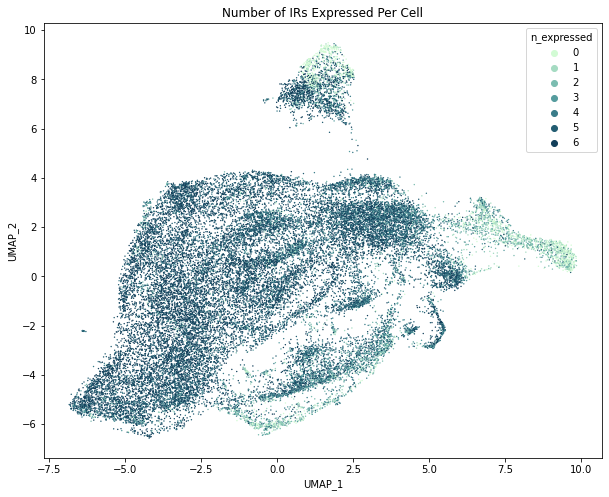

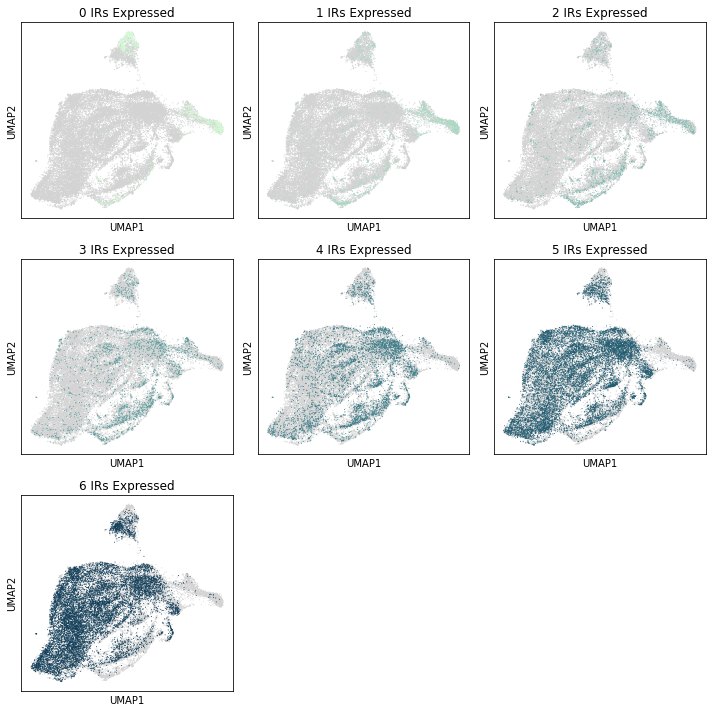

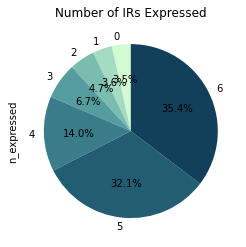

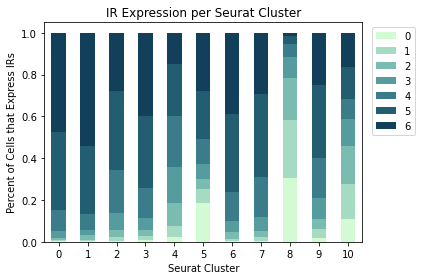

In [104]:
IR_Expression(Adata, figsize = (10,10),
              save2 = 'results/IR_Coexpression/6IRs_UMAPs.pdf',
              save4 = 'results/IR_Coexpression/6IRs_StackedBar.pdf')

# Heatmap of Gene Signatures

### Core Signatures

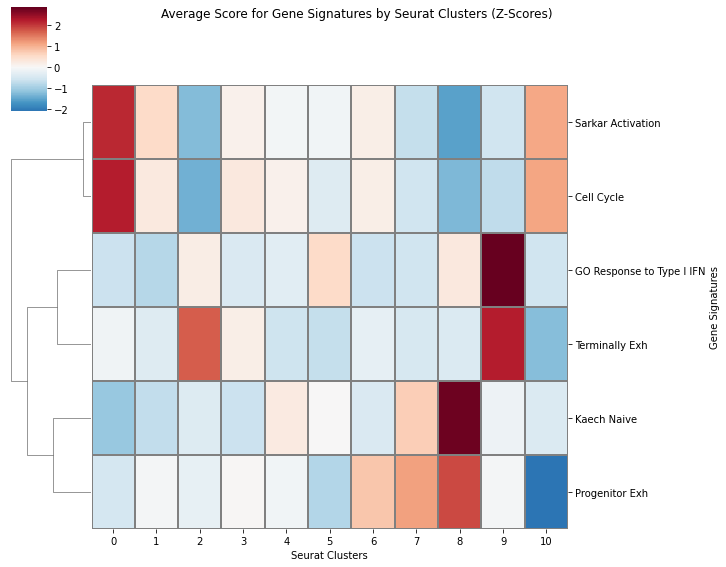

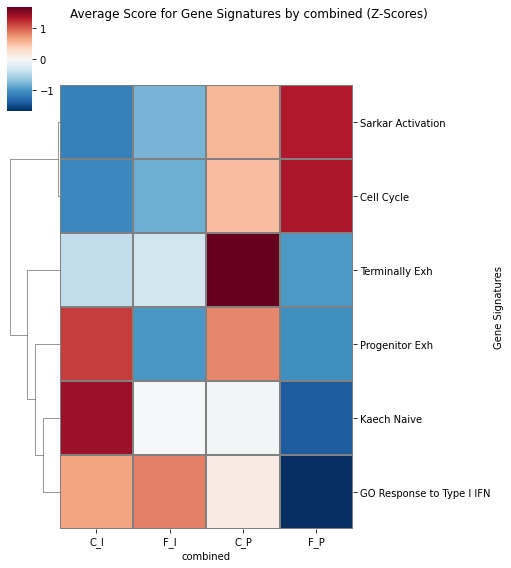

In [113]:
gene_lists = [sarkar_activation, cellcycle, kaech_naive, IFN_1, progenitorexh, terminallyexh]
gene_names = ['Sarkar Activation', 'Cell Cycle', 'Kaech Naive', 'GO Response to Type I IFN',
              'Progenitor Exh', 'Terminally Exh']

MakeHeatmapSignatures(Adata, gene_lists, gene_names, row_cluster = True,
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_CoreSigs_byCluster.pdf')

MakeHeatmapSignatures(Adata, gene_lists, gene_names, row_cluster = True, groupby = 'combined',
                      order = ['C_I', 'F_I', 'C_P', 'F_P'], figsize = (7,8),
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_CoreSigs_byCombined.pdf')

C_I


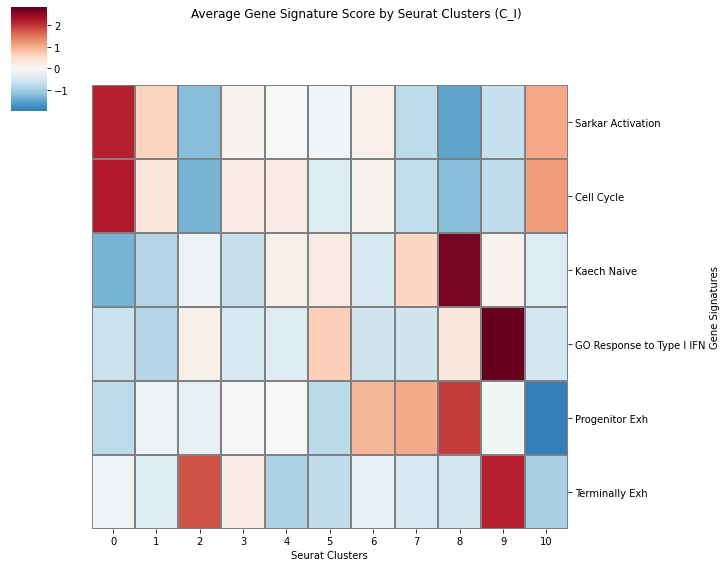

F_I


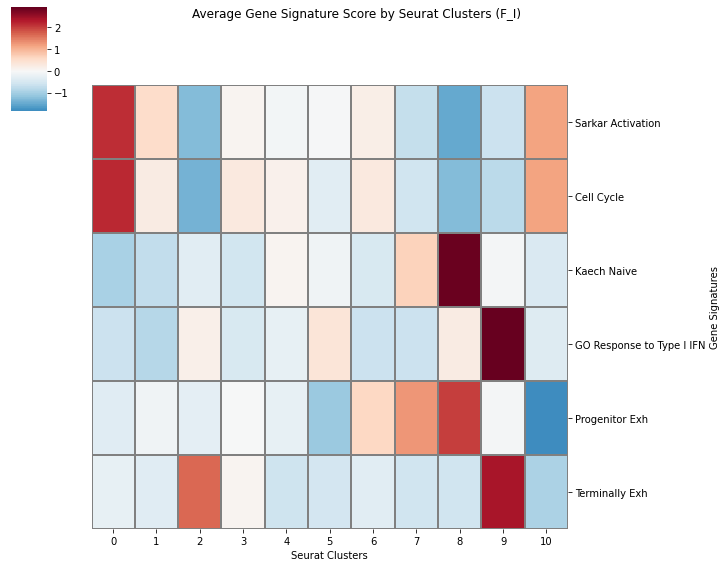

C_P


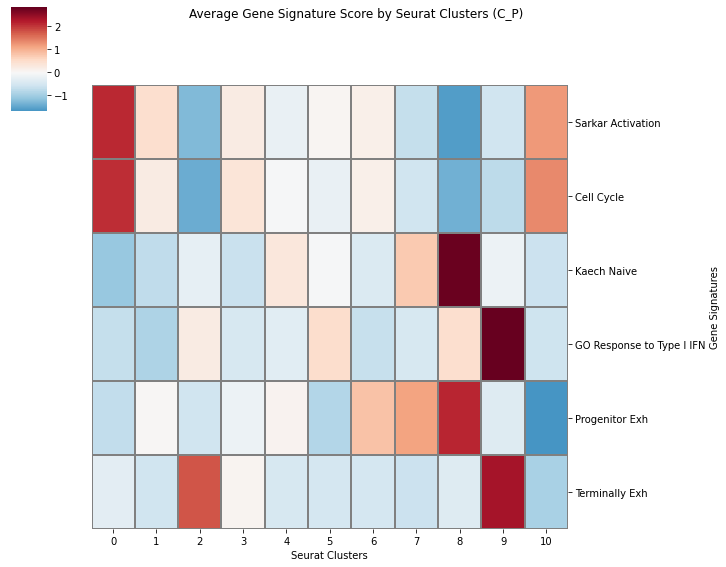

F_P


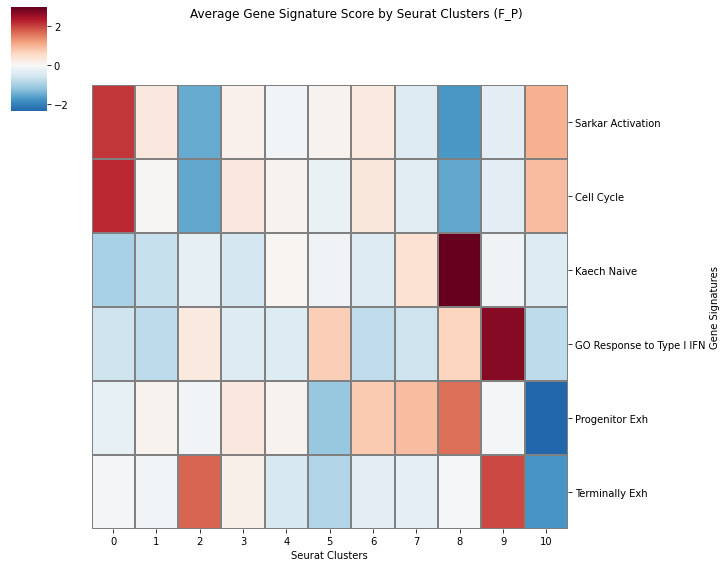

In [112]:
for group in Adata.obs['combined'].unique():
    print(group)
    MakeHeatmapSignatures(Adata[Adata.obs['combined'] == group].copy(), gene_lists, gene_names,
                          title = 'Average Gene Signature Score by Seurat Clusters ({})'.format(group),
                          save_name = 'results/Plots/GeneSignaturePlots/Heatmap_{}_CoreSigs.pdf'.format(group))

### Hallmark Signatures

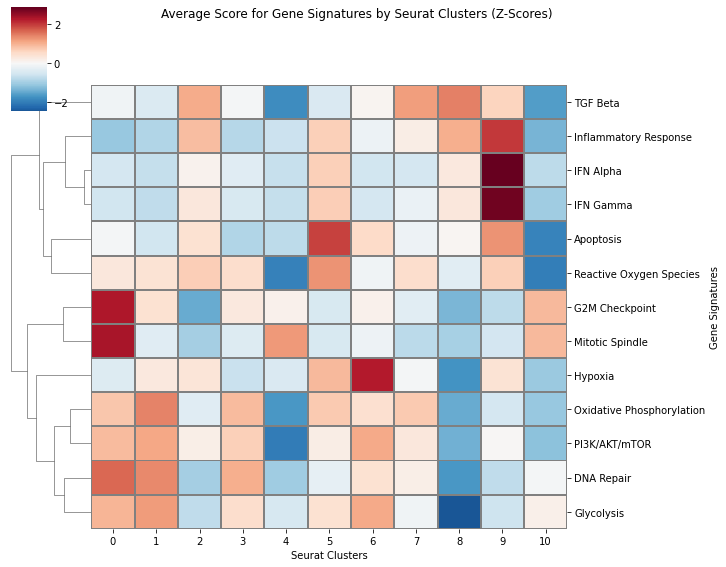

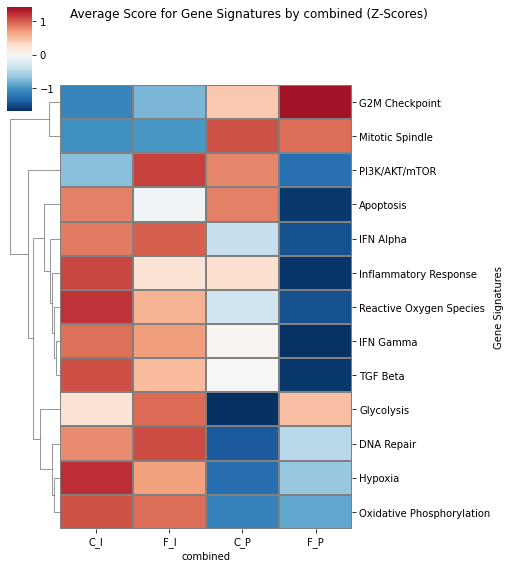

In [114]:
gene_lists = [Apoptosis, DNArepair, G2M, Glycolysis, Hypoxia, Inflamm, IFNalpha, IFNgamma, Spindle,
              Oxidative, PI3K, ROS, TGFbeta]
gene_names = ['Apoptosis', 'DNA Repair', 'G2M Checkpoint', 'Glycolysis', 'Hypoxia', 'Inflammatory Response',
              'IFN Alpha', 'IFN Gamma', 'Mitotic Spindle', 'Oxidative Phosphorylation', 'PI3K/AKT/mTOR',
              'Reactive Oxygen Species', 'TGF Beta']

MakeHeatmapSignatures(Adata, gene_lists = gene_lists, gene_lists_names = gene_names,
                      groupby = 'seurat_clusters', figsize = (10,8), row_cluster = True,
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_HallmarkSigs_byCluster.pdf')

MakeHeatmapSignatures(Adata, gene_lists = gene_lists, gene_lists_names = gene_names,
                      groupby = 'combined', figsize = (7,8), row_cluster = True,
                      order = ['C_I', 'F_I', 'C_P', 'F_P'],
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_HallmarkSigs_byCombined.pdf')

### Metabolism Signatures

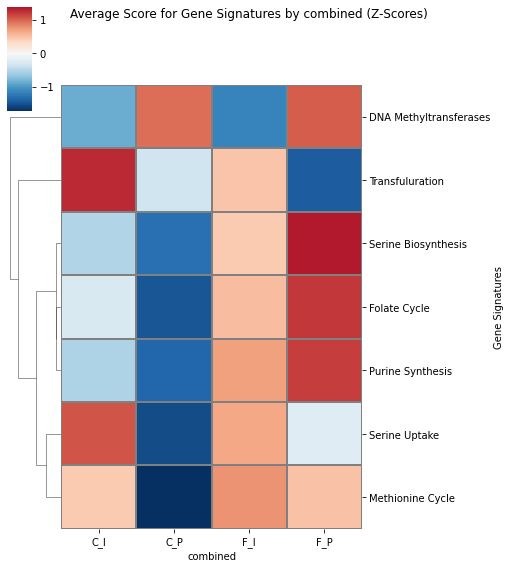

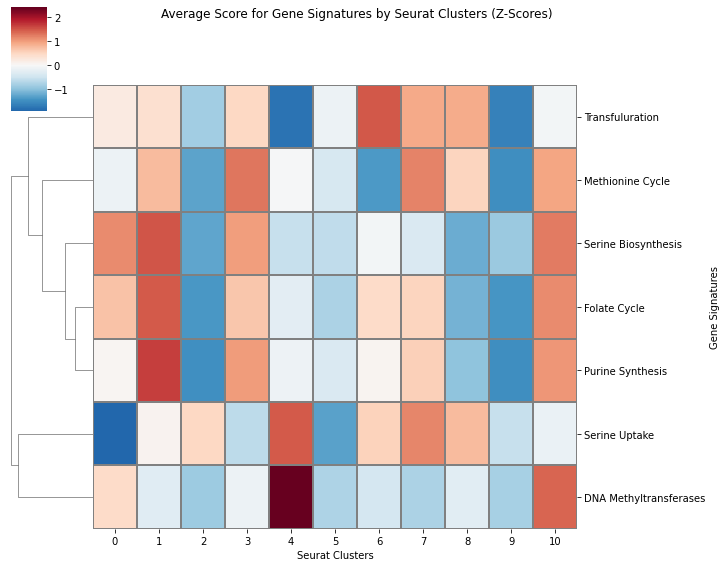

In [115]:
MakeHeatmapSignatures(Adata, gene_dict = metabolism,
                      groupby = 'combined', figsize = (7,8), row_cluster = True,
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_MetabolismSigs_byCombined.pdf')

MakeHeatmapSignatures(Adata, gene_dict = metabolism,
                      groupby = 'seurat_clusters', figsize = (10,8), row_cluster = True,
                      save_name = 'results/Plots/GeneSignaturePlots/Heatmap_MetabolismSigs_byClusters.pdf')

# Plot Gene Signatures on UMAP

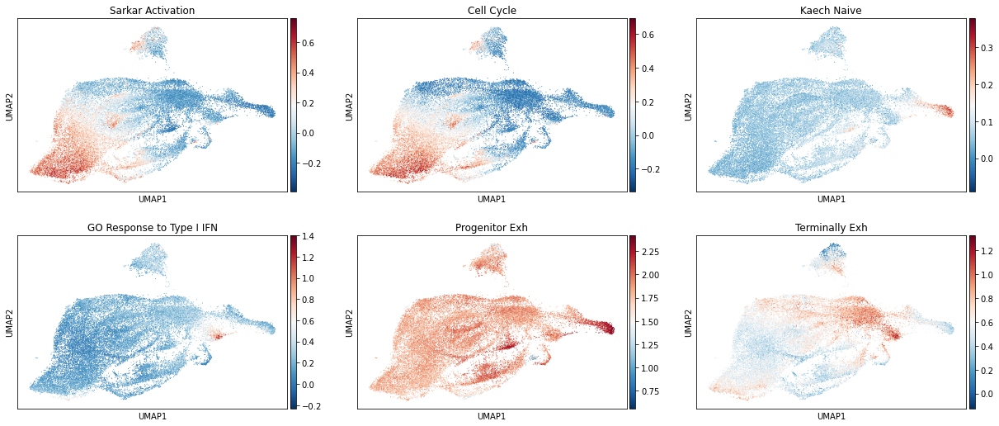

In [116]:
gene_lists = [sarkar_activation, cellcycle, kaech_naive, IFN_1, progenitorexh, terminallyexh]
gene_names = ['Sarkar Activation', 'Cell Cycle', 'Kaech Naive', 'GO Response to Type I IFN',
              'Progenitor Exh', 'Terminally Exh']

GeneSignatureUMAP(Adata, gene_lists, gene_names,
                  save_name = 'results/Plots/GeneSignaturePlots/UMAP_CoreSigs.pdf')

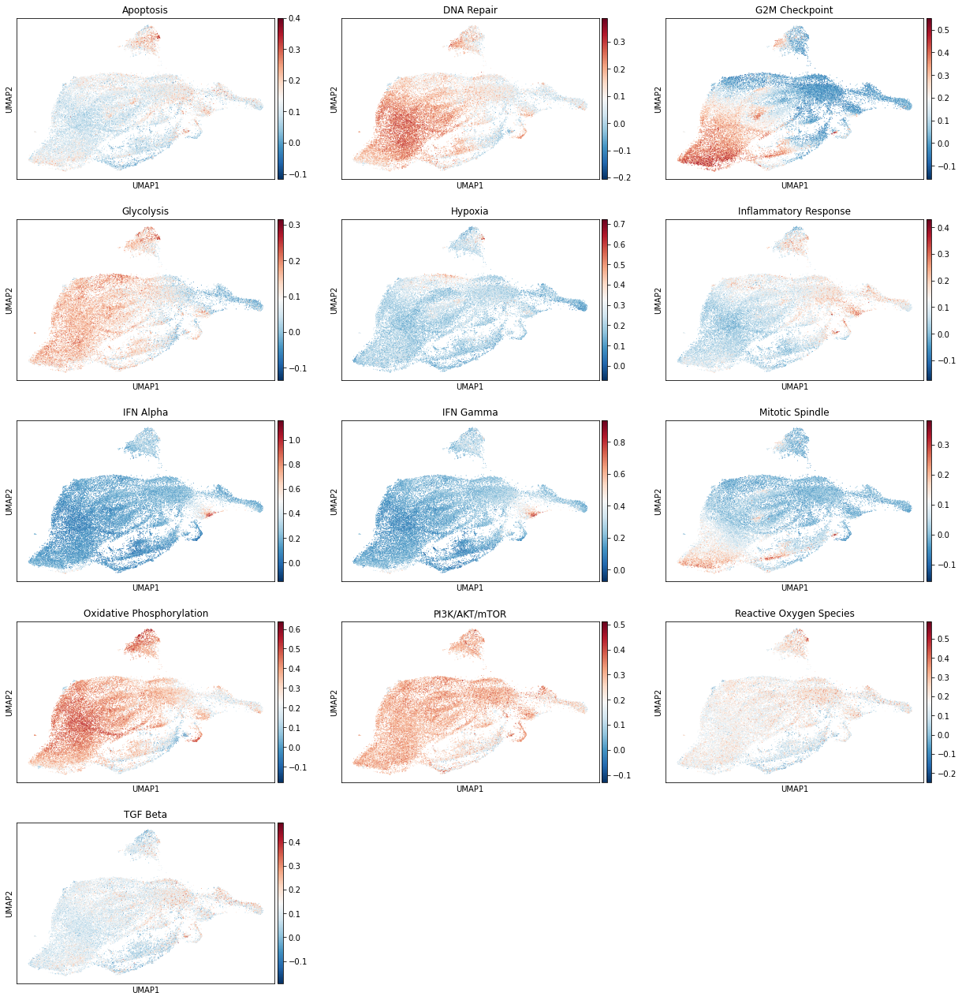

In [117]:
gene_lists = [Apoptosis, DNArepair, G2M, Glycolysis, Hypoxia, Inflamm, IFNalpha, IFNgamma, Spindle,
              Oxidative, PI3K, ROS, TGFbeta]
gene_names = ['Apoptosis', 'DNA Repair', 'G2M Checkpoint', 'Glycolysis', 'Hypoxia', 'Inflammatory Response',
              'IFN Alpha', 'IFN Gamma', 'Mitotic Spindle', 'Oxidative Phosphorylation', 'PI3K/AKT/mTOR',
              'Reactive Oxygen Species', 'TGF Beta']

GeneSignatureUMAP(Adata, gene_lists, gene_names,
                  save_name = 'results/Plots/GeneSignaturePlots/UMAP_HallmarkSigs.pdf')

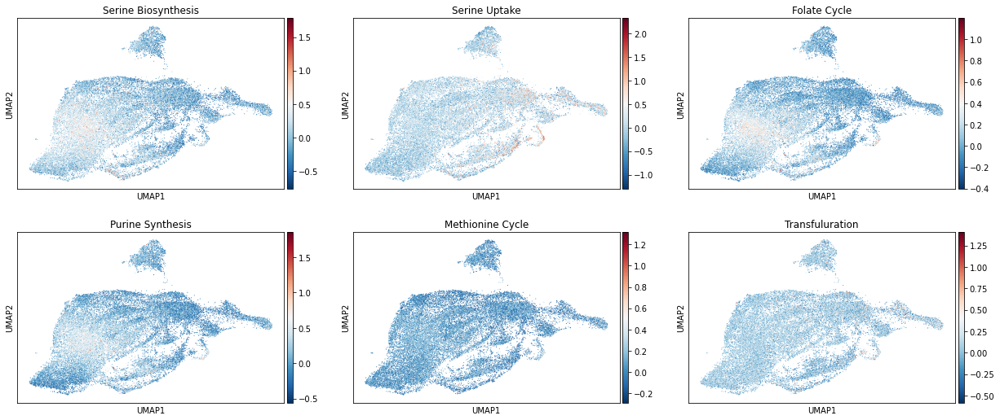

In [118]:
gene_lists = [SerineBios, SerineUpt, Folate, Purine, Methio, Transful]
gene_names = ['Serine Biosynthesis', 'Serine Uptake', 'Folate Cycle', 'Purine Synthesis',
              'Methionine Cycle', 'Transfuluration']

GeneSignatureUMAP(Adata, gene_lists, gene_names,
                  save_name = 'results/Plots/GeneSignaturePlots/UMAP_MetabolismSigs.pdf')

# Violin Plots of Gene Signatures

### Core Signatures

In [123]:
gene_lists = [sarkar_activation, cellcycle, kaech_naive, IFN_1, progenitorexh, terminallyexh]
gene_names = ['Sarkar Activation', 'Cell Cycle', 'Kaech Naive', 'GO Response to Type I IFN',
              'Progenitor Exh', 'Terminally Exh']

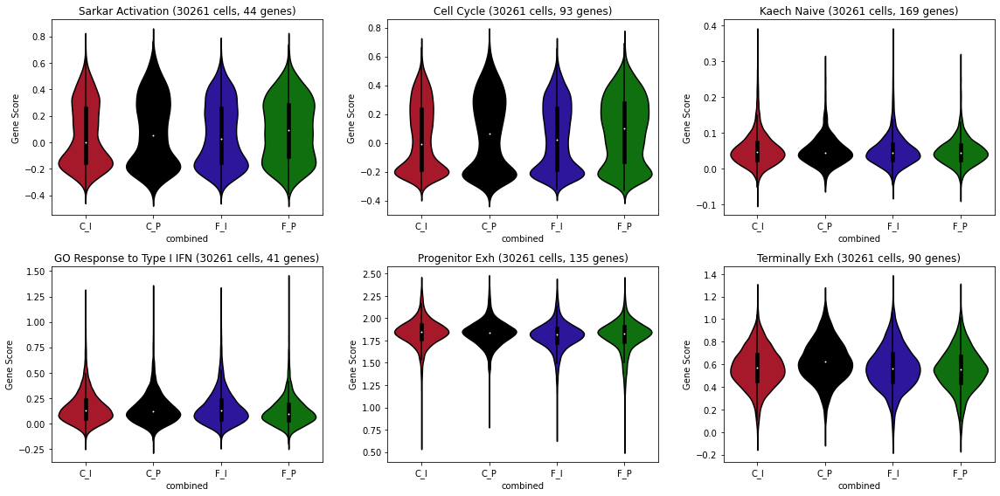

In [121]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'combined', figsize = (16,8),
                     order = ['C_I', 'C_P', 'F_I', 'F_P'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_CoreSigs_byCombined.pdf')

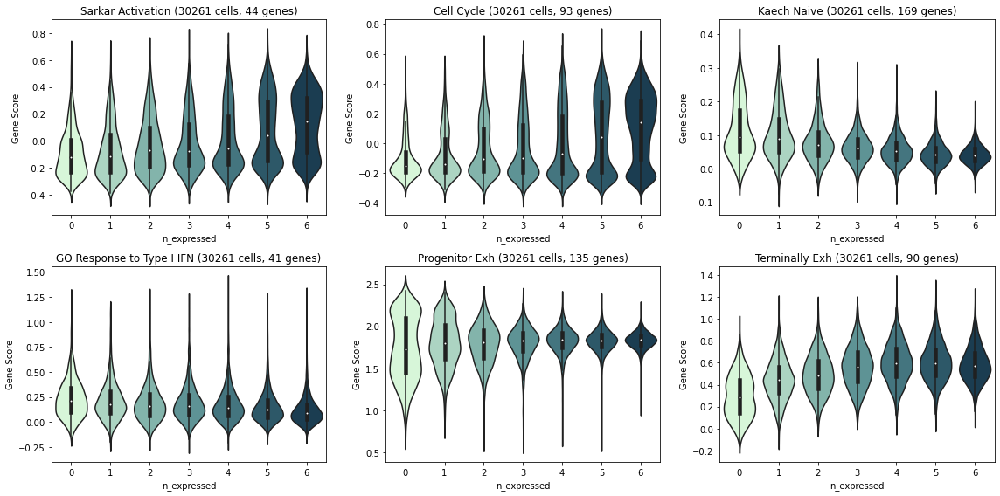

In [130]:
IRs = ['Pdcd1','Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4']
Adata.obs['n_expressed'] = np.count_nonzero(Adata[:, IRs].X, axis=1)
Adata.obs['n_expressed'] = Adata.obs['n_expressed'].astype(int)

from palettable.cartocolors.sequential import DarkMint_7

MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'n_expressed', figsize = (16,8),
                     palette = DarkMint_7.mpl_colors, order = ['0', '1', '2', '3', '4', '5', '6'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_CoreSigs_byIRs.pdf')

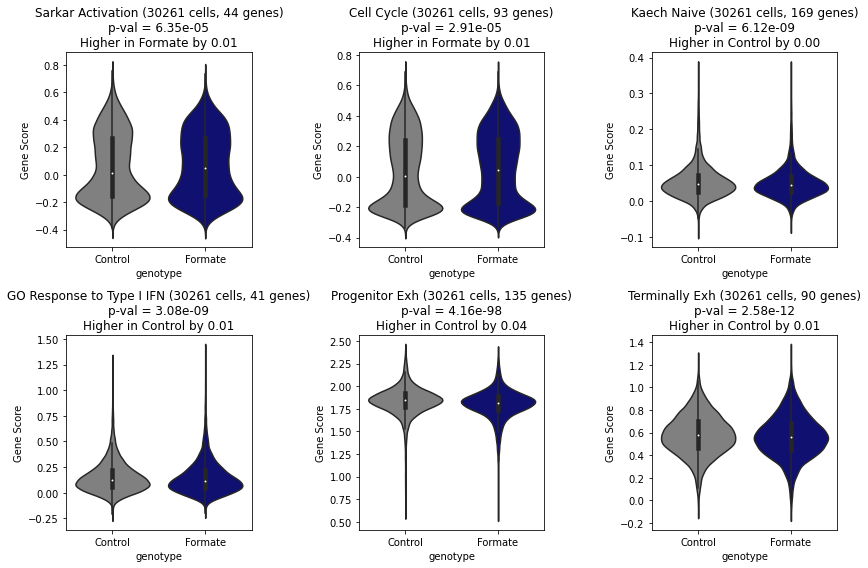

In [131]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'genotype', figsize = (12,8),
                     order = ['Control', 'Formate'], palette = ['gray', 'navy'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_CoreSigs_byGenotype.pdf')

### Hallmarks Sigs

In [132]:
gene_lists = [Apoptosis, DNArepair, G2M, Glycolysis, Hypoxia, Inflamm, IFNalpha, IFNgamma, Spindle,
              Oxidative, PI3K, ROS, TGFbeta]
gene_names = ['Apoptosis', 'DNA Repair', 'G2M Checkpoint', 'Glycolysis', 'Hypoxia', 'Inflammatory Response',
              'IFN Alpha', 'IFN Gamma', 'Mitotic Spindle', 'Oxidative Phosphorylation', 'PI3K/AKT/mTOR',
              'Reactive Oxygen Species', 'TGF Beta']

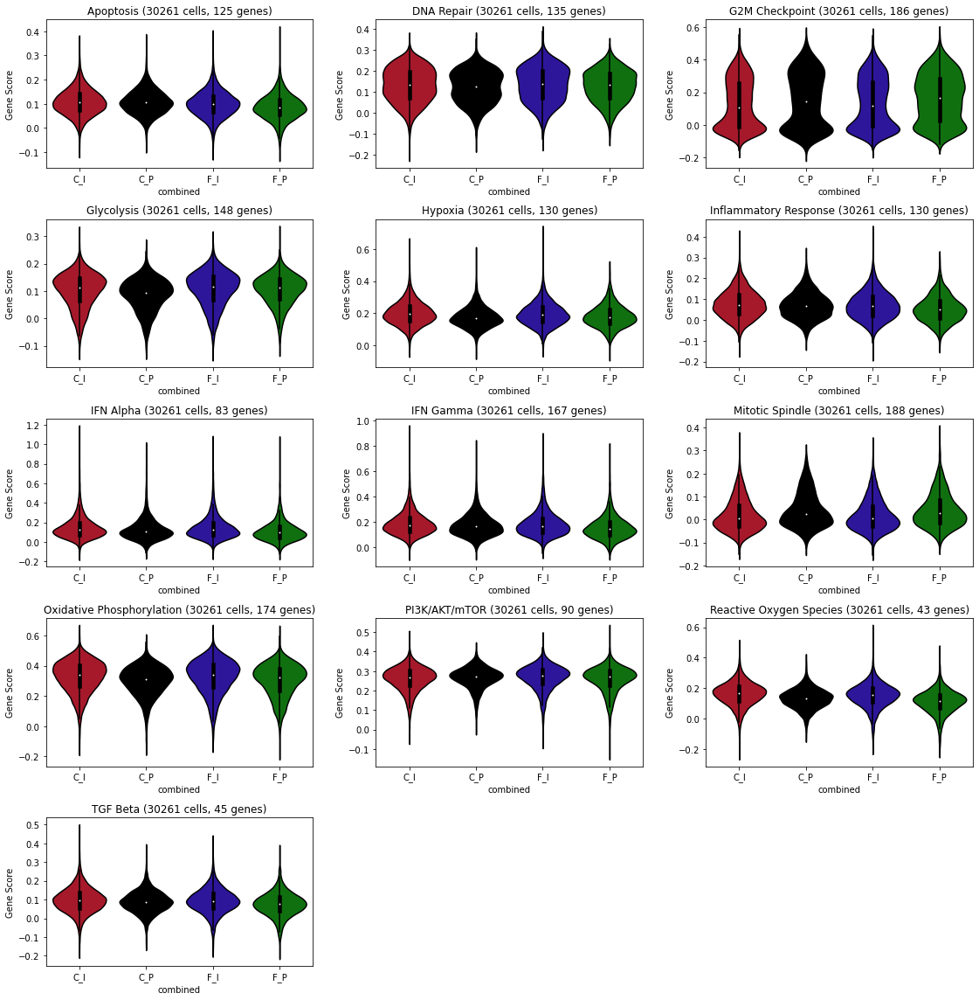

In [134]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'combined', figsize = (16,16),
                     order = ['C_I', 'C_P', 'F_I', 'F_P'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_HallmarkSigs_byCombined.pdf')

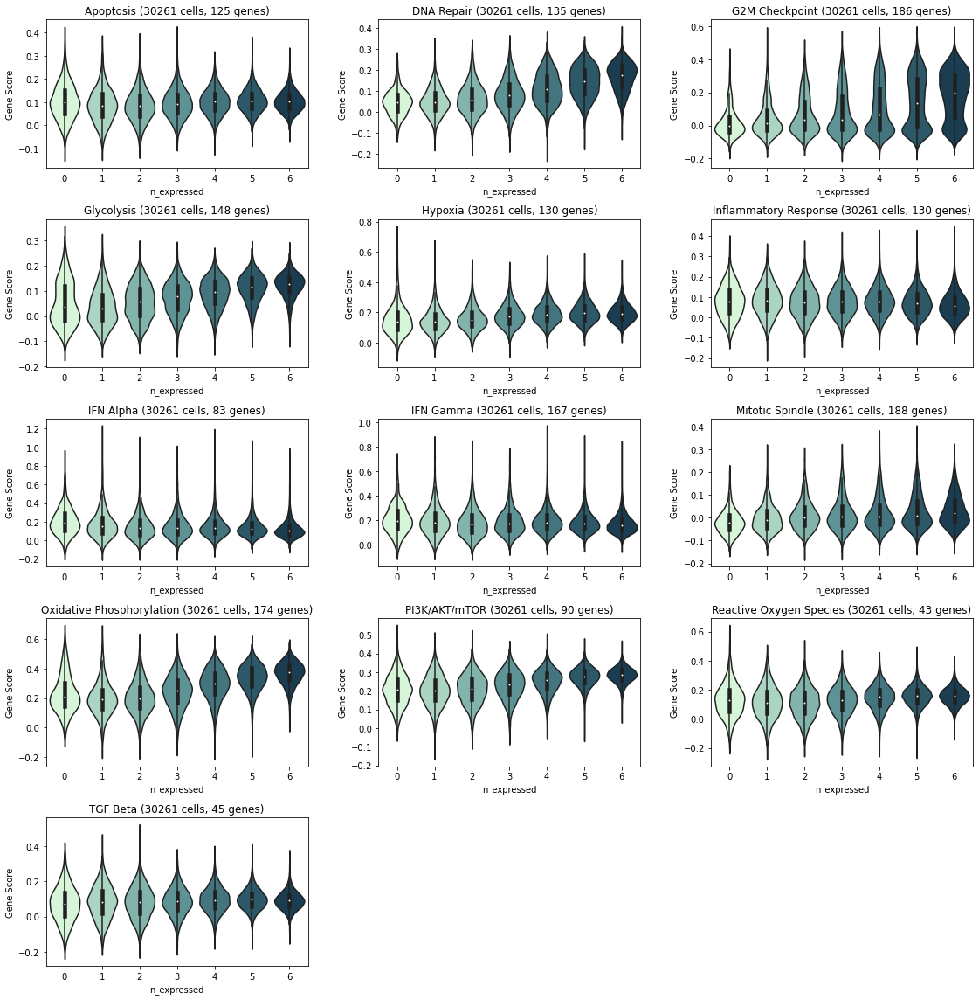

In [137]:
IRs = ['Pdcd1','Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4']
Adata.obs['n_expressed'] = np.count_nonzero(Adata[:, IRs].X, axis=1)
Adata.obs['n_expressed'] = Adata.obs['n_expressed'].astype(int)

from palettable.cartocolors.sequential import DarkMint_7

MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'n_expressed', figsize = (16,16),
                     palette = DarkMint_7.mpl_colors, order = ['0', '1', '2', '3', '4', '5', '6'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_HallmarkSigs_byIRs.pdf')

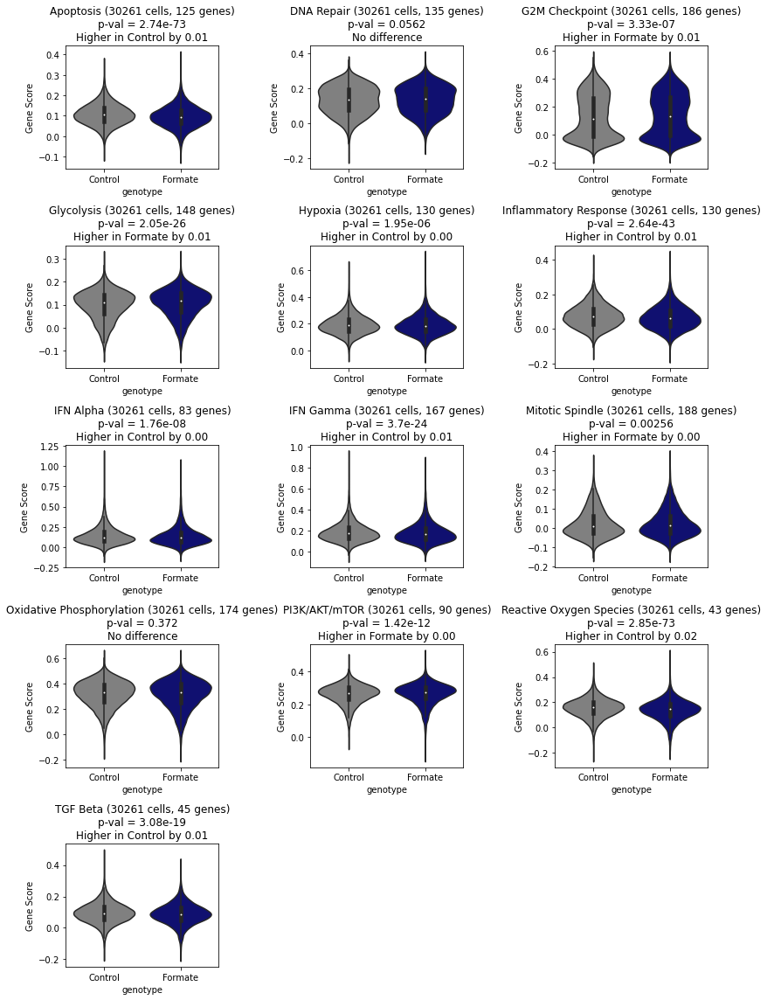

In [138]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'genotype', figsize = (12,16),
                     order = ['Control', 'Formate'], palette = ['gray', 'navy'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_HallmarkSigs_byGenotype.pdf')

### Metabolism Sigs

In [139]:
gene_lists = [SerineBios, SerineUpt, Folate, Purine, Methio, Transful]
gene_names = ['Serine Biosynthesis', 'Serine Uptake', 'Folate Cycle', 'Purine Synthesis',
              'Methionine Cycle', 'Transfuluration']

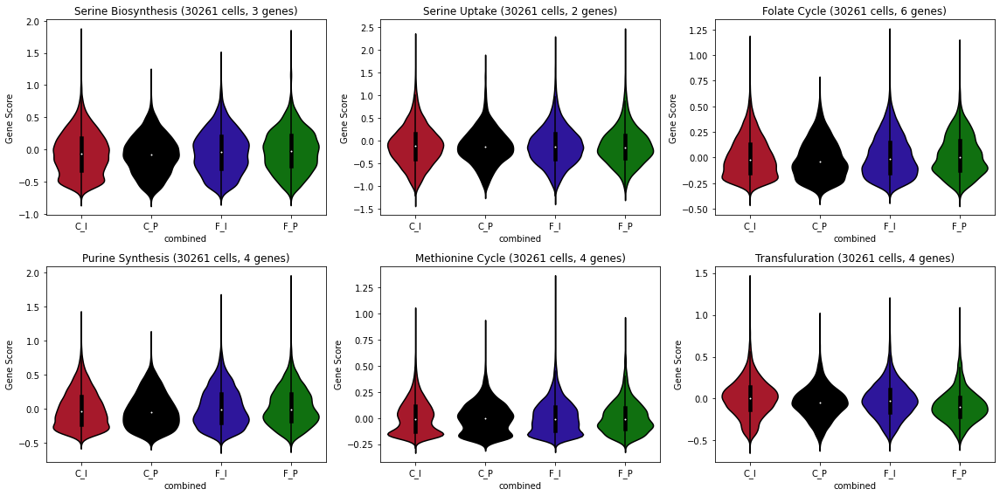

In [145]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'combined', figsize = (16,8),
                     order = ['C_I', 'C_P', 'F_I', 'F_P'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_MetabolismSigs_byCombined.pdf')

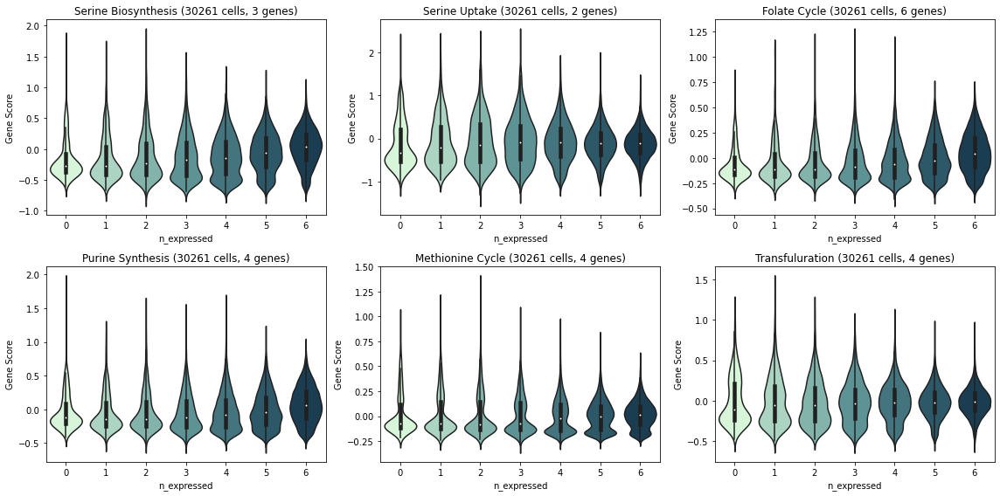

In [143]:
IRs = ['Pdcd1','Havcr2', 'Tigit', 'Lag3', 'Cd160', 'Ctla4']
Adata.obs['n_expressed'] = np.count_nonzero(Adata[:, IRs].X, axis=1)
Adata.obs['n_expressed'] = Adata.obs['n_expressed'].astype(int)

from palettable.cartocolors.sequential import DarkMint_7

MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'n_expressed', figsize = (16,8),
                     palette = DarkMint_7.mpl_colors, order = ['0', '1', '2', '3', '4', '5', '6'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_MetabolismSigs_byIRs.pdf')

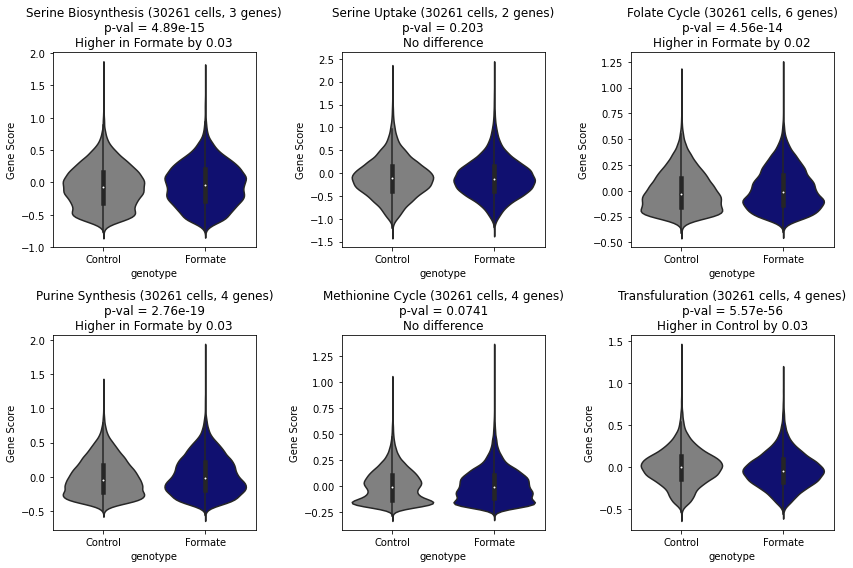

In [144]:
MakeViolinSignatures(Adata, gene_lists, gene_names, groupby = 'genotype', figsize = (12,8),
                     order = ['Control', 'Formate'], palette = ['gray', 'navy'],
                     save_name = 'results/Plots/GeneSignaturePlots/Violins_MetabolismSigs_byGenotype.pdf')

# Statistical Tests

In [344]:
with pd.ExcelWriter('/Users/oshahid/Desktop/test.xlsx') as writer:

    for g in gene_names:
        print(g)
        df = MultiWayStats(Adata.obs, groupby = 'combined', col = g)
        print(df)
        df.to_excel(writer, sheet_name = g)
        print('\n')

Sarkar Activation
There are 4 groups: CI, FI, CP, FP
                   pval          qval  Sig Higher In
CI vs. CP  9.099087e-02  1.091890e-01   No        --
CI vs. FI  7.633686e-03  1.145053e-02  Yes        FI
CI vs. FP  2.567652e-15  1.540591e-14  Yes        FP
CP vs. FP  8.057301e-05  1.611460e-04  Yes        FP
FI vs. CP  4.583580e-01  4.583580e-01   No        --
FI vs. FP  5.909881e-09  1.772964e-08  Yes        FP


Cell Cycle
There are 4 groups: CI, FI, CP, FP
                   pval          qval  Sig Higher In
CI vs. CP  3.759952e-06  7.519903e-06  Yes        CP
CI vs. FI  7.927869e-02  7.927869e-02   No        --
CI vs. FP  2.801175e-27  1.680705e-26  Yes        FP
CP vs. FP  5.233437e-04  6.280125e-04  Yes        FP
FI vs. CP  9.246711e-05  1.387007e-04  Yes        CP
FI vs. FP  2.524510e-20  7.573530e-20  Yes        FP


Kaech Naive
There are 4 groups: CI, FI, CP, FP
                   pval          qval  Sig Higher In
CI vs. CP  4.587948e-03  5.929130e-03  Yes        CI
CI